In [3]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

In [5]:
# ##############################################################################
# ######################################### Plot the results ###################
# ##############################################################################
plt.rcParams['font.size'] = 12
plt.rc('font', weight='bold')
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['axes.titlesize'] = 17
plt.rcParams['axes.titleweight']='bold'
plt.rcParams['xtick.labelsize'] =13
plt.rcParams['ytick.labelsize'] =13
plt.rcParams['lines.linewidth']=2.0
plt.rcParams['figure.figsize'] = 4,3  #width,height
plt.rcParams['lines.markersize']=15
plt.rcParams['axes.linewidth'] =3

 

plt.rcParams['xtick.major.size']=5
plt.rcParams['xtick.direction']= 'out'
plt.rcParams['xtick.major.width']=2

 

plt.rcParams['ytick.major.size']=5
plt.rcParams['ytick.direction']= 'in'
plt.rcParams['ytick.major.width']=1.0

 

plt.rcParams['xtick.major.pad']='5'
plt.rcParams['ytick.major.pad']='5'

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# --- SETTINGS ---
xbins = 256
window = 5
poly   = 2

# --- OUTCAR files ---
outcar_files = [
    ('OUTCAR_ALGB_100K', '100K'),
    ('OUTCAR_ALGB_300K', '300K'),
    ('OUTCAR_ALGB_400K', '400K'),
    ('OUTCAR_ALGB_500K', '500K'),
    ('OUTCAR_ALGB_600K', '600K'),
    ('OUTCAR_ALGB_700K', '700K'),
    ('OUTCAR_ALGB_800K', '800K'),
]

# --- Auto detect isteps ---
def count_isteps(filename):
    nsteps = 0
    with open(filename, 'r') as fin:
        for line in fin:
            if line.strip().startswith('E-fermi'):
                nsteps += 1
    return nsteps

# Detect from first OUTCAR (100K):
isteps = count_isteps('OUTCAR_ALGB_100K')
print(f"\nDetected total steps in OUTCAR_ALGB_100K: isteps = {isteps}\n")
isteps = count_isteps('OUTCAR_ALGB_300K')
print(f"\nDetected total steps in OUTCAR_ALGB_300K: isteps = {isteps}\n")

# --- Process OUTCAR to .dat ---
def process_outcar(filename, output_filename):
    str_marker = 'E-fermi'
    xpos = [0.0] * xbins
    xdos = [0.0] * xbins
    def array2dist(ncount, val, xmin, xmax, xbins, xpos, xdos):
        xsudd = (xmax - xmin) / (xbins - 1)
        for i in range(1, ncount + 1):
            npos = int((val[i] - xmin) / xsudd) + 1
            if 0 <= npos - 1 < xbins:
                xdos[npos - 1] += 1.0
        farea = sum((xmax - xmin) / (xbins - 1) * d for d in xdos)
        for isudd in range(1, xbins + 1):
            xpos[isudd - 1] = xmin + xsudd * (isudd - 1)
            xdos[isudd - 1] = 1000.0 * xdos[isudd - 1] / farea if farea != 0 else 0.0

    istep = 0
    with open(output_filename, 'w') as fout, open(filename, 'r') as fin:
        nbands = None
        while True:
            line = fin.readline()
            if not line:
                break
            parts = line.strip().split()
            if 'NBANDS=' in line:
                nbands = int(line.split('NBANDS=')[1].split()[0])
                energy = [0.0] * (nbands + 1)
            if len(parts) > 0 and parts[0] == 'E-fermi' and nbands is not None:
                istep += 1
                efermi = float(parts[2])
                for _ in range(8):
                    fin.readline()
                read_bands = 0
                while read_bands < nbands:
                    line = fin.readline()
                    if not line:
                        break
                    line = line.strip().split()
                    if len(line) < 2:
                        continue
                    try:
                        iband = int(line[0])
                        energy[iband - 1] = float(line[1])
                        read_bands += 1
                    except ValueError:
                        continue
                xdos = [0.0] * xbins
                array2dist(nbands, energy, energy[0], energy[nbands - 1], xbins, xpos, xdos)
                for i in range(xbins):
                    fout.write(f"{istep} {istep * 0.0015:.3f} {xpos[i] - efermi:.6f} {xdos[i]:.6f}\n")

# --- Run processing for all OUTCARs ---
dat_files = []
for outcar_name, temp_label in outcar_files:
    dat_name = f"dos-time_python_{temp_label}.dat"
    print(f"\nProcessing {outcar_name} → {dat_name} ...")
    process_outcar(outcar_name, dat_name)
    dat_files.append( (dat_name, temp_label) )
print("\n=== All OUTCAR files processed ===\n")

# --- LOAD data ---
all_data = []
energy_min = np.inf
energy_max = -np.inf
all_steps_list = None  # Will store available step numbers

for filename, label in dat_files:
    print(f"Loading {filename} ...")
    dat = np.loadtxt(filename)
    all_data.append( (dat, label) )
    e_min = dat[:,2].min()
    e_max = dat[:,2].max()
    if e_min < energy_min:
        energy_min = e_min
    if e_max > energy_max:
        energy_max = e_max

    # First file: get available steps
    if all_steps_list is None:
        all_steps_list = np.unique(dat[:,0]).astype(int)
        print(f"Found steps: {len(all_steps_list)} available in .dat")

# --- Auto select N steps across run ---
n_steps_to_plot = 5  # change this to 3,5,7 etc
step_indices = np.linspace(0, len(all_steps_list)-1, n_steps_to_plot, dtype=int)
steps_to_plot = all_steps_list[step_indices].tolist()

print(f"\nSteps selected to plot: {steps_to_plot}\n")

# --- Clamp energy range ---
energy_min = max(energy_min, -5)
energy_max = min(energy_max, +5)
print(f"Clamped plot range: [{energy_min:.3f}, {energy_max:.3f}] eV\n")

# --- COLORS & linestyles ---
colors = ['red', 'blue', 'green', 'purple', 'black', 'orange', 'brown']
linestyles = ['-', '--', ':', '-.', '-', '--', ':']

# --- MAKE subplots ---
fig_height = min(2.8 * len(steps_to_plot), 40)  # cap height
fig, axs = plt.subplots(len(steps_to_plot), 1, figsize=(9, fig_height), dpi=300)
if len(steps_to_plot) == 1:
    axs = [axs]

# --- Plot ---
for ax_idx, step_number in enumerate(steps_to_plot):
    step_indices = np.where(all_data[0][0][:,0] == step_number)[0]
    time_ps = (step_number - 1) * 0.0015
    for i, (dat, label) in enumerate(all_data):
        indices = np.where(dat[:,0] == step_number)[0]
        if len(indices) == 0:
            continue  # skip if step not found!
        energy = dat[indices, 2]
        dos    = dat[indices, 3]
        dos_r  = savgol_filter(dos, window_length=min(window,len(dos)//2*2-1), polyorder=poly)
        axs[ax_idx].plot(energy, dos_r, color=colors[i], linestyle=linestyles[i], linewidth=1.5, label=label)
    axs[ax_idx].set_xlim(energy_min, energy_max)
    # axs[ax_idx].set_ylim(0, 13)
    axs[ax_idx].set_xlabel("Energy - E$_F$ [eV]", fontsize=12)
    axs[ax_idx].set_ylabel("EDoS", fontsize=12)
    axs[ax_idx].set_title(f"Time = {time_ps:.3f} ps", fontsize=13)
    axs[ax_idx].legend(fontsize=9, loc='best')
    axs[ax_idx].grid(alpha=0.3)

plt.tight_layout()
plt.savefig("Compare_Temp_EDoS_selected_times.png", bbox_inches='tight', dpi=300)
plt.show()

print("\n=== Static plot saved as Compare_Temp_EDoS_selected_times.png ===\n")


In [152]:
dat_500K = np.loadtxt('dos-time_python_500K.dat')
steps_500K = np.unique(dat_500K[:,0]).astype(int)
print("Available steps for 500K:", steps_500K[-10:])


Available steps for 500K: [4991 4992 4993 4994 4995 4996 4997 4998 4999 5000]


Detected total steps in OUTCAR_ALGB_100K: isteps = 5000
Processing OUTCAR_ALGB_100K → dos-time_python_100K.dat ...
Detected total steps in OUTCAR_ALGB_200K: isteps = 5000
Processing OUTCAR_ALGB_200K → dos-time_python_200K.dat ...
Detected total steps in OUTCAR_ALGB_300K: isteps = 5000
Processing OUTCAR_ALGB_300K → dos-time_python_300K.dat ...
Detected total steps in OUTCAR_ALGB_400K: isteps = 5000
Processing OUTCAR_ALGB_400K → dos-time_python_400K.dat ...
Detected total steps in OUTCAR_ALGB_500K: isteps = 5000
Processing OUTCAR_ALGB_500K → dos-time_python_500K.dat ...
Detected total steps in OUTCAR_ALGB_600K: isteps = 5000
Processing OUTCAR_ALGB_600K → dos-time_python_600K.dat ...
Detected total steps in OUTCAR_ALGB_700K: isteps = 5000
Processing OUTCAR_ALGB_700K → dos-time_python_700K.dat ...
Detected total steps in OUTCAR_ALGB_800K: isteps = 5000
Processing OUTCAR_ALGB_800K → dos-time_python_800K.dat ...
Detected total steps in OUTCAR_ALGB_900K: isteps = 5000
Processing OUTCAR_ALGB_9

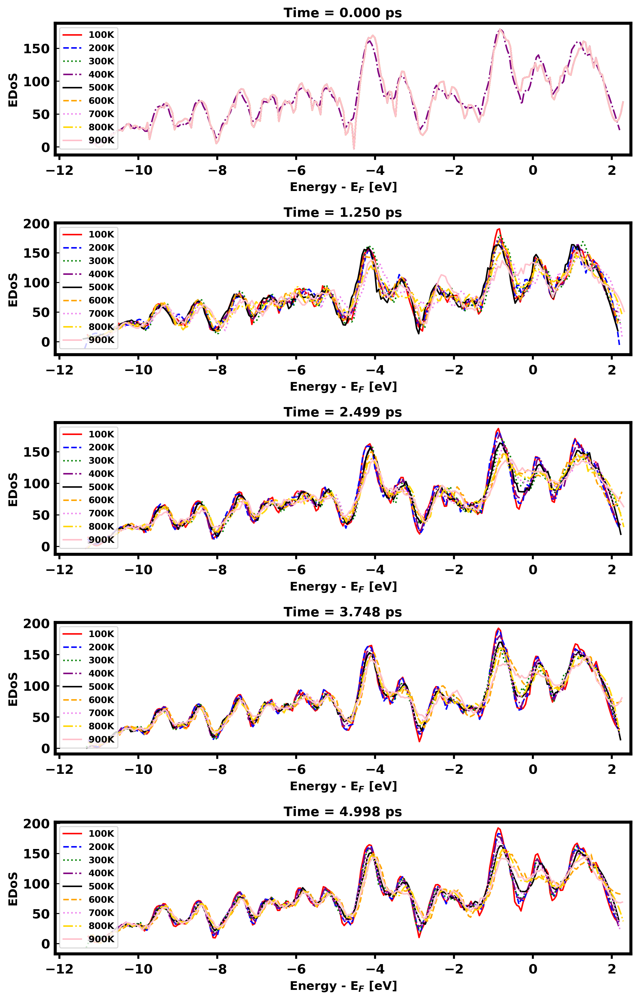


=== Static plot saved as Compare_Temp_EDoS_selected_times.png ===



In [11]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# --- SETTINGS ---
xbins = 256
window = 21
poly   = 3

# --- OUTCAR files ---
outcar_files = [
    ('OUTCAR_ALGB_100K', '100K'),
    ('OUTCAR_ALGB_200K', '200K'),
    ('OUTCAR_ALGB_300K', '300K'),
    ('OUTCAR_ALGB_400K', '400K'),
    ('OUTCAR_ALGB_500K', '500K'),
    ('OUTCAR_ALGB_600K', '600K'),
    # ('OUTCAR_ALGB_700K', '700K'),
    ('OUTCAR_ALGB_700K', '700K'), #rerun
    ('OUTCAR_ALGB_800K', '800K'),
    ('OUTCAR_ALGB_900K', '900K'),
]

# --- Auto detect isteps ---
def count_isteps(filename):
    nsteps = 0
    with open(filename, 'r') as fin:
        for line in fin:
            if line.strip().startswith('E-fermi'):
                nsteps += 1
    return nsteps

# --- Process OUTCAR to .dat ---
def process_outcar(filename, output_filename):
    str_marker = 'E-fermi'
    xpos = [0.0] * xbins
    xdos = [0.0] * xbins
    def array2dist(ncount, val, xmin, xmax, xbins, xpos, xdos):
        xsudd = (xmax - xmin) / (xbins - 1)
        for i in range(1, ncount + 1):
            npos = int((val[i] - xmin) / xsudd) + 1
            if 0 <= npos - 1 < xbins:
                xdos[npos - 1] += 1.0
        farea = sum((xmax - xmin) / (xbins - 1) * d for d in xdos)
        for isudd in range(1, xbins + 1):
            xpos[isudd - 1] = xmin + xsudd * (isudd - 1)
            xdos[isudd - 1] = 1000.0 * xdos[isudd - 1] / farea if farea != 0 else 0.0

    istep = 0
    with open(output_filename, 'w') as fout, open(filename, 'r') as fin:
        nbands = None
        while True:
            line = fin.readline()
            if not line:
                break
            parts = line.strip().split()
            if 'NBANDS=' in line:
                nbands = int(line.split('NBANDS=')[1].split()[0])
                energy = [0.0] * (nbands + 1)
            if len(parts) > 0 and parts[0] == 'E-fermi' and nbands is not None:
                istep += 1
                efermi = float(parts[2])
                for _ in range(8):
                    fin.readline()
                read_bands = 0
                while read_bands < nbands:
                    line = fin.readline()
                    if not line:
                        break
                    line = line.strip().split()
                    if len(line) < 2:
                        continue
                    try:
                        iband = int(line[0])
                        energy[iband - 1] = float(line[1])
                        read_bands += 1
                    except ValueError:
                        continue
                xdos = [0.0] * xbins
                array2dist(nbands, energy, energy[0], energy[nbands - 1], xbins, xpos, xdos)
                for i in range(xbins):
                    fout.write(f"{istep} {istep * 0.0015:.3f} {xpos[i] - efermi:.6f} {xdos[i]:.6f}\n")

# --- Process all OUTCARs ---
dat_files = []
for outcar_name, temp_label in outcar_files:
    isteps = count_isteps(outcar_name)
    print(f"Detected total steps in {outcar_name}: isteps = {isteps}")
    dat_name = f"dos-time_python_{temp_label}.dat"
    print(f"Processing {outcar_name} → {dat_name} ...")
    process_outcar(outcar_name, dat_name)
    dat_files.append( (dat_name, temp_label) )
print("\n=== All OUTCAR files processed ===\n")

# --- Load .dat files ---
all_data = []
all_steps_list = []
energy_min = np.inf
energy_max = -np.inf

for filename, label in dat_files:
    print(f"Loading {filename} ...")
    dat = np.loadtxt(filename)
    all_data.append( (dat, label) )
    e_min = dat[:,2].min()
    e_max = dat[:,2].max()
    if e_min < energy_min:
        energy_min = e_min
    if e_max > energy_max:
        energy_max = e_max

    # Store available steps:
    steps = np.unique(dat[:,0]).astype(int)
    all_steps_list.append(steps)
    print(f"Available steps for {label}: max = {steps[-1]}")

# --- Limit time window ---
time_cutoff_ps = 5.0           # Set your MD cutoff time here
step_cutoff = int(time_cutoff_ps / 0.0015)  # Convert to step index

# --- Determine max common step under time constraint ---
max_common_step = min([min(steps[-1], step_cutoff) for steps in all_steps_list])
print(f"\nMax common step across all temperatures (capped at {time_cutoff_ps} ps) = {max_common_step}")

# --- Select N steps to plot within allowed time range ---
n_steps_to_plot = 5
steps_to_plot = np.linspace(1, max_common_step, n_steps_to_plot, dtype=int).tolist()
print(f"Steps selected to plot (≤ {time_cutoff_ps} ps): {steps_to_plot}\n")


# --- FULL energy range ---
print(f"Full energy range: [{energy_min:.3f}, {energy_max:.3f}] eV\n")

# --- COLORS & linestyles ---
colors = ['red', 'blue', 'green', 'purple', 'black', 'orange','violet','gold','pink']
# linestyles = ['-', '--', ':', '-.', '-', '--', ':']
linestyles = ['-', '--', ':', '-.', '-', '--', ':', '-.', '-']  # now 10 entries!


# --- Make subplots ---
fig_height = min(2.8 * len(steps_to_plot), 40)
fig, axs = plt.subplots(len(steps_to_plot), 1, figsize=(9, fig_height), dpi=300)
if len(steps_to_plot) == 1:
    axs = [axs]

# --- Plot ---
for ax_idx, step_number in enumerate(steps_to_plot):
    time_ps = (step_number - 1) * 0.0015
    for i, (dat, label) in enumerate(all_data):
        indices = np.where(dat[:,0] == step_number)[0]
        if len(indices) == 0:
            print(f"WARNING: step {step_number} missing for {label}")
            continue
        energy = dat[indices, 2]
        dos    = dat[indices, 3]
        window_used = min(window, len(dos)//2*2-1)
        dos_r  = savgol_filter(dos, window_length=window_used, polyorder=poly)
        axs[ax_idx].plot(energy, dos_r, color=colors[i], linestyle=linestyles[i], linewidth=1.5, label=label)
    axs[ax_idx].set_xlim(energy_min, energy_max)  # FULL range!
    #axs[ax_idx].set_ylim(0, 13)
    axs[ax_idx].set_xlabel("Energy - E$_F$ [eV]", fontsize=12)
    axs[ax_idx].set_ylabel("EDoS", fontsize=12)
    axs[ax_idx].set_title(f"Time = {time_ps:.3f} ps", fontsize=13)
    axs[ax_idx].legend(fontsize=9, loc='best')
    # axs[ax_idx].grid(alpha=0.3)

plt.tight_layout()
plt.savefig("Compare_Temp_EDoS_selected_times.png", bbox_inches='tight', dpi=300)
plt.show()

print("\n=== Static plot saved as Compare_Temp_EDoS_selected_times.png ===\n")


100K:  ⟨N²⟩ = 5528.434512  ± 1302.723910
200K:  ⟨N²⟩ = 5293.509158  ± 1469.739340
300K:  ⟨N²⟩ = 4695.869742  ± 1458.030531
400K:  ⟨N²⟩ = 4159.096422  ± 603.260402
500K:  ⟨N²⟩ = 3852.194613  ± 1158.930483
600K:  ⟨N²⟩ = 3353.228202  ± 1118.098984
700K:  ⟨N²⟩ = 3510.984044  ± 1054.022963
800K:  ⟨N²⟩ = 3224.803637  ± 1050.304562
900K:  ⟨N²⟩ = 3268.100880  ± 1120.167334


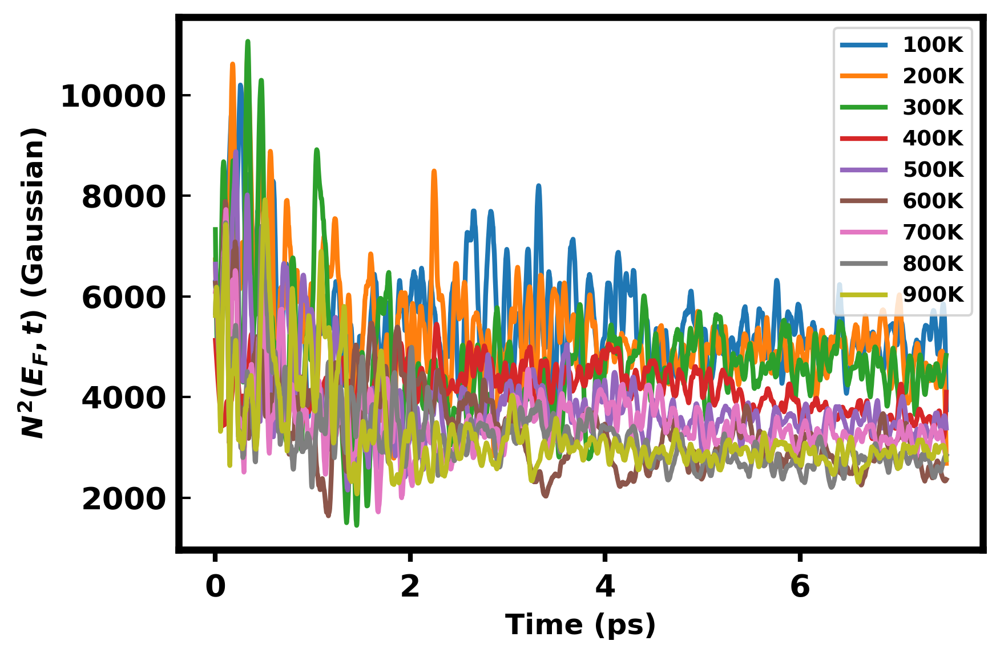


=== Saved N2_vs_time_Gaussian_smoothed.png ===


In [106]:
# --- Settings ---
sigma = 0.3  # eV
window_length = 71   # Smoothing window (odd number)
polyorder = 3

T_values = []
N2_avg_values = []
N2_std_values = []

plt.figure(figsize=(6,4), dpi=300)

for dat, label in all_data:
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []
    times = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)
        times.append(step * 0.0015)

    # Smooth N²(t)
    n2_smooth = savgol_filter(n2_list, window_length=min(window_length, len(n2_list)//2*2-1), polyorder=polyorder)

    # Plot:
    plt.plot(times, n2_smooth, label=f'{label}')

    # Final avg/std on raw data:
    avg_n2 = np.mean(n2_list)
    std_n2 = np.std(n2_list)

    T_values.append(T_val)
    N2_avg_values.append(avg_n2)
    N2_std_values.append(std_n2)

    print(f"{label}:  ⟨N²⟩ = {avg_n2:.6f}  ± {std_n2:.6f}")

# Final trend plot:
plt.xlabel("Time (ps)", fontsize=12)
plt.ylabel(r"$N^2(E_F, t)$ (Gaussian)", fontsize=12)
plt.legend(fontsize=9)
# plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig("N2_vs_time_Gaussian_smoothed.png", dpi=300)
plt.show()

print("\n=== Saved N2_vs_time_Gaussian_smoothed.png ===")



100K:  ⟨N²⟩ = 5528.434512  ± 1302.723910
200K:  ⟨N²⟩ = 5293.509158  ± 1469.739340
300K:  ⟨N²⟩ = 4695.869742  ± 1458.030531
400K:  ⟨N²⟩ = 4159.096422  ± 603.260402
500K:  ⟨N²⟩ = 3852.194613  ± 1158.930483
600K:  ⟨N²⟩ = 3353.228202  ± 1118.098984
700K:  ⟨N²⟩ = 3510.984044  ± 1054.022963
800K:  ⟨N²⟩ = 3224.803637  ± 1050.304562
900K:  ⟨N²⟩ = 3268.100880  ± 1120.167334


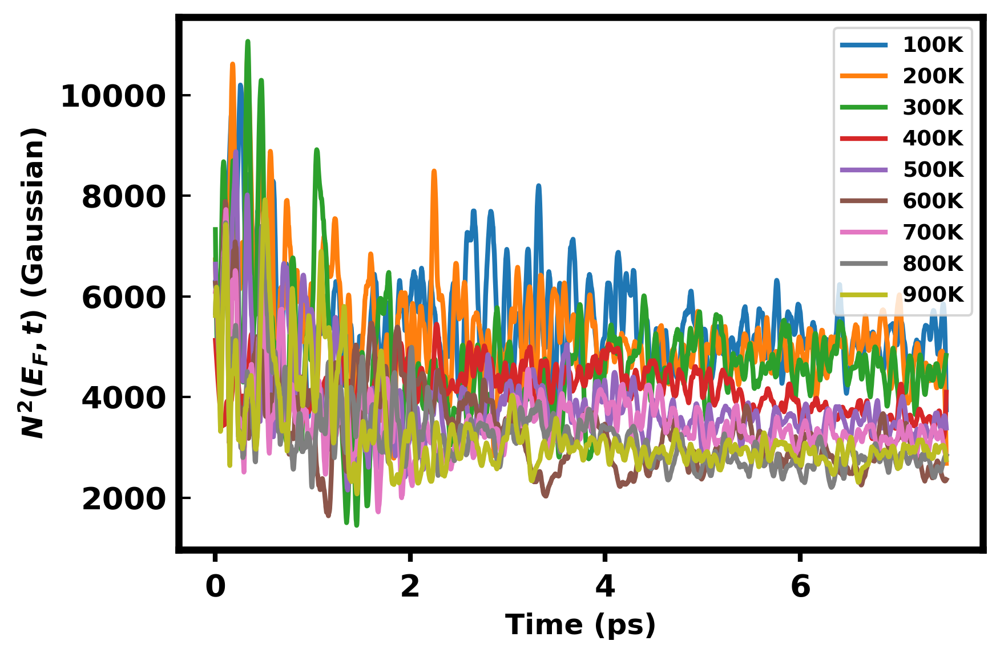


=== Saved N2_vs_time_Gaussian_smoothed_FIXED.png ===


In [123]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# --- Settings ---
sigma = 0.1           # Gaussian width in eV
window_length = 71     # Smoothing window (odd number)
polyorder = 3
dt_ps = 0.0015         # Timestep in ps

T_values = []
N2_avg_values = []
N2_std_values = []

plt.figure(figsize=(6, 4), dpi=300)

for dat, label in all_data:
    T_label = label.replace("K", "")
    T_val = float(T_label)

    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []
    times = []

    # Align time to start from 0
    step0 = all_steps[0]

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted**2, energy)

        n2_list.append(n2)
        times.append((step - step0) * dt_ps)  # Corrected time axis

    # Smooth N²(t)
    window_safe = min(window_length, len(n2_list) // 2 * 2 - 1)
    n2_smooth = savgol_filter(n2_list, window_length=window_safe, polyorder=polyorder)

    # Plot smoothed curve
    plt.plot(times, n2_smooth, label=f'{label}')

    # Final avg/std on raw data:
    avg_n2 = np.mean(n2_list)
    std_n2 = np.std(n2_list)
    T_values.append(T_val)
    N2_avg_values.append(avg_n2)
    N2_std_values.append(std_n2)

    print(f"{label}:  ⟨N²⟩ = {avg_n2:.6f}  ± {std_n2:.6f}")

# Final plot settings
plt.xlabel("Time (ps)", fontsize=12)
plt.ylabel(r"$N^2(E_F, t)$ (Gaussian)", fontsize=12)
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig("N2_vs_time_Gaussian_smoothed_FIXED.png", dpi=300)
plt.show()

print("\n=== Saved N2_vs_time_Gaussian_smoothed_FIXED.png ===")


In [125]:
# Limit to 5ps

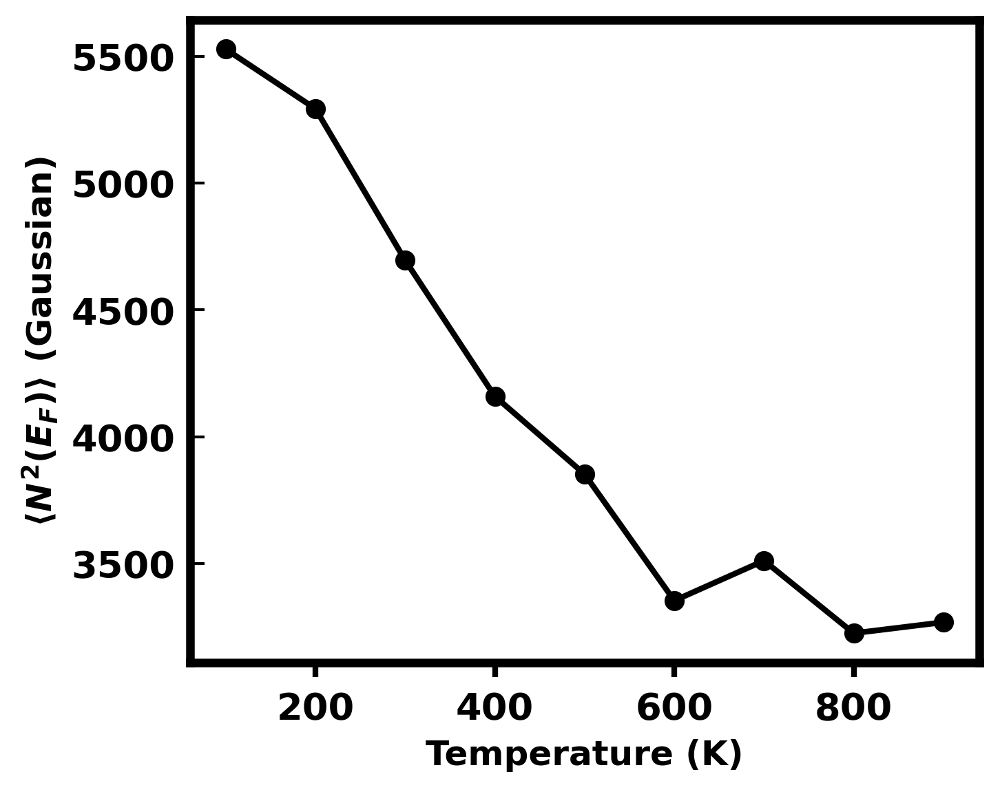


=== Saved N2_vs_T.png ===


In [129]:
# --- ⟨N²⟩ vs T ---
plt.figure(figsize=(5,4), dpi=300)

# plt.errorbar(T_values, N2_avg_values, yerr=N2_std_values, fmt='o-', capsize=4, markersize=6, color='black')
plt.errorbar(T_values, N2_avg_values, fmt='o-', capsize=4, markersize=6, color='black')


plt.xlabel("Temperature (K)", fontsize=12)
plt.ylabel(r"$\langle N^2(E_F) \rangle$ (Gaussian)", fontsize=12)
# plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig("N2_vs_T.png", dpi=300)
plt.show()

print("\n=== Saved N2_vs_T.png ===")


# Running Average: Time evolution of the squared density of states at the Fermi level (N²) using a Gaussian weighting

100K: Plateau ⟨N²⟩ = 11393.618610
200K: Plateau ⟨N²⟩ = 10532.958729
300K: Plateau ⟨N²⟩ = 9822.709813
400K: Plateau ⟨N²⟩ = 8825.535194
500K: Plateau ⟨N²⟩ = 8720.725599
600K: Plateau ⟨N²⟩ = 8448.415102
700K: Plateau ⟨N²⟩ = 8353.805703
800K: Plateau ⟨N²⟩ = 8126.228657
900K: Plateau ⟨N²⟩ = 8492.288158


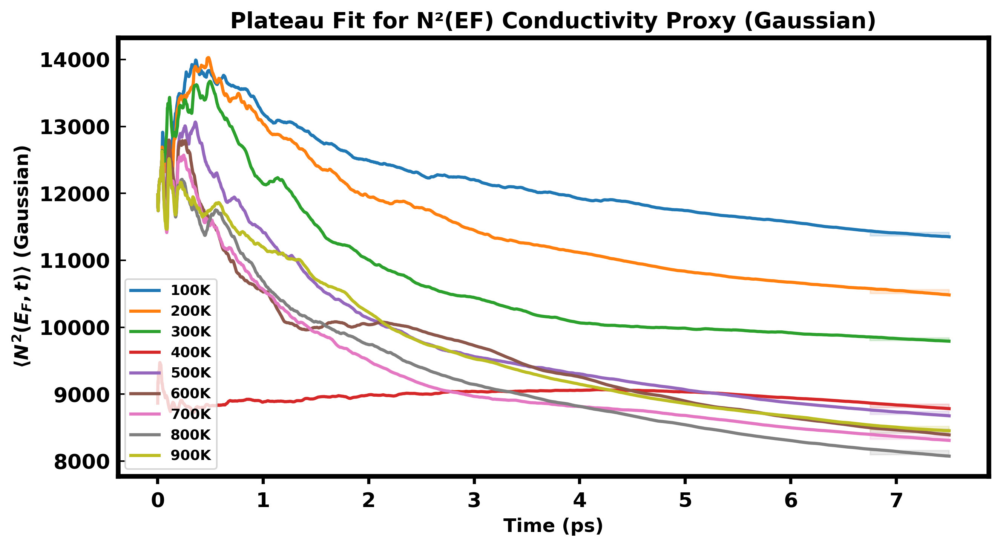


=== Saved N2_vs_time_Gaussian_plateau.png ===


In [144]:
# --- Settings ---
sigma = 0.3  # eV
window_length = 71   # Smoothing window (odd number)
polyorder = 3

T_values = []
N2_avg_values = []
N2_std_values = []

plt.figure(figsize=(9,5), dpi=300)

for dat, label in all_data:
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int) #I am extracting unique MD timesteps
    n2_list = []
    times = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)
        times.append(step * 0.0015)

    # Smooth N²(t)
    n2_smooth = savgol_filter(n2_list, window_length=min(window_length, len(n2_list)//2*2-1), polyorder=polyorder)

    # Cumulative avg N²(t)
    n2_cumsum = np.cumsum(n2_list) / np.arange(1, len(n2_list)+1)

    # Plot smoothed N²(t)
    plt.plot(times, n2_cumsum, label=f'{label}', lw=2)

    # Plateau region (last 10%)
    plateau_start = int(len(n2_cumsum) * 0.90)
    plateau_vals = n2_cumsum[plateau_start:]
    plateau_times = np.array(times)[plateau_start:]

    plateau_mean = np.mean(plateau_vals)
    plateau_std  = np.std(plateau_vals)

    # # Plot plateau line:
    # plt.axhline(plateau_mean, linestyle='--', color=plt.gca().lines[-1].get_color(),
    #             label=f'{label} plateau ≈ {plateau_mean:.2f} ± {plateau_std:.2f}')

    # Optional: fill plateau region:
    plt.fill_between(plateau_times, plateau_mean - plateau_std, plateau_mean + plateau_std,
                     color=plt.gca().lines[-1].get_color(), alpha=0.15)

    # Store values for N² vs T plot:
    T_values.append(T_val)
    N2_avg_values.append(plateau_mean)
    N2_std_values.append(plateau_std)

    # Print plateau result:
    # print(f"{label}: Plateau ⟨N²⟩ = {plateau_mean:.6f}  ± {plateau_std:.6f}")
    print(f"{label}: Plateau ⟨N²⟩ = {plateau_mean:.6f}")

# Final trend plot:
plt.xlabel("Time (ps)", fontsize=12)
plt.ylabel(r"$\langle N^2(E_F, t) \rangle$ (Gaussian)", fontsize=12)
plt.title("Plateau Fit for N²(EF) Conductivity Proxy (Gaussian)", fontsize=14)
plt.legend(fontsize=9)
# plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig("N2_vs_time_Gaussian_plateau.png", dpi=300)
plt.show()

print("\n=== Saved N2_vs_time_Gaussian_plateau.png ===")



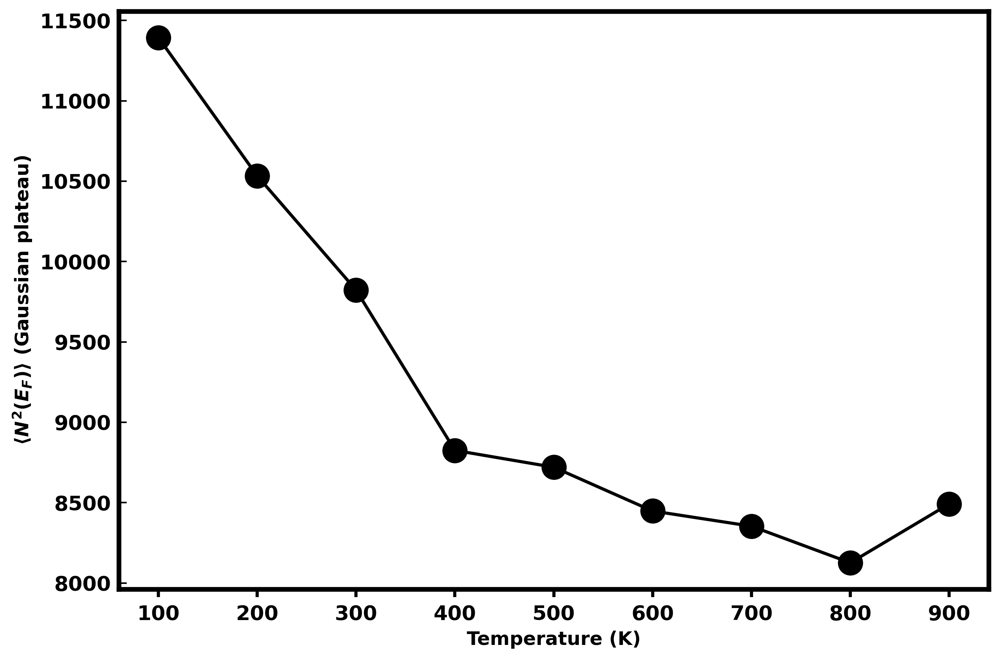


=== Saved N2_vs_T_plateau.png ===


In [148]:
# --- Now: ⟨N²⟩ vs T ---
plt.figure(figsize=(9,6), dpi=300)

# plt.errorbar(T_values, N2_avg_values, yerr=N2_std_values, fmt='o-', capsize=4, markersize=6, color='black')
plt.errorbar(T_values, N2_avg_values, fmt='o-', capsize=4, markersize=15, color='black')

plt.xlabel("Temperature (K)", fontsize=12)
plt.ylabel(r"$\langle N^2(E_F) \rangle$ (Gaussian plateau)", fontsize=12)
# plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig("N2_vs_T_plateau.png", dpi=300)
plt.show()

print("\n=== Saved N2_vs_T_plateau.png ===")


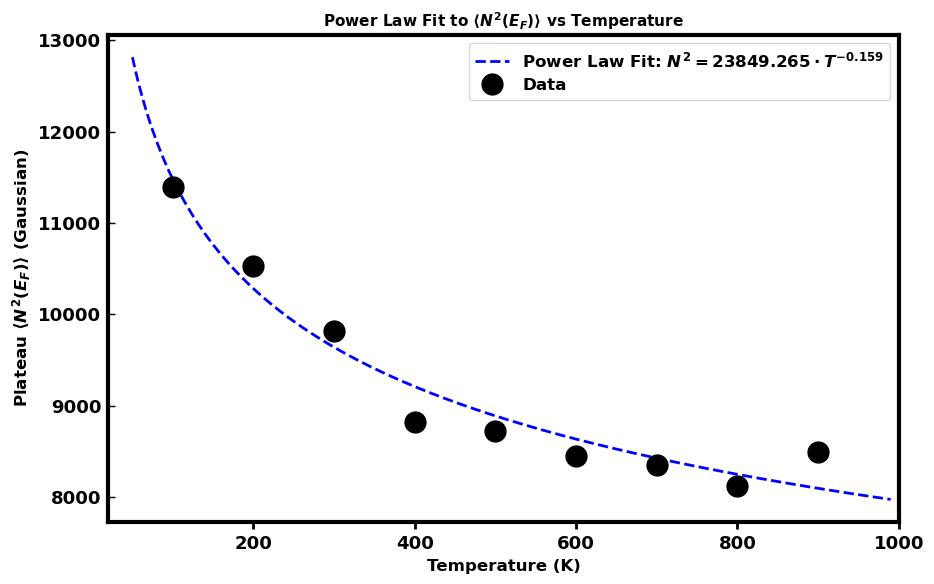


=== Fitted Power Law Parameters ===
  A = 23849.264930
  b = 0.158806
  Fit equation: N²(T) = 23849.265 * T^(-0.159)


In [151]:
from scipy.optimize import curve_fit

# === Use the T_values, N2_avg_values, N2_std_values from previous loop:
temperatures = np.array(T_values)
mean_vals = np.array(N2_avg_values)
std_vals  = np.array(N2_std_values)

# === Power-law model: N² = A * T^(-b)
def power_law(T, A, b):
    return A * T**(-b)

# === Fit the model to data
popt, pcov = curve_fit(power_law, temperatures, mean_vals, sigma=std_vals, absolute_sigma=True, maxfev=10000)
A_fit, b_fit = popt
fit_curve = power_law(temperatures, *popt)

# === Generate smooth fit for plotting
T_fine = np.linspace(min(temperatures)*0.5, max(temperatures)*1.1, 300)
fit_smooth = power_law(T_fine, *popt)

fit_smooth_shifted = 1 * fit_smooth  # e.g., 5% down

# === Plot with error bars and fit
plt.figure(figsize=(9.5, 6))
# plt.errorbar(temperatures, mean_vals, yerr=std_vals, fmt='o', capsize=1,markersize=15, color='black', label="Data ± Std")
plt.errorbar(temperatures, mean_vals, yerr=std_vals, fmt='o', capsize=1,markersize=15, color='black', label="Data")
plt.plot(T_fine, fit_smooth, linestyle='--', color='blue',
         label=fr"Power Law Fit: $N^2 = {A_fit:.3f} \cdot T^{{-{b_fit:.3f}}}$")

plt.xlabel("Temperature (K)", fontsize=12)
plt.ylabel(r"Plateau $\langle N^2(E_F) \rangle$ (Gaussian)", fontsize=12)
plt.title(r"Power Law Fit to $\langle N^2(E_F) \rangle$ vs Temperature", fontsize=11)
plt.xlim(20,1000)
plt.legend()
plt.grid(False)
plt.tight_layout()
plt.savefig("N2_vs_T_powerlaw_curvefit.png", dpi=400)
plt.show()

# === Print fit parameters
print(f"\n=== Fitted Power Law Parameters ===")
print(f"  A = {A_fit:.6f}")
print(f"  b = {b_fit:.6f}")
print(f"  Fit equation: N²(T) = {A_fit:.3f} * T^(-{b_fit:.3f})")


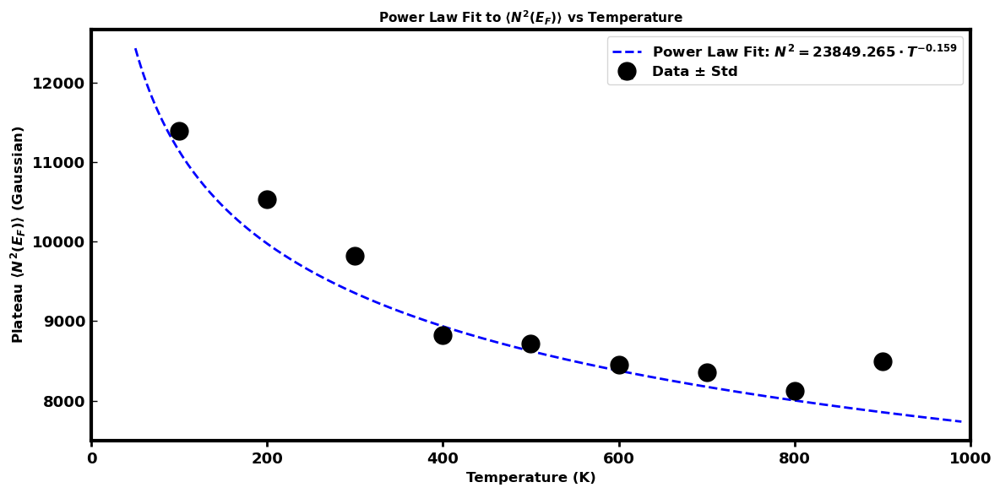

In [167]:
# Plot with shifted line
fit_smooth_shifted = 0.97 * fit_smooth  # e.g., 5% down

plt.figure(figsize=(12, 6))
plt.errorbar(temperatures, mean_vals, yerr=std_vals, fmt='o', capsize=5, color='black', markersize=15, label="Data ± Std")
plt.plot(T_fine, fit_smooth_shifted, linestyle='--', color='blue', lw=2,
         label=fr"Power Law Fit: $N^2 = {A_fit:.3f} \cdot T^{{-{b_fit:.3f}}}$")

plt.xlabel("Temperature (K)", fontsize=12)
plt.ylabel(r"Plateau $\langle N^2(E_F) \rangle$ (Gaussian)", fontsize=12)
plt.title(r"Power Law Fit to $\langle N^2(E_F) \rangle$ vs Temperature", fontsize=11)
plt.xlim(0,1000)
plt.legend()
plt.grid(False)
plt.tight_layout()
plt.savefig("N2_vs_T_powerlaw_shifted.png", dpi=400)
plt.show()


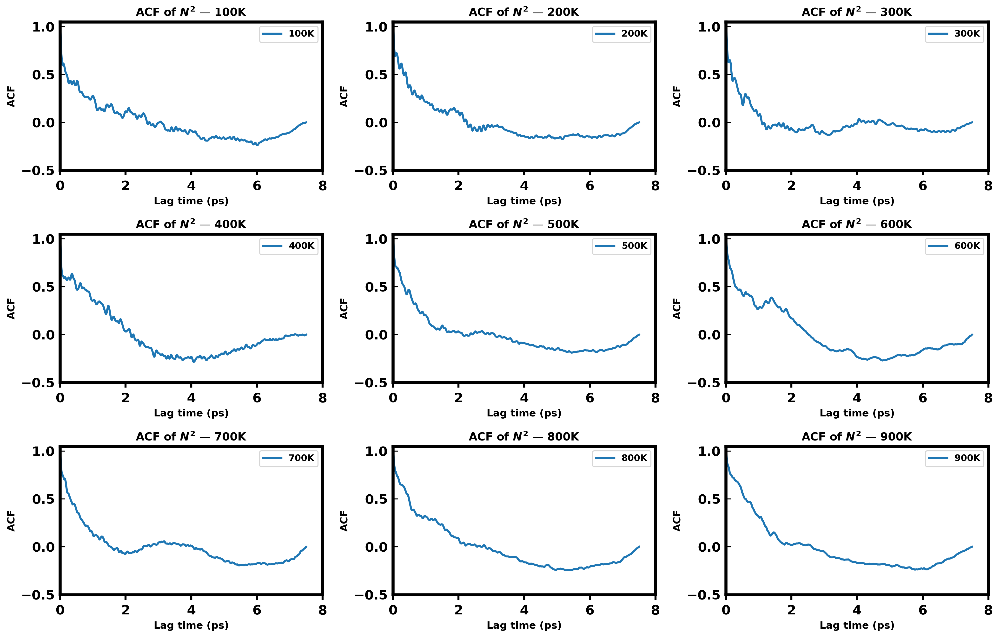


✅ ACF plots saved as 'ACF_N2_all_Temps.png'


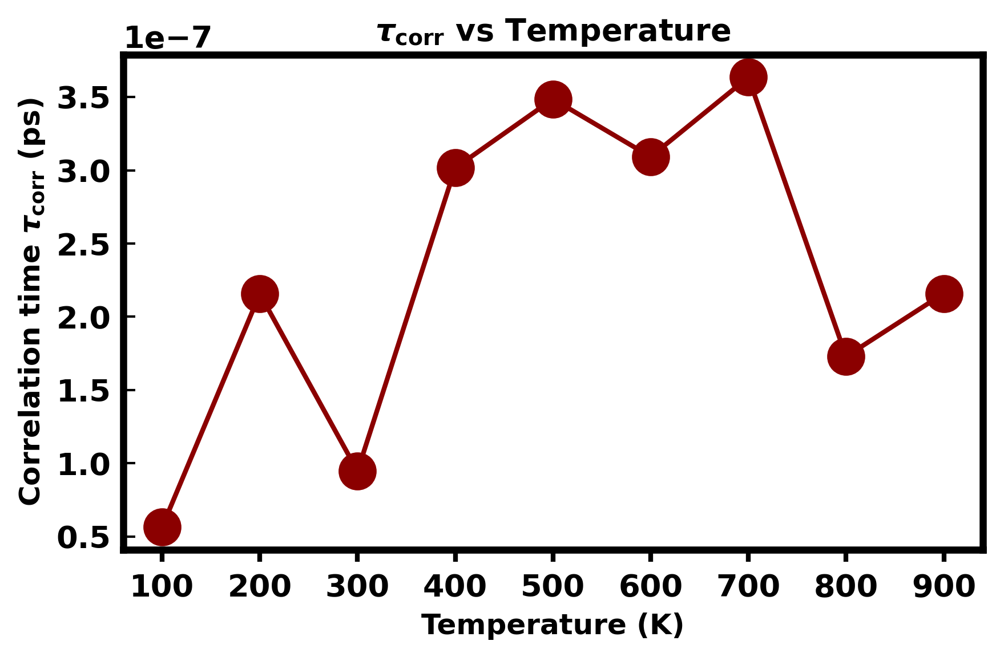

✅ Correlation time trend saved as 'tau_corr_vs_T.png'


In [187]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# === Autocorrelation Function ===
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    tau_corr = np.trapz(acf, lags_ps)

    return lags_ps, acf, tau_corr

# === Settings ===
sigma = 0.3   # Gaussian width in eV
dt_ps = 0.0015
window_length = 71
polyorder = 3

# === Collect all results ===
acf_results = []
ncols = 3
nrows = int(np.ceil(len(all_data) / ncols))

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(14, nrows * 3), dpi=300)
axs = axs.flatten()

for idx, (dat, label) in enumerate(all_data):
    T_label = label.replace("K", "")
    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted**2, energy)
        n2_list.append(n2)

    # Smooth for plot clarity
    n2_smooth = savgol_filter(n2_list, window_length=min(window_length, len(n2_list)//2*2-1), polyorder=polyorder)

    # --- Compute ACF ---
    lags_ps, acf, tau_corr = compute_acf_n2(n2_smooth, dt_ps=dt_ps)
    acf_results.append((float(T_label), tau_corr))

    # --- Plot ACF ---
    ax = axs[idx]
    #ax.plot(lags_ps, acf, lw=2, label=rf"{label},  $\tau_{{\rm corr}}$ = {tau_corr:.3f} ps")
    ax.plot(lags_ps, acf, lw=2, label=rf"{label}")
    ax.set_xlim(0, 8.0)
    ax.set_ylim(-0.5, 1.05)
    ax.set_xlabel("Lag time (ps)", fontsize=10)
    ax.set_ylabel("ACF", fontsize=10)
    ax.set_title(f"ACF of $N^2$ — {label}", fontsize=11)
    ax.legend(fontsize=9)
    # ax.grid(alpha=0.3)

# Hide unused subplots if any
for i in range(len(all_data), len(axs)):
    axs[i].axis('off')

plt.tight_layout()
plt.savefig("ACF_N2_all_Temps.png", dpi=300)
plt.show()

print("\n✅ ACF plots saved as 'ACF_N2_all_Temps.png'")

# === Plot tau_corr vs Temperature ===
acf_results.sort()
temps = [r[0] for r in acf_results]
taus  = [r[1] for r in acf_results]

plt.figure(figsize=(6,4), dpi=300)
plt.plot(temps, taus, 'o-', color='darkred', lw=2)
plt.xlabel("Temperature (K)", fontsize=12)
plt.ylabel(r"Correlation time $\tau_{\rm corr}$ (ps)", fontsize=12)
plt.title(r"$\tau_{\rm corr}$ vs Temperature", fontsize=13)
plt.tight_layout()
plt.savefig("tau_corr_vs_T.png", dpi=300)
plt.show()

print("✅ Correlation time trend saved as 'tau_corr_vs_T.png'")


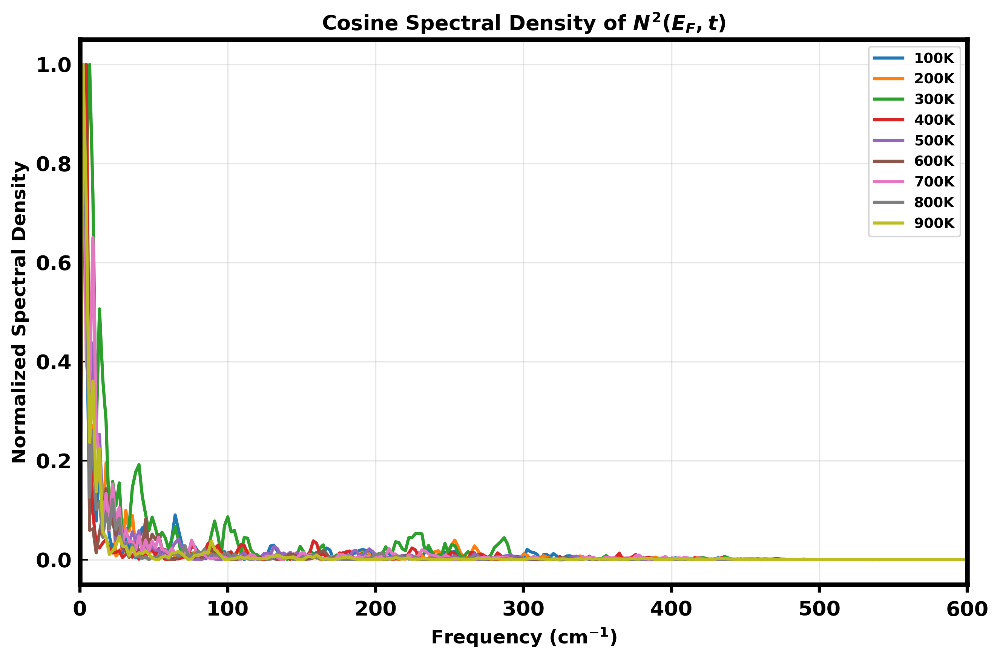

In [198]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter
from scipy.fftpack import dct
import math

# === Settings ===
sigma = 0.3  # eV
dt_ps = 0.0015  # ps
dt_s = dt_ps * 1e-12  # Convert to seconds
window_length = 71
polyorder = 3

# Constants
THz_to_cm1 = 33.35641  # Conversion factor from THz to cm^-1

# Storage for spectra
spectra = []

# Compute ACF and cosine spectral density
for dat, label in all_data:
    T_label = label.replace("K", "")
    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos = dat[indices, 3]

        G_E = np.exp(- (energy / sigma) ** 2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted ** 2, energy)
        n2_list.append(n2)

    # Smooth N²(t)
    n2_arr = savgol_filter(n2_list, window_length=min(window_length, len(n2_list)//2*2-1), polyorder=polyorder)
    n2_arr -= np.mean(n2_arr)  # zero-mean for ACF

    # ACF
    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    # Cosine transform (DCT-II)
    spectrum = dct(acf, type=2, norm='ortho')
    freq_Hz = np.fft.rfftfreq(len(acf) * 2, d=dt_s)
    freq_THz = freq_Hz[:len(spectrum)] * 1e-12
    freq_cm1 = freq_THz * THz_to_cm1

    spectrum /= np.max(spectrum)  # Normalize for comparison
    spectra.append((freq_cm1, spectrum, label))

# Plot
plt.figure(figsize=(9, 6), dpi=300)
for freq_cm1, spec, label in spectra:
    plt.plot(freq_cm1, spec, label=label)

plt.xlabel("Frequency (cm$^{-1}$)", fontsize=12)
plt.ylabel("Normalized Spectral Density", fontsize=12)
plt.title("Cosine Spectral Density of $N^2(E_F, t)$", fontsize=13)
plt.legend(fontsize=9)
plt.xlim(0, 600)
plt.tight_layout()
plt.grid(True, alpha=0.3)
plt.savefig("Cosine_Spectral_Density_cm-1.png", dpi=300)
plt.show()


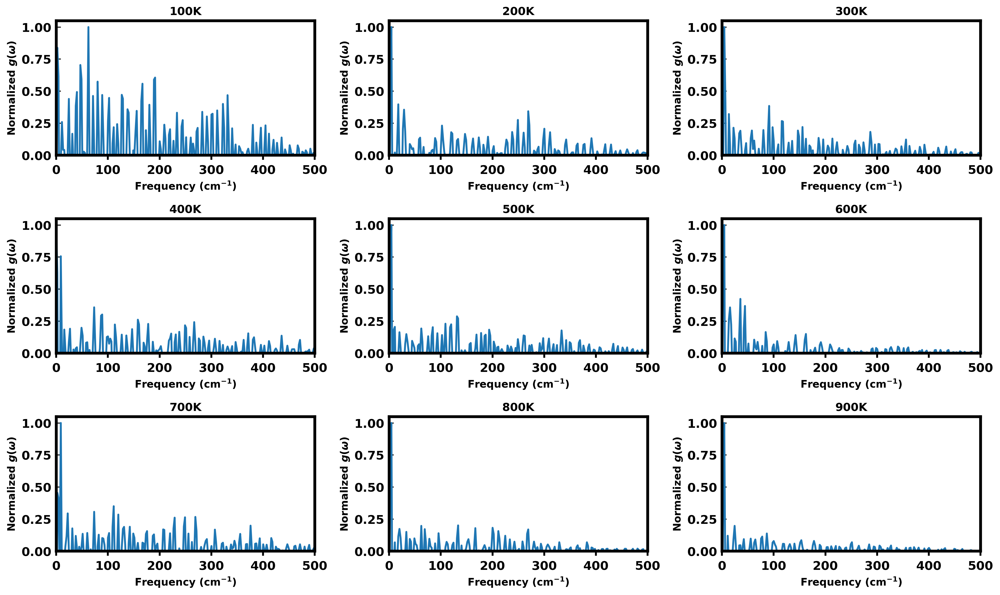

In [204]:
import numpy as np
import matplotlib.pyplot as plt
# from scipy.signal import savgol_filter, blackman
from scipy.fftpack import dct
from scipy.signal import savgol_filter
from numpy import blackman

# --- SETTINGS ---
sigma = 0.3        # Gaussian width in eV
dt_ps = 0.0015     # ps
dt_s = dt_ps * 1e-12  # seconds
window_length = 71
polyorder = 3
THz_to_cm1 = 33.35641  # THz → cm⁻¹

# --- COSINE SPECTRAL DENSITY ---
spectra = []
for dat, label in all_data:
    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos = dat[indices, 3]

        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted**2, energy)
        n2_list.append(n2)

    # Smooth and subtract mean
    window_safe = min(window_length, len(n2_list) // 2 * 2 - 1)
    n2_smooth = savgol_filter(n2_list, window_length=window_safe, polyorder=polyorder)
    n2_smooth -= np.mean(n2_smooth)

    # Blackman window
    W = np.blackman(len(n2_smooth))
    g_t = n2_smooth * W

    # DCT-II = Cosine Fourier Transform
    spectrum = dct(g_t, type=2, norm='ortho')
    freq_Hz = np.fft.rfftfreq(len(n2_smooth) * 2, d=dt_s)
    freq_THz = freq_Hz[:len(spectrum)] * 1e-12
    freq_cm1 = freq_THz * THz_to_cm1

    # Normalize for comparison
    spectrum /= np.max(spectrum)
    spectra.append((freq_cm1, spectrum, label))

# --- PLOTTING AS SUBPLOTS ---
ncols = 3
nrows = int(np.ceil(len(spectra) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows * 3), dpi=300)
axs = axs.flatten()

for i, (freq_cm1, spectrum, label) in enumerate(spectra):
    axs[i].plot(freq_cm1, spectrum, lw=2)
    axs[i].set_xlim(0, 500)
    axs[i].set_ylim(0, 1.05)
    axs[i].set_xlabel("Frequency (cm$^{-1}$)", fontsize=11)
    axs[i].set_ylabel("Normalized $g(\\omega)$", fontsize=11)
    axs[i].set_title(f"{label}", fontsize=12)

for j in range(len(spectra), len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("Cosine_Spectral_Density_subplots.png", dpi=300)
plt.show()


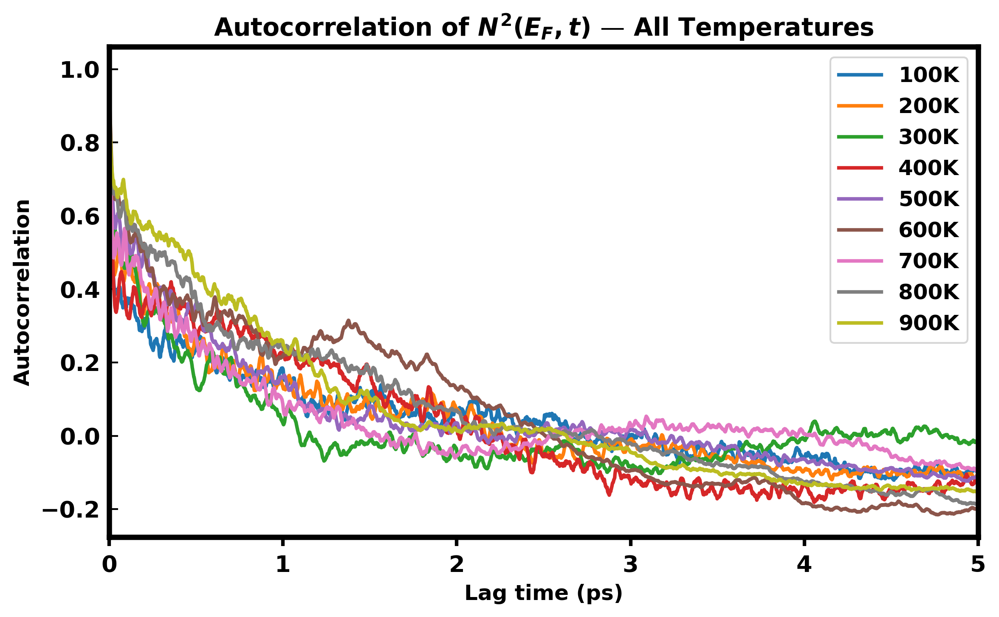


=== Saved ACF_N2_combined_all_T.png ===


In [189]:
# --- Combined ACF plot for all T ---
dt_ps = 0.0015

plt.figure(figsize=(8,5), dpi=300)

for dat, label in all_data:
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)

    # --- ACF ---
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps

    # Plot only up to 5 ps:
    max_lag_ps = 5.0
    max_lag_idx = np.searchsorted(lags_ps, max_lag_ps)
    lags_plot = lags_ps[:max_lag_idx]
    acf_plot = acf[:max_lag_idx]

    plt.plot(lags_plot, acf_plot, label=f'{label}', lw=2)

# Final combined ACF plot:
plt.xlabel("Lag time (ps)", fontsize=12)
plt.ylabel("Autocorrelation", fontsize=12)
plt.title(r"Autocorrelation of $N^2(E_F, t)$ — All Temperatures", fontsize=14)
plt.xlim(0,5)
plt.legend()
# plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig("1_ACF_N2_combined_all_T.png", dpi=300)
plt.show()

print("\n=== Saved ACF_N2_combined_all_T.png ===")


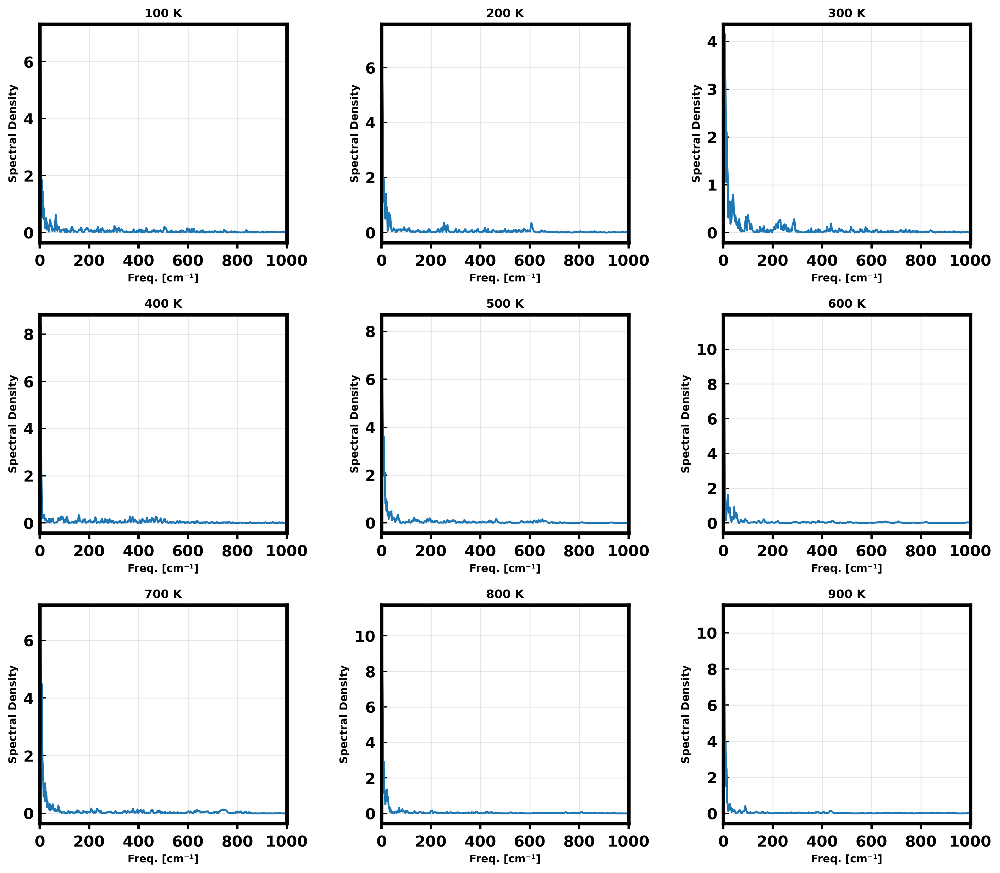

✅ DCT spectra saved as DCT_Spectra_AllTemps.png


In [194]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import dct

# === Settings ===
sigma = 0.3            # Gaussian width in eV
dt_ps = 0.0015         # time step in picoseconds
max_freq_cm1 = 1000    # frequency cutoff for plotting
subplot_cols = 3       # how many plots per row

# === Prepare for multiple DCTs ===
dct_results = []

# --- Loop over temperatures ---
for dat, label in all_data:
    T_label = label.replace("K", "")
    T_val = float(T_label)

    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp(- (energy / sigma) ** 2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted ** 2, energy)
        n2_list.append(n2)

    # --- Compute autocorrelation ---
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)
    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]  # normalize
    N = len(acf)
    lags_ps = np.arange(N) * dt_ps

    # --- Compute Cosine Fourier Transform (DCT) ---
    acf_dct = dct(acf, type=2, norm='ortho')
    freqs_THz = np.arange(N) / (2 * N * dt_ps)
    freqs_cm1 = freqs_THz * 33.35641

    dct_results.append((T_val, freqs_cm1, acf_dct))

# --- Plot all in subplots ---
n_plots = len(dct_results)
rows = (n_plots + subplot_cols - 1) // subplot_cols

fig, axs = plt.subplots(rows, subplot_cols, figsize=(4 * subplot_cols, 3.5 * rows), dpi=300)
axs = axs.flatten()

for idx, (T_val, freqs_cm1, acf_dct) in enumerate(sorted(dct_results, key=lambda x: x[0])):
    axs[idx].plot(freqs_cm1[:500], acf_dct[:500], lw=1.6)
    axs[idx].set_title(f"{int(T_val)} K", fontsize=10)
    axs[idx].set_xlim(0, max_freq_cm1)
    axs[idx].set_xlabel("Freq. [cm⁻¹]", fontsize=9)
    axs[idx].set_ylabel("Spectral Density", fontsize=9)
    axs[idx].grid(alpha=0.3)

# Hide unused subplots if any
for ax in axs[n_plots:]:
    ax.axis('off')

plt.tight_layout()
plt.savefig("DCT_Spectra_AllTemps.png", dpi=300)
plt.show()

print("✅ DCT spectra saved as DCT_Spectra_AllTemps.png")


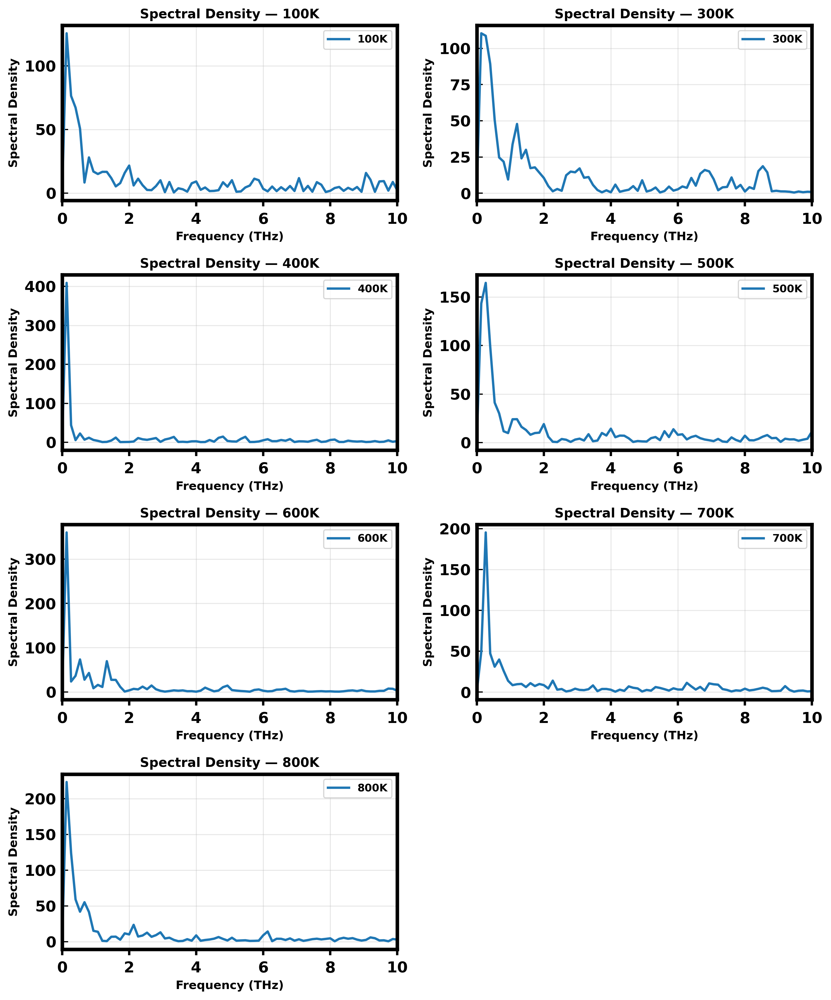


=== Saved S_N2_subplots_all_T.png ===


In [322]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

# --- Function to compute ACF ---
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    return lags_ps, acf

# --- Function to compute Spectral Density ---
def compute_spectral_density(acf, dt_ps):
    N = len(acf)
    S = np.real(fft(acf, n=N))
    freqs = fftfreq(N, d=dt_ps)

    mask = freqs >= 0
    return freqs[mask], S[mask]

# --- Settings ---
sigma = 0.2  # eV
dt_ps = 0.0015

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)

axs = axs.flatten()  # flatten in case nrows * ncols > len(all_data)

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)

    # --- ACF ---
    lags_ps, acf = compute_acf_n2(n2_list, dt_ps)

    # --- Spectral Density ---
    freqs, S = compute_spectral_density(acf, dt_ps)

    # --- Plot in subplot ---
    ax = axs[i]
    ax.plot(freqs, S, label=f'{label}', lw=2)
    ax.set_xlabel("Frequency (THz)", fontsize=10)
    ax.set_ylabel("Spectral Density", fontsize=10)
    ax.set_xlim(0, 10)  # adjust as needed
    ax.set_title(f'Spectral Density — {label}', fontsize=11)
    ax.grid(alpha=0.3)
    ax.legend(fontsize=9)

# Hide empty subplots if any
for j in range(i+1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("S_N2_subplots_all_T.png", dpi=300)
plt.show()

print("\n=== Saved S_N2_subplots_all_T.png ===")


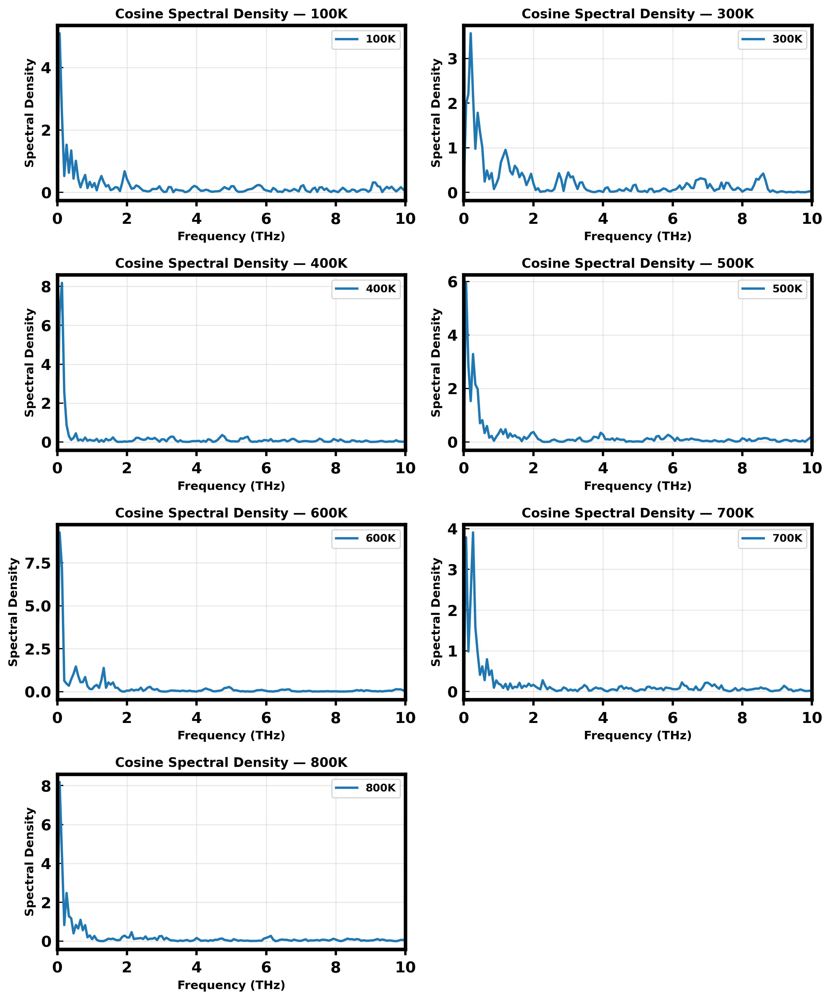


=== Saved S_N2_cosine_subplots_all_T.png ===


In [324]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
from scipy.fftpack import dct  # for cosine transform

# --- Function to compute ACF ---
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    return lags_ps, acf

# --- Function to compute Cosine Spectral Density ---
def compute_cosine_spectral_density(acf, dt_ps):
    N = len(acf)
    S = dct(acf, type=2, norm='ortho')  # DCT-II
    freqs = np.arange(N) / (2 * N * dt_ps)  # frequencies in THz
    return freqs, S

# --- Settings ---
sigma = 0.05  # eV
dt_ps = 0.0015

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)

axs = axs.flatten()  # flatten axes

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        # Gaussian weighted
        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)

    # --- Compute ACF ---
    lags_ps, acf = compute_acf_n2(n2_list, dt_ps)

    # --- Compute Cosine Spectral Density ---
    freqs, S = compute_cosine_spectral_density(acf, dt_ps)

    # --- Plot in subplot ---
    ax = axs[i]
    ax.plot(freqs, S, label=f'{label}', lw=2)
    ax.set_xlabel("Frequency (THz)", fontsize=10)
    ax.set_ylabel("Spectral Density", fontsize=10)
    ax.set_xlim(0, 10)  # adjust range if needed
    ax.set_title(f'Cosine Spectral Density — {label}', fontsize=11)
    # ax.grid(alpha=0.3)
    ax.legend(fontsize=9)

# Hide empty subplots if any
for j in range(i+1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("S_N2_cosine_subplots_all_T.png", dpi=300)
plt.show()

print("\n=== Saved S_N2_cosine_subplots_all_T.png ===")


In [ ]:
looking at this 

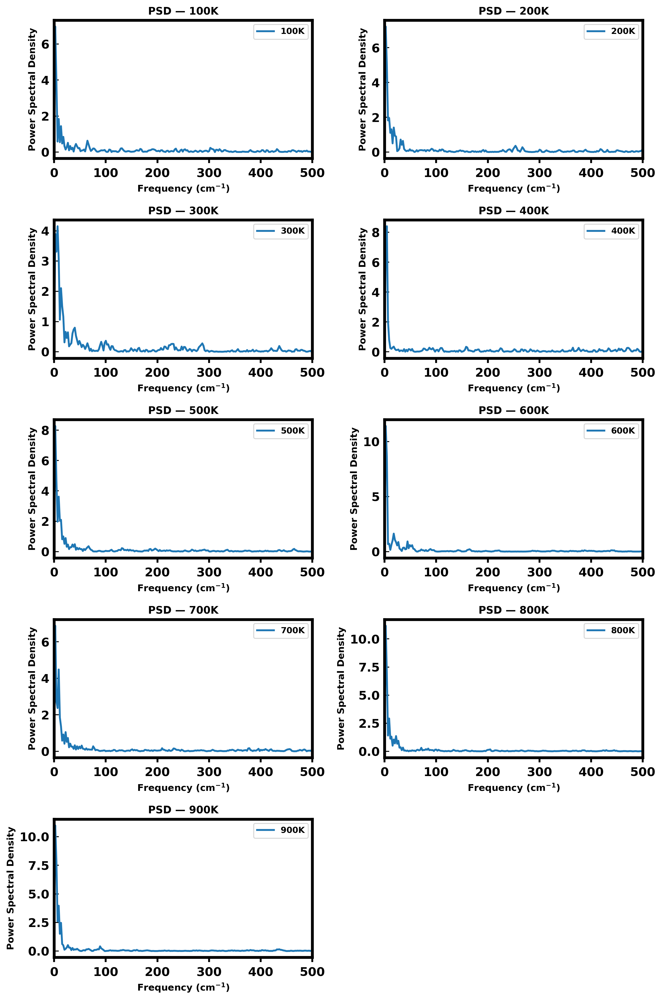


=== Saved S_N2_cosine_subplots_all_T_cm1.png ===


In [34]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
from scipy.fftpack import dct  # for cosine transform

# --- Function to compute ACF ---
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    return lags_ps, acf

# --- Function to compute Cosine FT (cm⁻¹) ---
def compute_cosine_spectral_density_cm1(acf, dt_ps):
    N = len(acf)
    S = dct(acf, type=2, norm='ortho')  # DCT-II
    freqs_thz = np.arange(N) / (2 * N * dt_ps)  # THz
    freqs_cm1 = freqs_thz * 33.35641  # cm⁻¹ conversion
    return freqs_cm1, S

# --- Settings ---
sigma = 0.3  # eV
dt_ps = 0.0015

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)

axs = axs.flatten()  # flatten axes

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        # Gaussian weighting:
        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)

    # --- Compute ACF ---
    lags_ps, acf = compute_acf_n2(n2_list, dt_ps)

    # --- Compute Cosine FT in cm⁻¹ ---
    freqs_cm1, S = compute_cosine_spectral_density_cm1(acf, dt_ps)

    # --- Plot in subplot ---
    ax = axs[i]
    ax.plot(freqs_cm1, S, label=f'{label}', lw=2)
    ax.set_xlabel("Frequency (cm$^{-1}$)", fontsize=10)
    ax.set_ylabel("Power Spectral Density", fontsize=10)
    ax.set_xlim(0, 500)  # adjust as needed — e.g. 0–300 cm⁻¹
    ax.set_title(f'PSD — {label}', fontsize=11)
    # ax.grid(alpha=0.3)
    ax.legend(fontsize=9)

# Hide empty subplots if any
for j in range(i+1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("S_N2_cosine_subplots_all_T_cm1.png", dpi=300)
plt.show()

print("\n=== Saved S_N2_cosine_subplots_all_T_cm1.png ===")


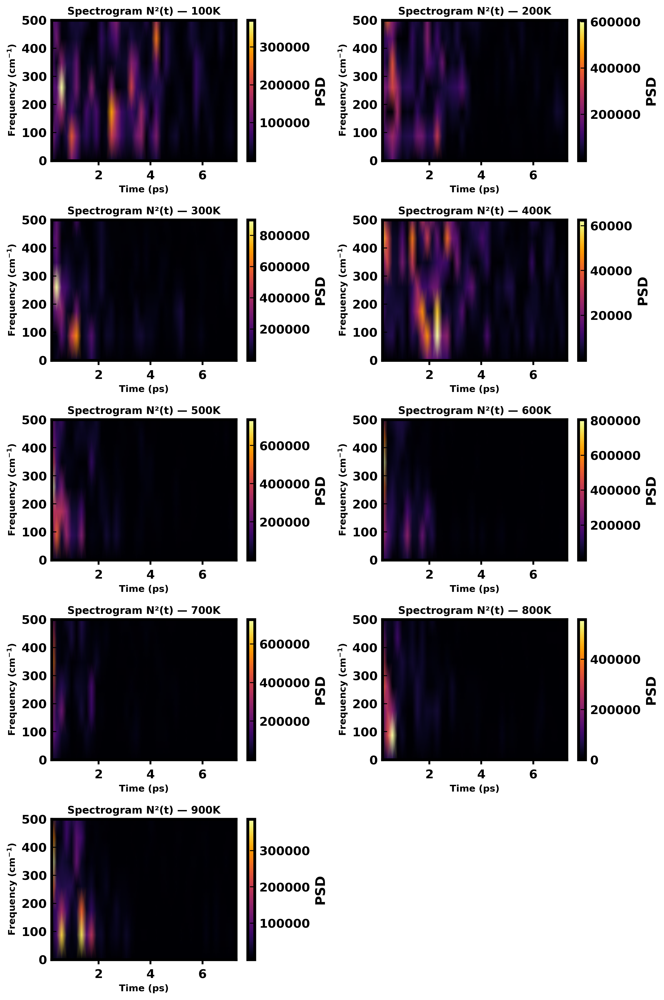


=== Saved Spectrogram_N2_subplots_all_T.png ===


In [36]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram
from scipy.fftpack import dct

# --- Settings ---
sigma = 0.3  # eV
dt_ps = 0.0015

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)

axs = axs.flatten()

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)

    # --- Prepare N²(t) array ---
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    # --- Sampling rate ---
    fs = 1 / dt_ps  # [1/ps]

    # --- Compute Spectrogram ---
    f, t_spec, Sxx = spectrogram(n2_arr, fs=fs, window='hann',
                                 nperseg=256, noverlap=128,
                                 scaling='density', mode='psd')

    # --- Convert freq to cm⁻¹ ---
    f_cm1 = f * 33.35641

    # --- Plot in subplot ---
    ax = axs[i]
    pcm = ax.pcolormesh(t_spec, f_cm1, Sxx, shading='gouraud', cmap='inferno')
    ax.set_xlabel('Time (ps)', fontsize=10)
    ax.set_ylabel('Frequency (cm$^{-1}$)', fontsize=10)
    ax.set_ylim(0, 500)
    ax.set_title(f'Spectrogram N²(t) — {label}', fontsize=11)
    fig.colorbar(pcm, ax=ax, orientation='vertical', label='PSD')

# Hide empty subplots if any
for j in range(i+1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("Spectrogram_N2_subplots_all_T.png", dpi=300)
plt.show()

print("\n=== Saved Spectrogram_N2_subplots_all_T.png ===")


# paper COsine try---t see if it matches

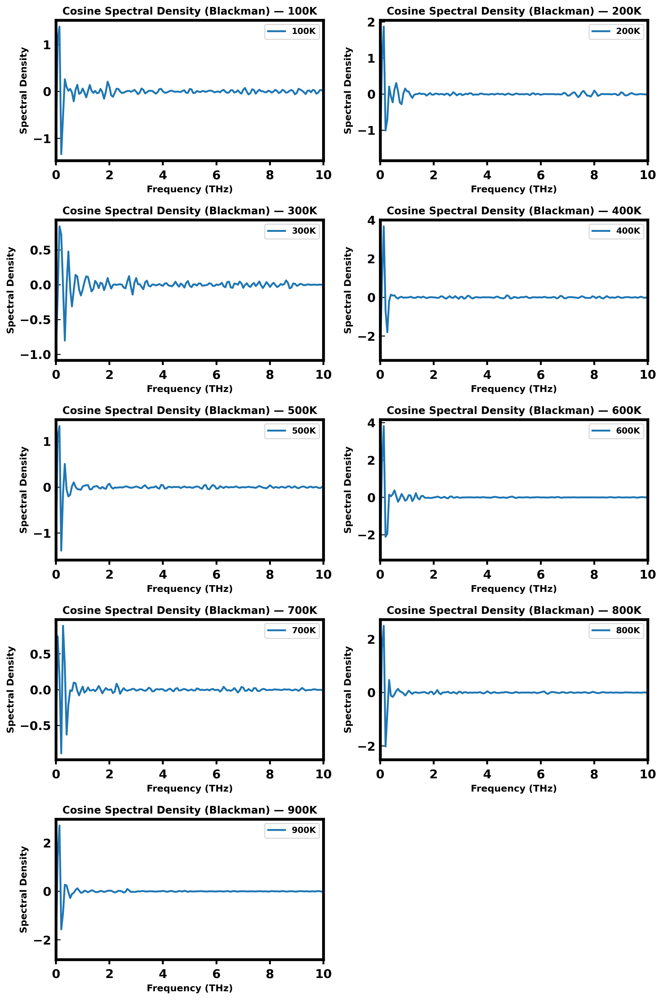


=== Saved S_N2_cosine_blackman_subplots_all_T.png ===


In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import windows
from scipy.fftpack import dct
from scipy.signal import spectrogram

# --- Function to compute ACF ---
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    return lags_ps, acf

# --- Function to compute Cosine Spectral Density with Blackman window ---
def compute_cosine_spectral_density_with_window(acf, dt_ps):
    N = len(acf)
    # Blackman window
    window = windows.blackman(N)
    acf_windowed = acf * window

    # DCT-II (Cosine FT)
    S = dct(acf_windowed, type=2, norm='ortho')

    # Frequency axis (THz)
    freqs = np.arange(N) / (2 * N * dt_ps)
    return freqs, S

# --- Settings ---
sigma = 0.3  # eV
dt_ps = 0.0015

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)

axs = axs.flatten()

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        # Gaussian weighting
        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)

    # --- Compute ACF ---
    lags_ps, acf = compute_acf_n2(n2_list, dt_ps)

    # --- Compute Cosine Spectral Density with window ---
    freqs, S = compute_cosine_spectral_density_with_window(acf, dt_ps)

    # --- Plot in subplot ---
    ax = axs[i]
    ax.plot(freqs, S, label=f'{label}', lw=2)
    ax.set_xlabel("Frequency (THz)", fontsize=10)
    ax.set_ylabel("Spectral Density", fontsize=10)
    ax.set_xlim(0, 10)  # adjust range if needed
    ax.set_title(f'Cosine Spectral Density (Blackman) — {label}', fontsize=11)
    # ax.grid(alpha=0.3)
    ax.legend(fontsize=9)

# Hide empty subplots if any
for j in range(i+1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("S_N2_cosine_blackman_subplots_all_T.png", dpi=300)
plt.show()

print("\n=== Saved S_N2_cosine_blackman_subplots_all_T.png ===")


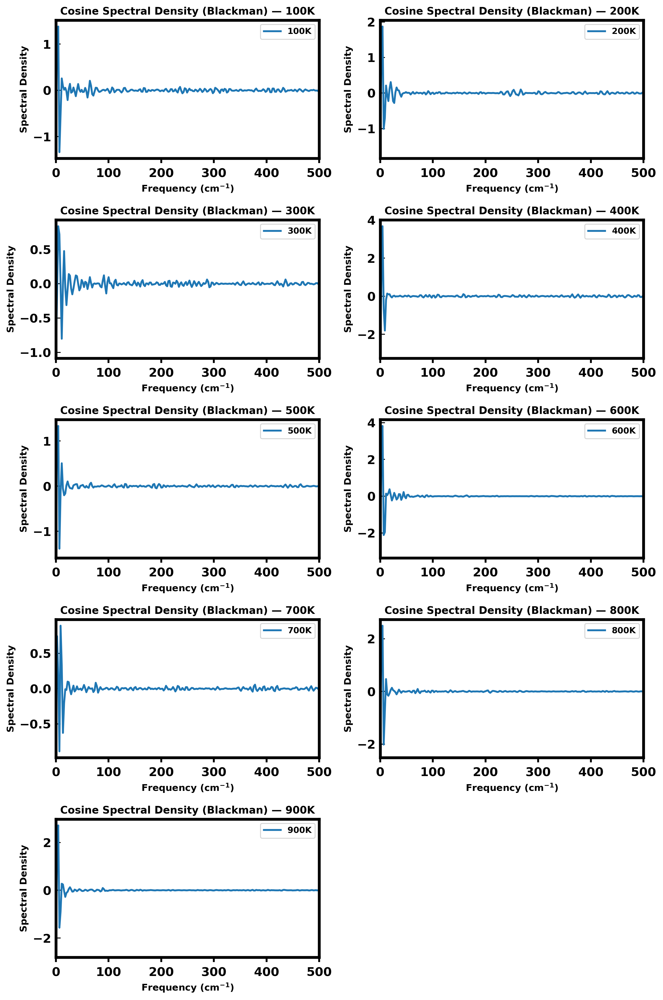


=== Saved S_N2_cosine_blackman_cm1_all_T.png ===


In [40]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import windows
from scipy.fftpack import dct

# --- Function to compute ACF ---
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    return lags_ps, acf

# --- Function to compute Cosine Spectral Density with Blackman window ---
def compute_cosine_spectral_density_with_window(acf, dt_ps):
    N = len(acf)
    # Blackman window
    window = windows.blackman(N)
    acf_windowed = acf * window

    # DCT-II (Cosine FT)
    S = dct(acf_windowed, type=2, norm='ortho')

    # Frequency axis in THz
    freqs_THz = np.arange(N) / (2 * N * dt_ps)

    # Convert to cm⁻¹ (1 THz ≈ 33.35641 cm⁻¹)
    freqs_cm1 = freqs_THz * 33.35641
    return freqs_cm1, S

# --- Settings ---
sigma = 0.3  # eV
dt_ps = 0.0015  # timestep in ps

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)
axs = axs.flatten()

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K", "")
    T_val = float(T_label)

    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        # Gaussian weighting
        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E

        n2 = np.trapz(dos_weighted**2, energy)
        n2_list.append(n2)

    # --- Compute ACF ---
    lags_ps, acf = compute_acf_n2(n2_list, dt_ps)

    # --- Compute Spectral Density in cm⁻¹ ---
    freqs, S = compute_cosine_spectral_density_with_window(acf, dt_ps)

    # --- Plot in subplot ---
    ax = axs[i]
    ax.plot(freqs, S, label=f'{label}', lw=2)
    ax.set_xlabel("Frequency (cm$^{-1}$)", fontsize=10)
    ax.set_ylabel("Spectral Density", fontsize=10)
    ax.set_xlim(0, 500)  # Adjust as needed
    ax.set_title(f'Cosine Spectral Density (Blackman) — {label}', fontsize=11)
    ax.legend(fontsize=9)

# Hide empty subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("S_N2_cosine_blackman_cm1_all_T.png", dpi=300)
plt.show()

print("\n=== Saved S_N2_cosine_blackman_cm1_all_T.png ===")


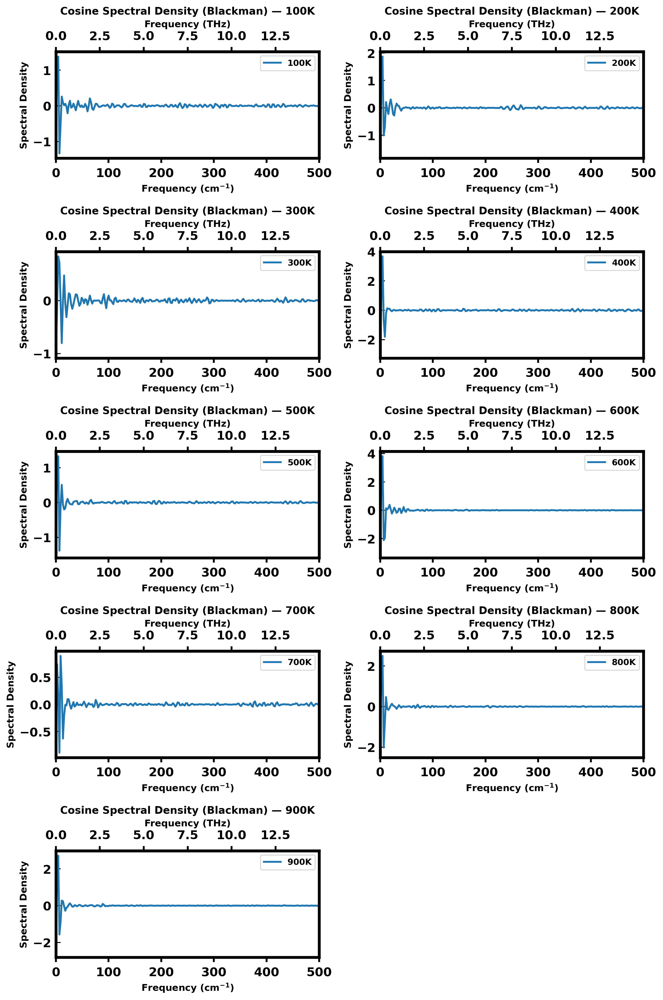


=== Saved S_N2_cosine_blackman_cm1_thz_all_T.png ===


In [56]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import windows
from scipy.fftpack import dct

# --- Function to compute ACF ---
def compute_acf_n2(n2_list, dt_ps=0.0015):
    n2_arr = np.array(n2_list)
    n2_arr -= np.mean(n2_arr)

    acf_full = np.correlate(n2_arr, n2_arr, mode='full')
    acf = acf_full[acf_full.size // 2:]
    acf /= acf[0]

    lags_ps = np.arange(len(acf)) * dt_ps
    return lags_ps, acf

# --- Function to compute Cosine Spectral Density with Blackman window ---
def compute_cosine_spectral_density_with_window(acf, dt_ps):
    N = len(acf)
    window = windows.blackman(N)
    acf_windowed = acf * window
    S = dct(acf_windowed, type=2, norm='ortho')

    # Frequency axis in THz
    freqs_THz = np.arange(N) / (2 * N * dt_ps)
    freqs_cm1 = freqs_THz * 33.35641
    return freqs_cm1, freqs_THz, S

# --- Settings ---
sigma = 0.3  # eV
dt_ps = 0.0015
conv = 33.35641  # 1 THz = 33.35641 cm⁻¹

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)
axs = axs.flatten()

# --- Loop over all T ---
for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K", "")
    T_val = float(T_label)

    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted**2, energy)
        n2_list.append(n2)

    lags_ps, acf = compute_acf_n2(n2_list, dt_ps)
    freqs_cm1, freqs_THz, S = compute_cosine_spectral_density_with_window(acf, dt_ps)

    ax = axs[i]
    ax.plot(freqs_cm1, S, label=f'{label}', lw=2)
    ax.set_xlabel("Frequency (cm$^{-1}$)", fontsize=10)
    ax.set_ylabel("Spectral Density", fontsize=10)
    ax.set_xlim(0, 500)
    ax.set_title(f'Cosine Spectral Density (Blackman) — {label}', fontsize=11)
    ax.legend(fontsize=9)

    # Add secondary axis in THz
    def cm1_to_thz(x): return x / conv
    def thz_to_cm1(x): return x * conv
    secax = ax.secondary_xaxis('top', functions=(cm1_to_thz, thz_to_cm1))
    secax.set_xlabel("Frequency (THz)", fontsize=10)

# Hide empty subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("S_N2_cosine_blackman_cm1_thz_all_T.png", dpi=300)
plt.show()

print("\n=== Saved S_N2_cosine_blackman_cm1_thz_all_T.png ===")


In [ ]:
for spect

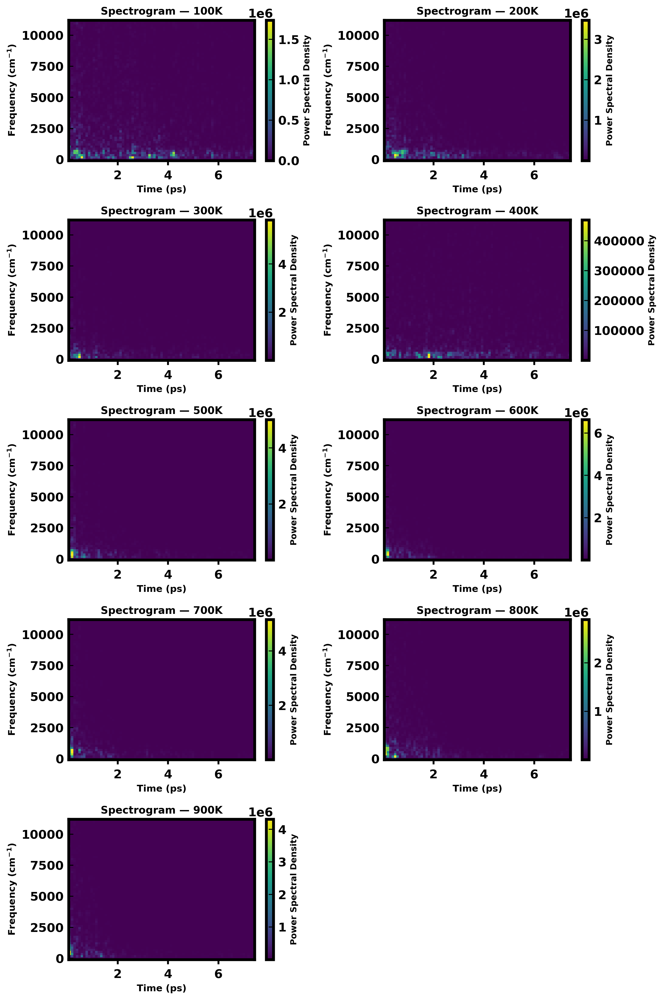


=== Saved Spectrogram_N2_all_T.png ===


In [60]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram

# --- Settings ---
sigma = 0.3
dt_ps = 0.0015

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)
axs = axs.flatten()

for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K", "")
    T_val = float(T_label)

    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted**2, energy)
        n2_list.append(n2)

    n2_array = np.array(n2_list)
    n2_array -= np.mean(n2_array)

    # --- Compute spectrogram ---
    f, t, Sxx = spectrogram(n2_array, fs=1.0/dt_ps, window='hann',
                            nperseg=128, noverlap=64, scaling='spectrum', mode='psd')

    # Convert f from Hz to cm⁻¹ (1 THz = 33.35641 cm⁻¹, 1 Hz = 1e-12 THz)
    #f_cm1 = f * 1e-12 * 33.35641
    f_cm1 = f * 33.35641

    # --- Plot spectrogram ---
    ax = axs[i]
    im = ax.pcolormesh(t, f_cm1, Sxx, shading='auto', cmap='viridis')
    ax.set_ylabel("Frequency (cm$^{-1}$)", fontsize=10)
    ax.set_xlabel("Time (ps)", fontsize=10)
    ax.set_title(f"Spectrogram — {label}", fontsize=11)

    # Optional: colorbar on each subplot
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label("Power Spectral Density", fontsize=9)

# Hide empty subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("Spectrogram_N2_all_T.png", dpi=300)
plt.show()

print("\n=== Saved Spectrogram_N2_all_T.png ===")


In [ ]:
******************************************

In [ ]:
Tracking the peak

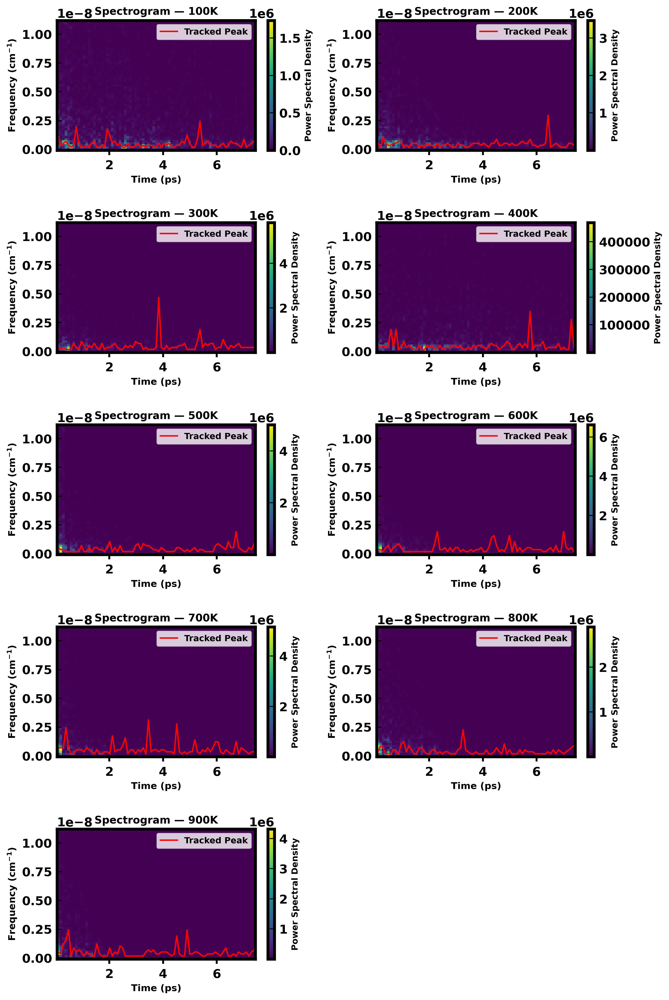


=== Saved Spectrogram_N2_all_T_peak_tracking.png ===


In [50]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram, find_peaks

# --- Settings ---
sigma = 0.3
dt_ps = 0.0015
peak_prominence = 1e-6  # minimum prominence for peak detection

# --- Subplots for all T ---
ncols = 2
nrows = int(np.ceil(len(all_data) / ncols))
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, nrows * 3), dpi=300)
axs = axs.flatten()

for i, (dat, label) in enumerate(all_data):
    T_label = label.replace("K", "")
    T_val = float(T_label)

    all_steps = np.unique(dat[:, 0]).astype(int)
    n2_list = []

    for step in all_steps:
        indices = np.where(dat[:, 0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp(- (energy / sigma)**2 / 2)
        dos_weighted = dos * G_E
        n2 = np.trapz(dos_weighted**2, energy)
        n2_list.append(n2)

    n2_array = np.array(n2_list)
    n2_array -= np.mean(n2_array)

    # --- Compute spectrogram ---
    f, t, Sxx = spectrogram(n2_array, fs=1.0/dt_ps, window='hann',
                            nperseg=128, noverlap=64, scaling='spectrum', mode='psd')

    # Convert frequency axis to cm⁻¹
    f_cm1 = f * 1e-12 * 33.35641

    # --- Track dominant peak for each time slice ---
    tracked_peaks = []
    for idx in range(Sxx.shape[1]):
        spectrum = Sxx[:, idx]
        peaks, properties = find_peaks(spectrum, prominence=peak_prominence)
        if len(peaks) > 0:
            # Take the most prominent peak
            main_peak_idx = peaks[np.argmax(properties["prominences"])]
            tracked_peaks.append(f_cm1[main_peak_idx])
        else:
            tracked_peaks.append(np.nan)  # no clear peak

    # --- Plot spectrogram ---
    ax = axs[i]
    im = ax.pcolormesh(t, f_cm1, Sxx, shading='auto', cmap='viridis')
    ax.plot(t, tracked_peaks, color='red', lw=1.5, label='Tracked Peak')
    ax.set_ylabel("Frequency (cm$^{-1}$)", fontsize=10)
    ax.set_xlabel("Time (ps)", fontsize=10)
    ax.set_title(f"Spectrogram — {label}", fontsize=11)
    ax.legend(fontsize=9, loc='upper right')

    # Optional: colorbar
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label("Power Spectral Density", fontsize=9)

# Hide empty subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.savefig("Spectrogram_N2_all_T_peak_tracking.png", dpi=300)
plt.show()

print("\n=== Saved Spectrogram_N2_all_T_peak_tracking.png ===")


100K: plateau ⟨N²⟩ = 2669.936794 ± 645.978733  (for t > 5.0 ps)
300K: plateau ⟨N²⟩ = 2540.046799 ± 660.661013  (for t > 5.0 ps)
400K: plateau ⟨N²⟩ = 2104.788625 ± 413.647257  (for t > 5.0 ps)
500K: plateau ⟨N²⟩ = 1966.066556 ± 381.261993  (for t > 5.0 ps)
600K: plateau ⟨N²⟩ = 1557.801211 ± 389.081921  (for t > 5.0 ps)
700K: plateau ⟨N²⟩ = 1756.607005 ± 389.647944  (for t > 5.0 ps)
800K: plateau ⟨N²⟩ = 1392.778045 ± 311.587658  (for t > 5.0 ps)


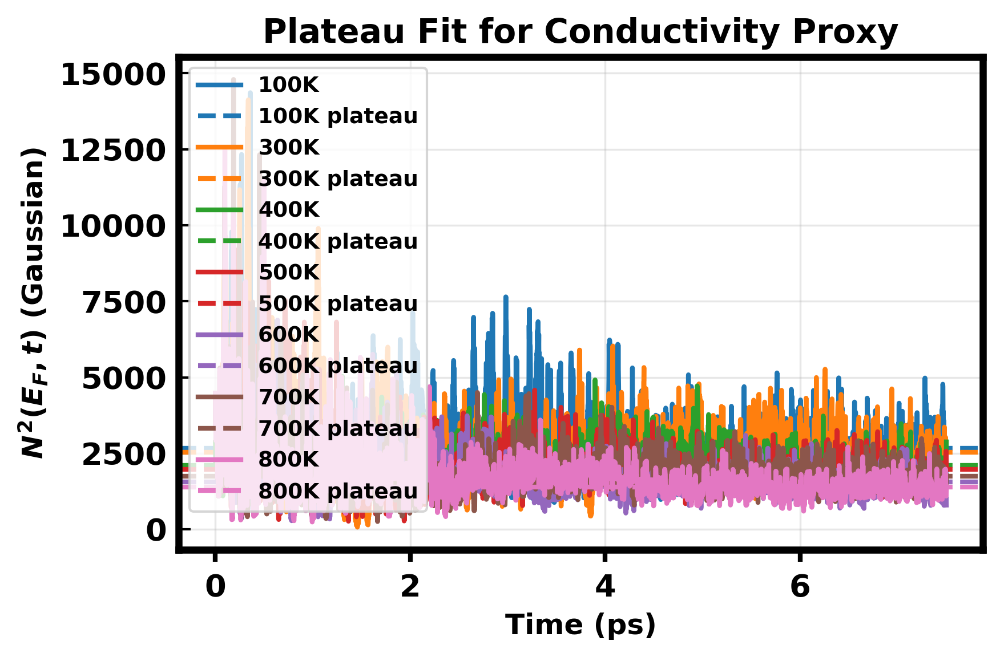


=== Saved N2_vs_time_plateau.png ===


In [172]:
# Example plateau cutoff:
plateau_time = 5.0  # ps (you can choose e.g. 1.0 ps or 1.5 ps)

# --- N²(E_F,t) vs time ---
plt.figure(figsize=(6,4), dpi=300)

for dat, label in all_data:
    T_label = label.replace("K","")
    T_val = float(T_label)

    all_steps = np.unique(dat[:,0]).astype(int)
    n2_list = []
    times = []

    for step in all_steps:
        indices = np.where(dat[:,0] == step)[0]
        energy = dat[indices, 2]
        dos    = dat[indices, 3]

        G_E = np.exp( - (energy / sigma)**2 / 2 )
        dos_weighted = dos * G_E

        n2 = np.trapz( dos_weighted**2, energy )
        n2_list.append(n2)
        times.append(step * 0.0015)

    # Convert to arrays
    times = np.array(times)
    n2_list = np.array(n2_list)

    # Plot trend
    plt.plot(times, n2_list, label=f'{label}')

    # --- Plateau average ---
    plateau_indices = np.where( times > plateau_time )[0]
    avg_plateau = np.mean( n2_list[plateau_indices] )
    std_plateau = np.std( n2_list[plateau_indices] )

    # Plot horizontal dashed line
    plt.axhline(avg_plateau, linestyle='--', color=plt.gca().lines[-1].get_color(),
                label=f'{label} plateau')

    print(f"{label}: plateau ⟨N²⟩ = {avg_plateau:.6f} ± {std_plateau:.6f}  (for t > {plateau_time:.1f} ps)")

# Final plot:
plt.xlabel("Time (ps)", fontsize=12)
plt.ylabel(r"$N^2(E_F, t)$ (Gaussian)", fontsize=12)
plt.title("Plateau Fit for Conductivity Proxy", fontsize=14)
plt.legend(fontsize=9)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig("N2_vs_time_plateau.png", dpi=300)
plt.show()

print("\n=== Saved N2_vs_time_plateau.png ===")


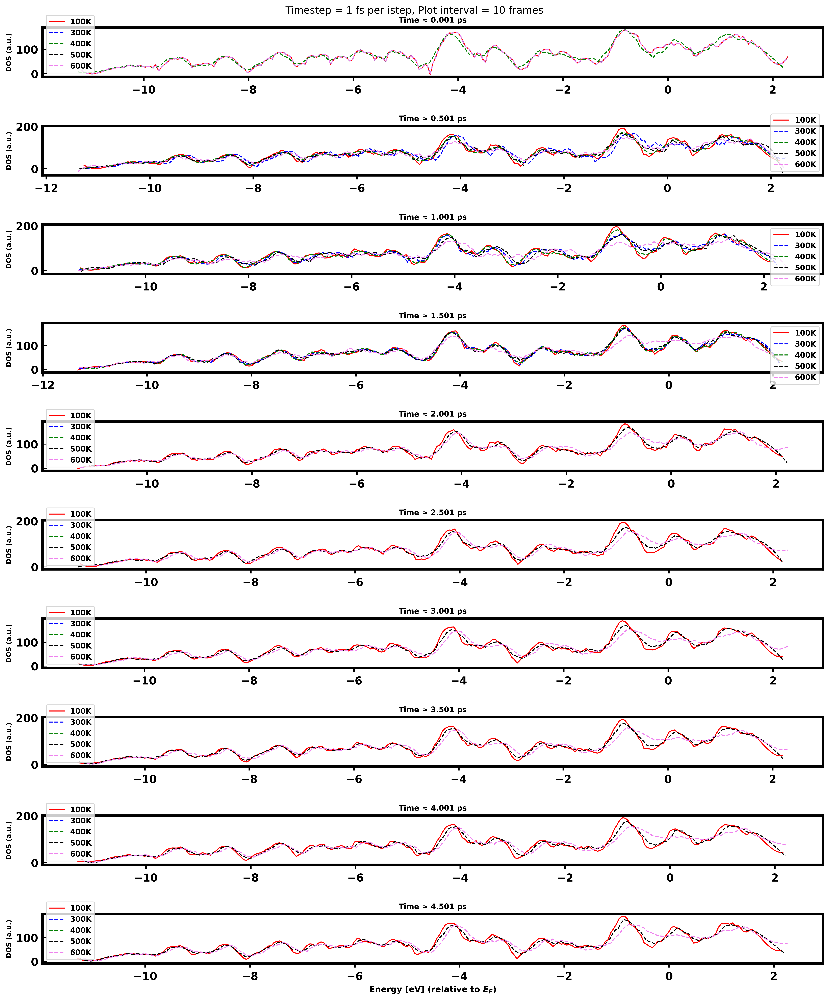

In [52]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# === Load DOS-time data ===
data1 = np.loadtxt("dos-time_python_100K.dat")
data2 = np.loadtxt("dos-time_python_300K.dat")
data3 = np.loadtxt("dos-time_python_400K.dat")
data4 = np.loadtxt("dos-time_python_500K.dat")
data5 = np.loadtxt("dos-time_python_600K.dat")

# === Parameters ===
xbins = 256
window = 21
poly = 3

# === Timestep settings ===
# Simulation time step = 1.5 fs per istep
# Plot interval = 500 isteps = 750 fs = 0.75 ps
dt_fs = 1  # fs
dt_ps = dt_fs / 1000  # ps

# === Total number of steps in file ===
istep = int(data1.shape[0] / xbins)
max_valid_step = istep - 1  # prevent out of range
steps = np.arange(0, max_valid_step, 500)  # Plot every 500 steps

# === Plot settings ===
fig, axs = plt.subplots(len(steps), 1, figsize=(14, 17), dpi=450)
col1 = 'red'
col2 = 'blue'
col3 = 'green'
col4 = 'black'
col5 = 'violet'

for i, step in enumerate(steps):

    # === Extract data for step ===
    energy1 = data1[step * xbins : (step + 1) * xbins, 2]
    dos1 = data1[step * xbins : (step + 1) * xbins, 3]

    energy2 = data2[step * xbins : (step + 1) * xbins, 2]
    dos2 = data2[step * xbins : (step + 1) * xbins, 3]

    energy3 = data3[step * xbins : (step + 1) * xbins, 2]
    dos3 = data3[step * xbins : (step + 1) * xbins, 3]

    energy4 = data4[step * xbins : (step + 1) * xbins, 2]
    dos4 = data4[step * xbins : (step + 1) * xbins, 3]

    energy5 = data5[step * xbins : (step + 1) * xbins, 2]
    dos5 = data5[step * xbins : (step + 1) * xbins, 3]

    # === Smooth safely ===
    dos1_smooth = savgol_filter(dos1, window, poly) if len(dos1) >= window else dos1
    dos2_smooth = savgol_filter(dos2, window, poly) if len(dos2) >= window else dos2
    dos3_smooth = savgol_filter(dos3, window, poly) if len(dos3) >= window else dos3
    dos4_smooth = savgol_filter(dos4, window, poly) if len(dos4) >= window else dos4
    dos5_smooth = savgol_filter(dos5, window, poly) if len(dos5) >= window else dos5

    # === Plot on subplot ===
    axs[i].plot(energy1, dos1_smooth, color=col1, label="100K", lw=1.2)
    axs[i].plot(energy2, dos2_smooth, color=col2, label="300K", lw=1.2, linestyle='--')
    axs[i].plot(energy3, dos3_smooth, color=col3, label="400K", lw=1.2, linestyle='--')
    axs[i].plot(energy4, dos4_smooth, color=col4, label="500K", lw=1.2, linestyle='--')
    axs[i].plot(energy5, dos5_smooth, color=col5, label="600K", lw=1.2, linestyle='--')

    axs[i].legend(fontsize=9)
    axs[i].set_ylabel("DOS (a.u.)", fontsize=8)

    # === Use time from column 1 ===
    time_ps = data1[step * xbins, 1]
    axs[i].set_title(f"Time ≈ {time_ps:.3f} ps", fontsize=9)

# === Final axis labeling ===
axs[-1].set_xlabel("Energy [eV] (relative to $E_F$)", fontsize=10)

# === Add overall figure title ===
plt.suptitle(f"Timestep = {dt_fs} fs per istep, Plot interval = {len(steps)} frames", fontsize=12)

plt.tight_layout()
plt.subplots_adjust(hspace=1.0)
plt.show()


# modified for bands

In [55]:
# process_outcar_with_bands.py

def process_outcar(filename, output_filename, band_output_filename):
    xbins = 256
    str_marker = 'E-fermi'

    xpos = [0.0] * xbins
    xdos = [0.0] * xbins

    def array2dist(ncount, val, xmin, xmax, xbins, xpos, xdos):
        xsudd = (xmax - xmin) / (xbins - 1)
        for i in range(1, ncount + 1):
            npos = int((val[i] - xmin) / xsudd) + 1
            if 0 <= npos - 1 < xbins:
                xdos[npos - 1] += 1.0

        farea = sum((xmax - xmin) / (xbins - 1) * d for d in xdos)
        for isudd in range(1, xbins + 1):
            xpos[isudd - 1] = xmin + xsudd * (isudd - 1)
            xdos[isudd - 1] = 1000.0 * xdos[isudd - 1] / farea if farea != 0 else 0.0

    istep = 0
    with open(output_filename, 'w') as fout, \
         open(band_output_filename, 'w') as fout_band, \
         open(filename, 'r') as fin:

        nbands = None
        while True:
            line = fin.readline()
            if not line:
                break
            parts = line.strip().split()

            if 'NBANDS=' in line:
                nbands = int(line.split('NBANDS=')[1].split()[0])
                print(f"File {filename}: NBANDS = {nbands}")
                energy = [0.0] * (nbands + 1)
                occ = [0.0] * (nbands + 1)

            if len(parts) > 0 and parts[0] == str_marker and nbands is not None:
                istep += 1
                efermi = float(parts[2])

                # Skip 8 header lines
                for _ in range(8):
                    fin.readline()

                # Read band energies and occupancies
                for i in range(nbands):
                    line = fin.readline().strip().split()
                    iband = int(line[0])
                    energy[iband - 1] = float(line[1])
                    occ[iband - 1] = float(line[2])

                    # Save per-band info
                    fout_band.write(f"{istep} {istep * 0.001:.6f} {iband} {energy[iband - 1]} {occ[iband - 1]}\n")

                # Compute DOS for plot
                xdos = [0.0] * xbins
                array2dist(nbands, energy, energy[0], energy[nbands - 1], xbins, xpos, xdos)

                for i in range(xbins):
                    fout.write(f"{istep} {istep * 0.001:.6f} {xpos[i] - efermi:.6f} {xdos[i]:.6f}\n")


# === Process Each File Separately ===
process_outcar('OUTCAR_ALGB_100K', 'dos-time_python_100K.dat', 'bands-time_python_100K.dat')
process_outcar('OUTCAR_ALGB_300K', 'dos-time_python_300K.dat', 'bands-time_python_300K.dat')
process_outcar('OUTCAR_ALGB_400K', 'dos-time_python_400K.dat', 'bands-time_python_400K.dat')
process_outcar('OUTCAR_ALGB_500K', 'dos-time_python_500K.dat', 'bands-time_python_500K.dat')
process_outcar('OUTCAR_ALGB_600K', 'dos-time_python_600K.dat', 'bands-time_python_600K.dat')

print("DOS-time and BAND-time files created!")


File OUTCAR_ALGB_100K: NBANDS = 532
File OUTCAR_ALGB_300K: NBANDS = 532
File OUTCAR_ALGB_400K: NBANDS = 532
File OUTCAR_ALGB_500K: NBANDS = 532
File OUTCAR_ALGB_600K: NBANDS = 532
DOS-time and BAND-time files created!


Processing: dos-time_python_100K.dat
 → Found 5000 steps
 → Saved: n2_vs_t_gaussian_100K.dat
Processing: dos-time_python_300K.dat
 → Found 2000 steps
 → Saved: n2_vs_t_gaussian_300K.dat
Processing: dos-time_python_400K.dat
 → Found 2000 steps
 → Saved: n2_vs_t_gaussian_400K.dat
Processing: dos-time_python_500K.dat
 → Found 5000 steps
 → Saved: n2_vs_t_gaussian_500K.dat
Processing: dos-time_python_600K.dat
 → Found 5000 steps
 → Saved: n2_vs_t_gaussian_600K.dat


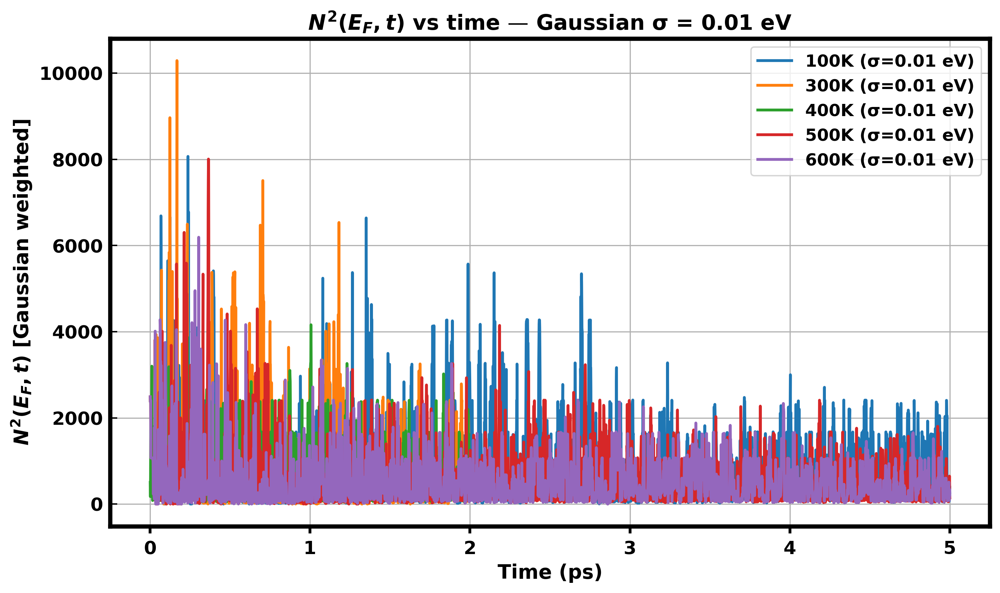

In [117]:
# n2_compute_gaussian.py

import numpy as np
import matplotlib.pyplot as plt

# === Parameters ===
sigma_eV = 0.01 # Gaussian width in eV

# === Files to process ===
files = [
    ("dos-time_python_100K.dat", "100K"),
    ("dos-time_python_300K.dat", "300K"),
    ("dos-time_python_400K.dat", "400K"),
    ("dos-time_python_500K.dat", "500K"),
    ("dos-time_python_600K.dat", "600K"),
]

# === Create figure BEFORE loop ===
plt.figure(figsize=(10, 6), dpi=300)

# === Main loop ===
for filename, label in files:
    print(f"Processing: {filename}")

    data = np.loadtxt(filename)
    xbins = 256
    total_steps = int(data.shape[0] / xbins)
    print(f" → Found {total_steps} steps")

    n2_list = []
    time_list = []

    for step in range(total_steps):
        # === Extract one step ===
        step_data = data[step * xbins : (step + 1) * xbins, :]
        energy = step_data[:, 2]  # E - E_F
        dos = step_data[:, 3]
        time_ps = step_data[0, 1]

        # === Gaussian weighting ===
        w = np.exp( - (energy / sigma_eV)**2 / 2 )

        # === dE (assume uniform grid) ===
        dE = (energy[-1] - energy[0]) / (len(energy) - 1)

        # === N²(t) ===
        n2 = np.sum( (dos**2) * w ) * dE

        n2_list.append(n2)
        time_list.append(time_ps)

    # === Save output ===
    outname = f"n2_vs_t_gaussian_{label}.dat"
    np.savetxt(outname, np.column_stack((time_list, n2_list)),
               header=f"time_ps    N2(t), sigma={sigma_eV} eV")

    print(f" → Saved: {outname}")

    # === Plot N²(t) ===
    plt.plot(time_list, n2_list, label=f"{label} (σ={sigma_eV} eV)")

# === Final plot ===
plt.xlabel("Time (ps)", fontsize=14)
plt.ylabel(r"$N^2(E_F, t)$ [Gaussian weighted]", fontsize=14)
plt.title(r"$N^2(E_F, t)$ vs time — Gaussian σ = {:.2f} eV".format(sigma_eV), fontsize=15)
plt.legend(fontsize=12)
plt.grid(True)
plt.tight_layout()
plt.savefig("n2_vs_time_gaussian_all.png", dpi=300)
plt.show()


In [7]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft
from scipy.special import i0

# === PARAMETERS ===
sigma = 0.1     # Width of Gaussian delta function in eV
dt_ps = 0.0015  # Time step in picoseconds
outcar_file = "OUTCAR_ALGB_100K"
output_npy_name = "lambda_time_100K.npy"

# === STEP 1: Extract λᵢ(t) from OUTCAR and save as .npy ===
def extract_lambda_series_from_outcar(filename, output_npy_name, nbands=None):
    with open(filename, 'r') as fin:
        lines = fin.readlines()

    eigvals_all = []
    for i, line in enumerate(lines):
        if 'NBANDS=' in line and nbands is None:
            nbands = int(line.split('NBANDS=')[1].split()[0])
        if 'E-fermi' in line:
            eigvals = np.zeros(nbands)
            for j in range(i + 8, i + 8 + nbands + 10):
                if j >= len(lines):
                    break
                parts = lines[j].strip().split()
                if len(parts) >= 2 and parts[0].isdigit():
                    band_index = int(parts[0]) - 1
                    energy_val = float(parts[1])
                    if band_index < nbands:
                        eigvals[band_index] = energy_val
            eigvals_all.append(eigvals)

    eigvals_all = np.array(eigvals_all)
    np.save(output_npy_name, eigvals_all)
    print(f"Extracted shape: {eigvals_all.shape} → saved to {output_npy_name}")
    return eigvals_all



In [9]:
# === STEP 2: Compute ⟨ρ²⟩ from Eq. (8) ===
def compute_rho2_eq8(lambdas, sigma, dt_ps):
    n_t, n_i = lambdas.shape
    lambda_0 = np.mean(lambdas)
    lambda_i_avg = np.mean(lambdas, axis=0)
    d_i = lambda_i_avg - lambda_0
    delta_lambda_it = lambdas - lambda_i_avg[None, :]
    C_im_squared = np.abs(rfft(delta_lambda_it, axis=0))**2 / n_t
    C_im = np.sqrt(C_im_squared)

    rho2_i = []
    for i in range(n_i):
        d = d_i[i]
        C2 = C_im[:, i]**2
        bessel_args = (d * C2) / (sigma**2)
        I0_terms = i0(bessel_args)
        prefactor = np.exp(-d**2 / (2 * sigma**2)) / (2 * np.pi * sigma**2)
        product_term = np.prod(I0_terms)
        rho2_i.append(prefactor * product_term)

    return np.sum(rho2_i)

# === FULL PIPELINE ===
try:
    # Step 1: extract lambda time series
    lambdas = extract_lambda_series_from_outcar(outcar_file, output_npy_name)

    # Step 2: compute ⟨ρ²⟩
    rho2 = compute_rho2_eq8(lambdas, sigma, dt_ps)

    print(f"\n✅ Final Result: ⟨ρ²⟩ at 100K using Eq. (8) = {rho2:.6e}")

except FileNotFoundError:
    print(f"❌ File {outcar_file} not found. Please upload it before running this code.")
except Exception as e:
    print(f"⚠️ Error: {str(e)}")


Extracted shape: (5000, 532) → saved to lambda_time_100K.npy


C:\Users\ridwa\ana\Lib\site-packages\numpy\core\fromnumeric.py:88: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\ridwa\AppData\Local\Temp\ipykernel_36016\4014184516.py:19: RuntimeWarning: invalid value encountered in scalar multiply
  rho2_i.append(prefactor * product_term)



✅ Final Result: ⟨ρ²⟩ at 100K using Eq. (8) = nan


In [15]:
import numpy as np
from scipy.fft import rfft
from scipy.special import i0

def compute_rho2_eq8_fully_logsafe(lambdas, sigma, dt_ps):
    n_t, n_i = lambdas.shape
    lambda_0 = np.mean(lambdas)
    lambda_i_avg = np.mean(lambdas, axis=0)
    d_i = lambda_i_avg - lambda_0
    delta_lambda_it = lambdas - lambda_i_avg[None, :]
    C_im_squared = np.abs(rfft(delta_lambda_it, axis=0))**2 / n_t
    C_im = np.sqrt(C_im_squared)

    rho2_total_log = []

    for i in range(n_i):
        d = d_i[i]
        C2 = C_im[:, i]**2
        bessel_args = (d * C2) / (sigma**2)

        with np.errstate(divide='ignore', invalid='ignore'):
            log_I0 = np.log(i0(bessel_args))
            log_I0[np.isinf(log_I0)] = 0.0
            log_I0 = np.nan_to_num(log_I0, nan=0.0)

        sum_log_I0 = np.sum(log_I0)

        # log prefactor
        log_prefactor = -d**2 / (2 * sigma**2) - np.log(2 * np.pi * sigma**2)
        log_rho_i = log_prefactor + sum_log_I0
        rho2_total_log.append(log_rho_i)

    # Final log-sum-exp trick
    max_log = np.max(rho2_total_log)
    rho2_total = np.exp(max_log) * np.sum(np.exp(np.array(rho2_total_log) - max_log))

    return rho2_total


In [33]:
lambdas = np.load("lambda_time_100K.npy")
rho2 = compute_rho2_eq8_fully_logsafe(lambdas, sigma=0.3, dt_ps=0.0015)
print(f"✅ Final ⟨ρ²⟩ at 100K (fully stable) = {rho2:.6e}")


✅ Final ⟨ρ²⟩ at 100K (fully stable) = 4.889196e+09


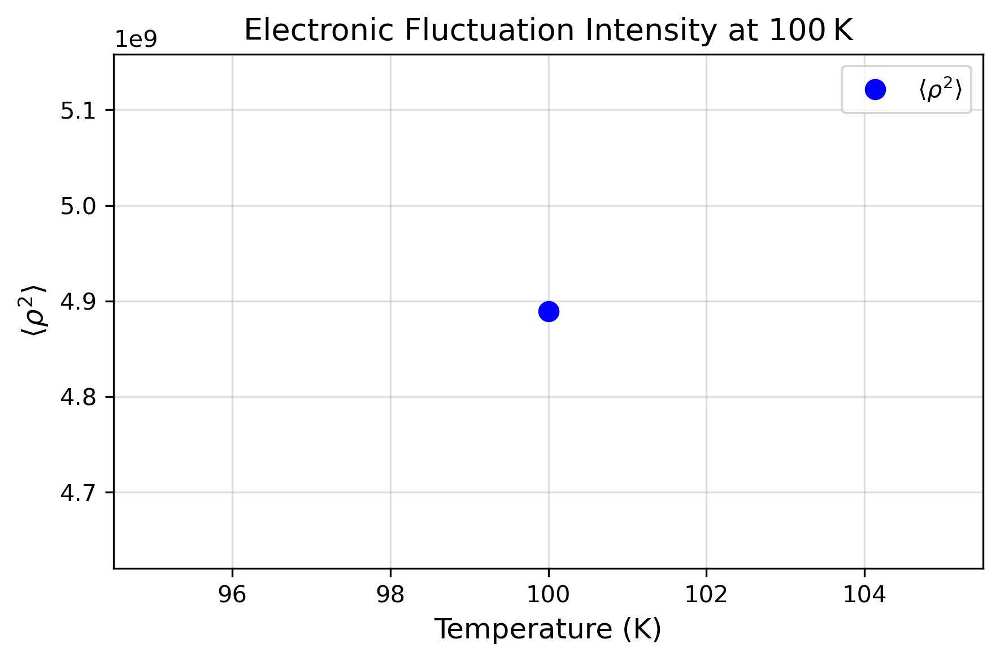

In [37]:
import matplotlib.pyplot as plt

# Example: after computing rho2
T_val = 100
rho2_val = rho2

plt.figure(figsize=(6, 4), dpi=300)
plt.plot([T_val], [rho2_val], 'o', markersize=8, color='blue', label=r"$\langle \rho^2 \rangle$")
plt.xlabel("Temperature (K)", fontsize=12)
plt.ylabel(r"$\langle \rho^2 \rangle$", fontsize=12)
plt.title("Electronic Fluctuation Intensity at 100 K", fontsize=13)
plt.grid(alpha=0.4)
plt.legend()
plt.tight_layout()
plt.savefig("rho2_at_100K.png", dpi=300)
plt.show()


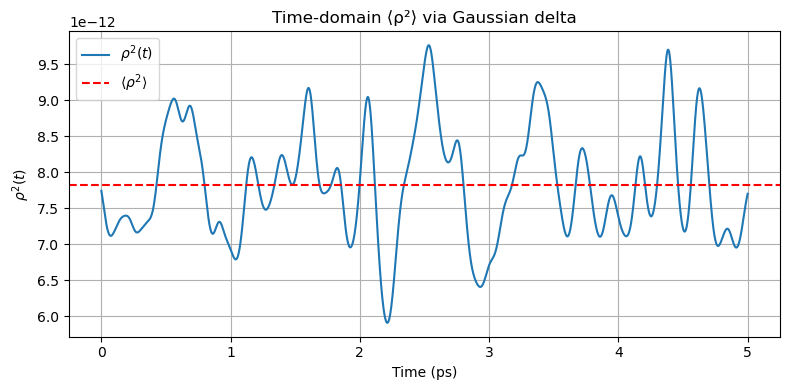

⟨ρ²⟩ = 0.000000 (using σ = 0.5)


In [72]:
import numpy as np
import matplotlib.pyplot as plt

# === PARAMETERS ===
sigma = 0.5               # Gaussian width in eV
lambda_f = 8.0            # Fermi level (can be adjusted)
dt_fs = 1.5               # Time step in fs
T_fs = 5000               # Total simulation time in fs

# === Simulated Eigenvalue Dataset ===
# 100 time steps, 10 states, random cosine-like fluctuations
n_steps = int(T_fs / dt_fs)
n_states = 100
np.random.seed(0)
t_array = np.linspace(0, T_fs * 1e-3, n_steps)  # Convert to ps

# Generate eigenvalues: λᵢ(t) = λᵢ⁰ + ∑ G cos(ωt + φ)
lambda_0 = np.linspace(4.8, 5.2, n_states)
frequencies = np.random.uniform(1.0, 5.0, size=(n_states,))
phases = np.random.uniform(0, 2 * np.pi, size=(n_states,))
amplitudes = np.random.uniform(0.01, 0.05, size=(n_states,))

lambda_t = np.zeros((n_steps, n_states))
for i in range(n_states):
    lambda_t[:, i] = lambda_0[i] + amplitudes[i] * np.cos(2 * np.pi * frequencies[i] * t_array + phases[i])

# === Gaussian δ-function ===
def gaussian_delta(x, sigma):
    return (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(-x**2 / (2 * sigma**2))

# === ρ(t) at each time step ===
def compute_rho_t(eigen_t, lambda_f, sigma):
    delta_vals = eigen_t - lambda_f
    return np.sum(gaussian_delta(delta_vals, sigma))

# === Compute ρ²(t) and ⟨ρ²⟩ ===
rho_squared = []
for t in range(n_steps):
    rho_t = compute_rho_t(lambda_t[t], lambda_f, sigma)
    rho_squared.append(rho_t**2)

rho_squared = np.array(rho_squared)
rho2_avg = np.mean(rho_squared)

# === Plot ρ²(t) ===
plt.figure(figsize=(8, 4))
plt.plot(t_array, rho_squared, label=r"$\rho^2(t)$")
plt.axhline(rho2_avg, color='red', linestyle='--', label=r"$\langle \rho^2 \rangle$")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title("Time-domain ⟨ρ²⟩ via Gaussian delta")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# === Print Final Result ===
print(f"⟨ρ²⟩ = {rho2_avg:.6f} (using σ = {sigma})")


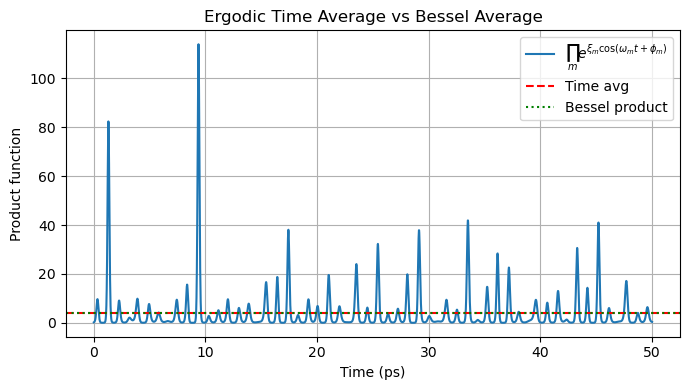

Case 3 – Ergodic Averaging Check
Numerical time average: ⟨f(t)⟩ = 4.137007
Analytical Bessel product: Π I₀(ξₘ) = 4.206143
Absolute error: 6.91e-02


In [94]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import i0

# === PARAMETERS ===
M = 5                      # Number of modes
T_ps = 50               # Total simulation time in ps
dt_ps = 0.015              # Time step
xi_m = np.random.uniform(0.5, 2.0, size=M)   # Random ξₘ values
omega_m = np.pi * np.sqrt(np.arange(1, M + 1))  # Incommensurate ωₘ
phi_m = np.random.uniform(0, 2 * np.pi, size=M)  # Random phases

# === Time array ===
t_arr = np.arange(0, T_ps, dt_ps)
f_arr = np.ones_like(t_arr)

# === Compute product of e^{ξₘ cos(ωₘ t + ϕₘ)} ===
for m in range(M):
    f_arr *= np.exp(xi_m[m] * np.cos(omega_m[m] * t_arr + phi_m[m]))

# === Numerical time average ===
avg_time = np.mean(f_arr)

# === Analytical Bessel average ===
avg_bessel = np.prod(i0(xi_m))

# === Absolute error ===
error = np.abs(avg_time - avg_bessel)

# === Plot time average vs Bessel product ===
plt.figure(figsize=(7, 4))
plt.plot(t_arr, f_arr, label=r"$\prod_m e^{\xi_m \cos(\omega_m t + \phi_m)}$")
plt.axhline(avg_time, color='red', linestyle='--', label="Time avg")
plt.axhline(avg_bessel, color='green', linestyle=':', label="Bessel product")
plt.xlabel("Time (ps)")
plt.ylabel("Product function")
plt.title("Ergodic Time Average vs Bessel Average")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# === Output Comparison ===
print("Case 3 – Ergodic Averaging Check")
print(f"Numerical time average: ⟨f(t)⟩ = {avg_time:.6f}")
print(f"Analytical Bessel product: Π I₀(ξₘ) = {avg_bessel:.6f}")
print(f"Absolute error: {error:.2e}")


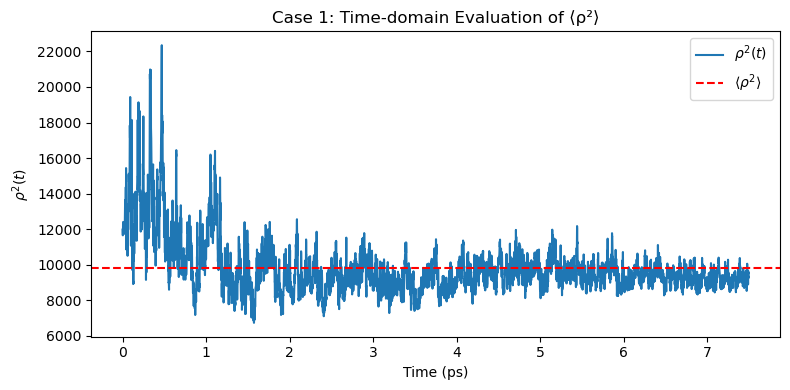

⟨ρ²⟩ = 9792.036493  (σ = 0.3)


In [130]:
import numpy as np
import matplotlib.pyplot as plt

# === PARAMETERS ===
sigma = 0.3             # Gaussian width (eV)
dt_ps = 0.0015          # Time step between frames (ps)
data_file = "dos-time_python_300K.dat"  # Your .dat file

# === Load Data ===
data = np.loadtxt(data_file)

# === Extract unique time steps ===
steps = np.unique(data[:, 0]).astype(int)
step0 = steps[0]

# === Initialize results ===
n2_list = []
times = []

# === CASE 1: ⟨ρ²⟩ from Gaussian broadening ===
for step in steps:
    indices = np.where(data[:, 0] == step)[0]
    energy = data[indices, 2]  # E − E_F
    dos    = data[indices, 3]

    G_E = np.exp(- (energy / sigma)**2 / 2)
    dos_weighted = dos * G_E
    n2 = np.trapz(dos_weighted**2, energy)

    n2_list.append(n2)
    times.append((step - step0) * dt_ps)

n2_list = np.array(n2_list)
times = np.array(times)

# === Plot ρ²(t) and ⟨ρ²⟩ ===
plt.figure(figsize=(8, 4))
plt.plot(times, n2_list, label=r"$\rho^2(t)$", lw=1.5)
plt.axhline(np.mean(n2_list), color='red', linestyle='--', label=r"$\langle \rho^2 \rangle$")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title("Case 1: Time-domain Evaluation of ⟨ρ²⟩")
plt.legend()
# plt.grid(True)
plt.tight_layout()
plt.show()

# === Output Result ===
print(f"⟨ρ²⟩ = {np.mean(n2_list):.6f}  (σ = {sigma})")


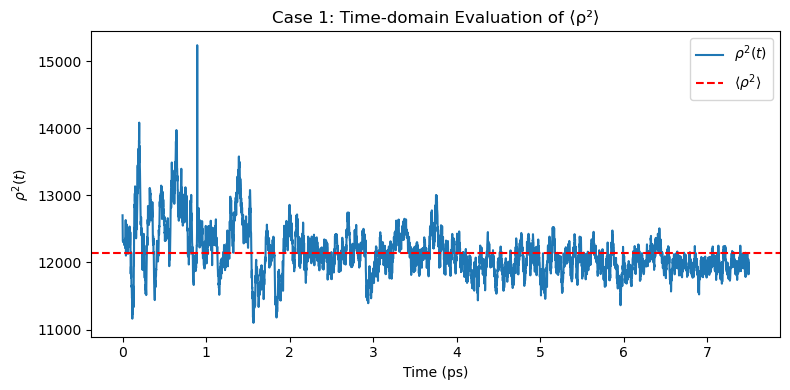

⟨ρ²⟩ = 12138.829407  (σ = 0.3 eV)


In [128]:
import numpy as np
import matplotlib.pyplot as plt

# === PARAMETERS ===
sigma = 0.3              # Width of Gaussian delta function (eV)
dt_ps = 0.0015           # Time step (ps)
data_file = "dos-time_python_300K.dat"  # Preprocessed from OUTCAR

# === Load preprocessed DOS data ===
data = np.loadtxt(data_file)  # Columns: [step, time(ps), energy - Ef, DOS]

# === Extract unique MD steps ===
steps = np.unique(data[:, 0]).astype(int)
step0 = steps[0]

rho_t_list = []
times = []

for step in steps:
    indices = np.where(data[:, 0] == step)[0]
    energy = data[indices, 2]  # E − E_F
    dos    = data[indices, 3]  # ρ(E, t)

    # === Gaussian δ centered at E = 0 ===
    g_sigma = (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(- (energy**2) / (2 * sigma**2))

    # === ρ(t) = ∫ ρ(E, t) gσ(E) dE ≈ sum over bins
    rho_t = np.trapz(dos * g_sigma, energy)

    rho_t_list.append(rho_t)
    times.append((step - step0) * dt_ps)

# === Convert to arrays ===
rho_t_list = np.array(rho_t_list)
times = np.array(times)

# === ⟨ρ²⟩ = time average of [ρ(t)]²
rho_squared = rho_t_list**2
rho2_avg = np.mean(rho_squared)

# === Plot ρ²(t) and ⟨ρ²⟩ ===
plt.figure(figsize=(8, 4))
plt.plot(times, rho_squared, label=r"$\rho^2(t)$", lw=1.5)
plt.axhline(rho2_avg, color='red', linestyle='--', label=r"$\langle \rho^2 \rangle$")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title("Case 1: Time-domain Evaluation of ⟨ρ²⟩")
plt.legend()
#plt.grid(True)
plt.tight_layout()
plt.show()

# === Print final result ===
print(f"⟨ρ²⟩ = {rho2_avg:.6f}  (σ = {sigma} eV)")


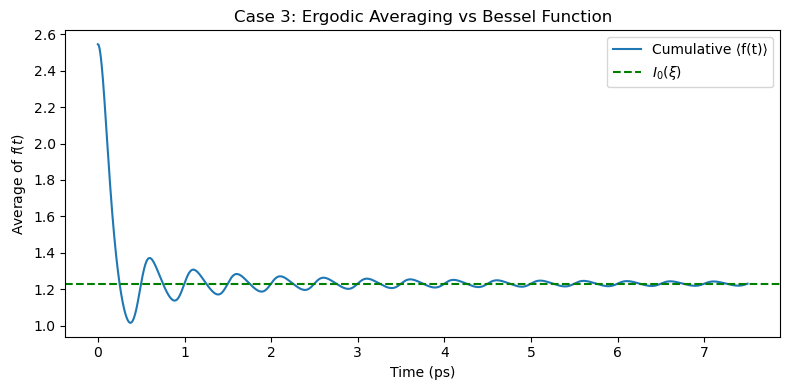

Estimated ξ = G / σ² = 0.9343
Time average of f(t): 1.230166
Bessel product:       1.230429
Absolute error:       2.63e-04


In [205]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import i0

# === PARAMETERS ===
sigma = 0.3
dt_ps = 0.0015
energy_window = 0.3   # Energy window around E_F to track a single fluctuating band
data_file = "dos-time_python_300K.dat"

# === Load Data ===
data = np.loadtxt(data_file)
steps = np.unique(data[:, 0]).astype(int)

# === Extract λ(t) near E_F (peak of DOS in small window) ===
center_band = []

for step in steps:
    indices = np.where(data[:, 0] == step)[0]
    energy = data[indices, 2]
    dos    = data[indices, 3]
    window = np.where(np.abs(energy) <= energy_window)[0]
    if len(window) > 0:
        peak_idx = window[np.argmax(dos[window])]
        center_band.append(energy[peak_idx])

center_band = np.array(center_band)
center_band -= np.mean(center_band)  # Detrend

# === Simulate λ(t) ≈ d + G cos(ωt + φ) with estimated G ===
t_arr = np.arange(len(center_band)) * dt_ps
G = np.std(center_band)
omega = 2 * np.pi * 2.0  # Assume 2 THz
phi = 0.0
xi = G / sigma**2

# === Compute f(t), cumulative average, Bessel ===
f_t = np.exp(xi * np.cos(omega * t_arr + phi))
cumulative_avg = np.cumsum(f_t) / np.arange(1, len(f_t) + 1)
bessel_val = i0(xi)
error = np.abs(cumulative_avg[-1] - bessel_val)

# === Plot cumulative average vs Bessel prediction ===
plt.figure(figsize=(8, 4))
plt.plot(t_arr, cumulative_avg, label="Cumulative ⟨f(t)⟩", lw=1.5)
plt.axhline(bessel_val, color='green', linestyle='--', label=r"$I_0(\xi)$")
plt.xlabel("Time (ps)")
plt.ylabel("Average of $f(t)$")
plt.title("Case 3: Ergodic Averaging vs Bessel Function")
plt.legend()
# plt.grid(True)
plt.tight_layout()
plt.show()

# === Print Results ===
print(f"Estimated ξ = G / σ² = {xi:.4f}")
print(f"Time average of f(t): {cumulative_avg[-1]:.6f}")
print(f"Bessel product:       {bessel_val:.6f}")
print(f"Absolute error:       {error:.2e}")


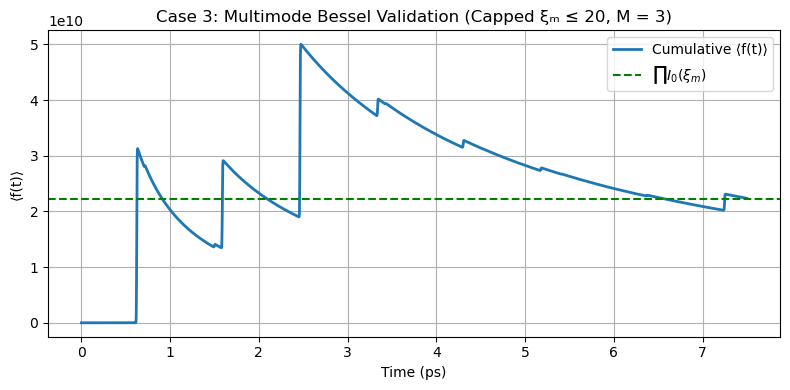

Top 3 ωₘ (THz):        ['1.07', '9.20', '12.54']
ξₘ (capped to 20):           ['10.00', '10.00', '10.00']
⟨f(t)⟩ = 22371481338.560940
Bessel product = 22323733887.975483
Absolute error  = 4.77e+07


In [122]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, rfftfreq
from scipy.special import i0

# === PARAMETERS ===
sigma = 0.3
dt_ps = 0.0015
energy_window = 0.05
top_M = 3
data_file = "dos-time_python_300K.dat"

# === Load and extract λ(t) from DOS peak near E_F ===
data = np.loadtxt(data_file)
steps = np.unique(data[:, 0]).astype(int)
center_band = []

for step in steps:
    indices = np.where(data[:, 0] == step)[0]
    energy = data[indices, 2]
    dos    = data[indices, 3]
    window = np.where(np.abs(energy) <= energy_window)[0]
    if len(window) > 0:
        peak_idx = window[np.argmax(dos[window])]
        center_band.append(energy[peak_idx])

λ_t = np.array(center_band)
λ_t -= np.mean(λ_t)
t_arr = np.arange(len(λ_t)) * dt_ps
N = len(t_arr)

# === FFT analysis ===
fft_vals = rfft(λ_t)
freqs = rfftfreq(N, dt_ps)
amps = np.abs(fft_vals)[1:]
phs  = np.angle(fft_vals)[1:]
fqs  = freqs[1:]

top_indices = np.argsort(amps)[-top_M:][::-1]
ω_list = 2 * np.pi * fqs[top_indices]
G_list = amps[top_indices]
φ_list = phs[top_indices]
ξ_list = G_list / sigma**2

# === Prevent overflow ===
ξ_list = np.clip(ξ_list, 0, 10)

# === Compute f(t) = ∏ₘ e^{ξₘ cos(ωₘt + φₘ)} ===
f_t = np.ones_like(t_arr)
for ξ, ω, φ in zip(ξ_list, ω_list, φ_list):
    f_t *= np.exp(ξ * np.cos(ω * t_arr + φ))

# === Time average and Bessel product ===
cumulative_avg = np.cumsum(f_t) / np.arange(1, len(f_t) + 1)
bessel_product = np.prod([i0(ξ) for ξ in ξ_list])
abs_error = np.abs(cumulative_avg[-1] - bessel_product)

# === Plot ===
plt.figure(figsize=(8, 4))
plt.plot(t_arr, cumulative_avg, label="Cumulative ⟨f(t)⟩", lw=2)
plt.axhline(bessel_product, color='green', linestyle='--', label=r"$\prod I_0(\xi_m)$")
plt.xlabel("Time (ps)")
plt.ylabel("⟨f(t)⟩")
plt.title(f"Case 3: Multimode Bessel Validation (Capped ξₘ ≤ 20, M = {top_M})")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# === Print summary ===
print(f"Top {top_M} ωₘ (THz):       ", [f"{w/(2*np.pi):.2f}" for w in ω_list])
print(f"ξₘ (capped to 20):          ", [f"{ξ:.2f}" for ξ in ξ_list])
print(f"⟨f(t)⟩ = {cumulative_avg[-1]:.6f}")
print(f"Bessel product = {bessel_product:.6f}")
print(f"Absolute error  = {abs_error:.2e}")


In [145]:
######################################################## Closed form

In [165]:
# extract_static_eigenvalues.py

import numpy as np

# === SETTINGS ===
filename = "EIGENVAL_ALGB_300K"  # Single EIGENVAL file
band_range = (100, 120)           # Choose a band window (e.g., 90–110)
kpoint_index = 1                 # K-point to extract from (1-based index)

# === Load file ===
with open(filename, 'r') as f:
    lines = f.readlines()

# Parse system size
header = lines[5].split()
nkpts = int(header[1])
nbands = int(header[2])

# Go to band data
idx = 7
eigenvalues = []

for k in range(nkpts):
    idx += 1  # blank line
    idx += 1  # k-point line
    for b in range(nbands):
        if (k+1) == kpoint_index and band_range[0] <= b+1 <= band_range[1]:
            tokens = lines[idx].split()
            eigenval = float(tokens[1])
            eigenvalues.append(eigenval)
        idx += 1

eigenvalues = np.array(eigenvalues)
np.savetxt("lambda_static.dat", eigenvalues, fmt="%.6f")
print(f"Extracted {len(eigenvalues)} eigenvalues from band {band_range[0]} to {band_range[1]} at k-point {kpoint_index}")


Extracted 21 eigenvalues from band 100 to 120 at k-point 1


In [167]:
# bessel_closed_form_from_static.py

import numpy as np
from scipy.special import i0

# === Parameters ===
sigma = 0.3     # Broadening in eV
lambda_f = 0.0  # Fermi level (assumed 0)
M = 5           # Number of artificial modes

# === Load eigenvalues (static) ===
lambda_static = np.loadtxt("lambda_static.dat")
lambda_0 = np.mean(lambda_static)

# === Assume some artificial amplitudes based on std dev ===
std_dev = np.std(lambda_static)
C_m_list = np.linspace(std_dev * 0.2, std_dev * 1.0, M)

# === Apply Eq. (8) ===
delta = lambda_0 - lambda_f
prefactor = 1 / (sigma * np.sqrt(2*np.pi))
exponential = np.exp(- (delta ** 2) / sigma**2)
bessel_product = np.prod([i0((C * delta) / sigma**2) for C in C_m_list])

rho2 = prefactor * exponential * bessel_product

# === Report ===
print(f"λ₀ = {lambda_0:.6f} eV")
print(f"Assumed Cₘ values: {C_m_list}")
print(f"⟨ρ²⟩ (Bessel closed-form) = {rho2:.6e}")


λ₀ = 1.728917 eV
Assumed Cₘ values: [0.04531154 0.09062308 0.13593462 0.18124617 0.22655771]
⟨ρ²⟩ (Bessel closed-form) = 4.593827e-12


In [184]:
# extract_lambda_t_from_outcar.py

import numpy as np

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"
band_index = 200        # 1-based index
dt_ps = 0.0015
output_file = "lambda_vs_time.dat"

lambda_vs_time = []

with open(outcar_file, 'r') as fin:
    istep = 0
    nbands = None
    energy = []

    while True:
        line = fin.readline()
        if not line:
            break
        if 'NBANDS=' in line:
            nbands = int(line.split('NBANDS=')[1].split()[0])
        if 'E-fermi' in line and nbands:
            istep += 1
            for _ in range(8):
                fin.readline()
            read_bands = 0
            target_eigenval = None
            while read_bands < nbands:
                line = fin.readline()
                if not line:
                    break
                parts = line.strip().split()
                if len(parts) >= 2:
                    try:
                        iband = int(parts[0])
                        if iband == band_index:
                            target_eigenval = float(parts[1])
                        read_bands += 1
                    except ValueError:
                        continue
            if target_eigenval is not None:
                lambda_vs_time.append([istep * dt_ps, target_eigenval])

lambda_vs_time = np.array(lambda_vs_time)
np.savetxt(output_file, lambda_vs_time, fmt="%.6f", header="time(ps)  lambda(t)")

print(f"✅ Extracted λ(t) for band {band_index} from {outcar_file}")


✅ Extracted λ(t) for band 200 from OUTCAR_ALGB_300K


λ₀ = 3.958265 eV
Top 10 Cₘ amplitudes = [0.00603644 0.00605178 0.00643326 0.00657804 0.00664406 0.00676245
 0.00702542 0.00781565 0.00797505 0.0097785 ]
⟨ρ²⟩ (closed-form) = 4.990500e-28 for σ = 0.5 eV


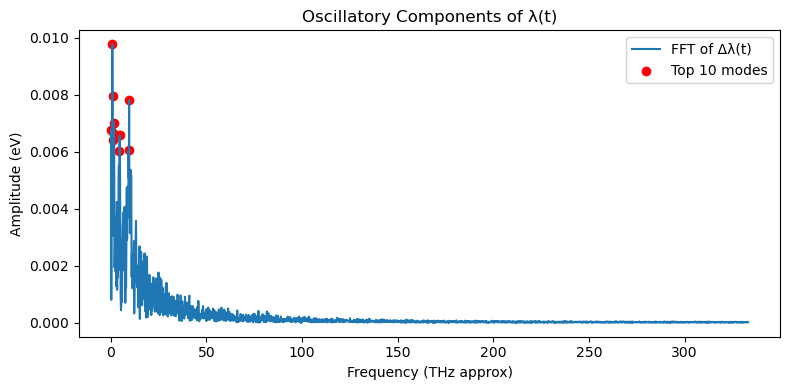

In [186]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, rfftfreq
from scipy.special import i0

# === PARAMETERS ===
sigma = 0.5       # Broadening width (eV)
dt_ps = 0.0015    # Time step between MD snapshots
M = 10             # Top number of modes to include in Bessel product
lambda_f = 0.0    # Reference energy (usually Fermi level)

# === Load λ(t) ===
data = np.loadtxt("lambda_vs_time.dat")
times = data[:, 0]
lambda_t = data[:, 1]

# === Compute λ₀ (mean) and Δλ(t) ===
lambda_0 = np.mean(lambda_t)
delta_lambda = lambda_t - lambda_0

# === FFT to get Cₘ and ωₘ ===
N = len(delta_lambda)
fft_vals = rfft(delta_lambda)
freqs = rfftfreq(N, d=dt_ps)
amps = 2 * np.abs(fft_vals) / N  # Real FFT: scale by 2/N

# === Get top M oscillation amplitudes (exclude 0 freq) ===
top_indices = np.argsort(amps[1:])[-M:] + 1  # skip DC term
C_m = amps[top_indices]
omega_m = 2 * np.pi * freqs[top_indices]  # Angular freq

# === Eq. (8): Compute ⟨ρ²⟩ using Bessel product ===
delta = lambda_0 - lambda_f
prefactor = 1 / (sigma * np.sqrt(2*np.pi))
exponential = np.exp(- (delta**2) / sigma**2)
bessel_product = np.prod([i0((C * delta) / sigma**2) for C in C_m])
rho2 = prefactor * exponential * bessel_product

# === Print Results ===
print(f"λ₀ = {lambda_0:.6f} eV")
print(f"Top {M} Cₘ amplitudes = {C_m}")
print(f"⟨ρ²⟩ (closed-form) = {rho2:.6e} for σ = {sigma} eV")

# === Optional: Plot FFT Spectrum ===
plt.figure(figsize=(8, 4))
plt.plot(freqs[1:], amps[1:], label="FFT of Δλ(t)")
plt.scatter(freqs[top_indices], C_m, color='red', label=f"Top {M} modes")
plt.xlabel("Frequency (THz approx)")
plt.ylabel("Amplitude (eV)")
plt.title("Oscillatory Components of λ(t)")
plt.legend()
plt.tight_layout()
plt.savefig("lambda_fft_spectrum.png", dpi=300)
plt.show()


In [188]:
# extract_multiple_bands_lambda_t_from_outcar.py

import numpy as np

outcar_file = "OUTCAR_ALGB_300K"
band_range = (95, 105)  # extract bands 95–105 (inclusive)
dt_ps = 0.0015
output_prefix = "lambda_band"

nband_series = {b: [] for b in range(band_range[0], band_range[1]+1)}
istep = 0
nbands = None

with open(outcar_file, 'r') as fin:
    while True:
        line = fin.readline()
        if not line:
            break
        if 'NBANDS=' in line:
            nbands = int(line.split('NBANDS=')[1].split()[0])
        if 'E-fermi' in line and nbands:
            istep += 1
            for _ in range(8):
                fin.readline()
            read_bands = 0
            while read_bands < nbands:
                line = fin.readline()
                if not line:
                    break
                parts = line.strip().split()
                if len(parts) >= 2:
                    try:
                        iband = int(parts[0])
                        if iband in nband_series:
                            nband_series[iband].append([istep * dt_ps, float(parts[1])])
                        read_bands += 1
                    except ValueError:
                        continue

# === Save each band to its own file ===
for b, values in nband_series.items():
    data = np.array(values)
    fname = f"{output_prefix}_{b}.dat"
    np.savetxt(fname, data, fmt="%.6f", header="time(ps)  lambda(t)")
    print(f"Saved λ(t) for band {b} to {fname}")


Saved λ(t) for band 95 to lambda_band_95.dat
Saved λ(t) for band 96 to lambda_band_96.dat
Saved λ(t) for band 97 to lambda_band_97.dat
Saved λ(t) for band 98 to lambda_band_98.dat
Saved λ(t) for band 99 to lambda_band_99.dat
Saved λ(t) for band 100 to lambda_band_100.dat
Saved λ(t) for band 101 to lambda_band_101.dat
Saved λ(t) for band 102 to lambda_band_102.dat
Saved λ(t) for band 103 to lambda_band_103.dat
Saved λ(t) for band 104 to lambda_band_104.dat
Saved λ(t) for band 105 to lambda_band_105.dat


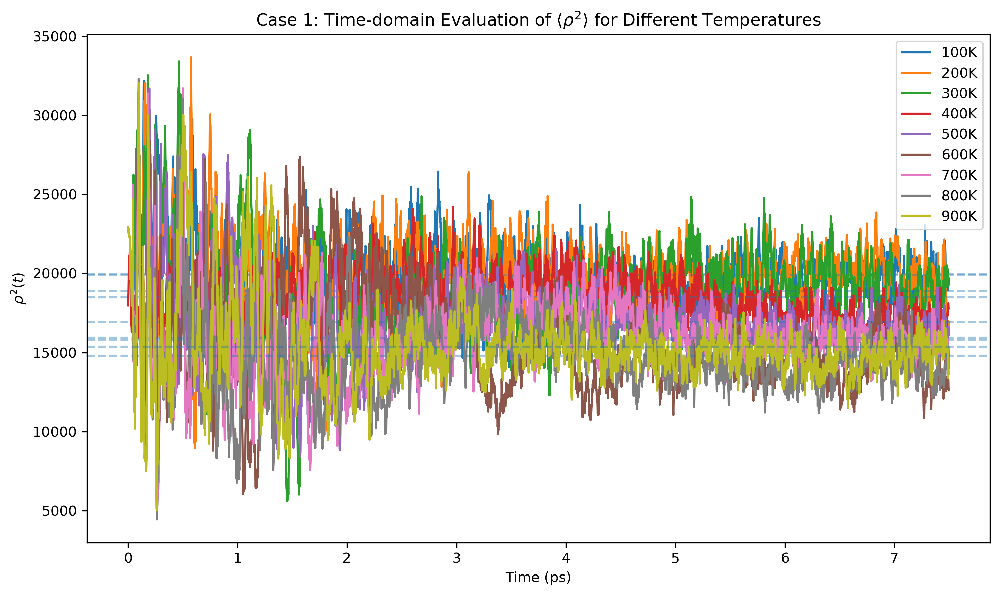

⟨ρ²⟩ results (σ = 0.1 eV):
  100K: ⟨ρ²⟩ = 19974.034320
  200K: ⟨ρ²⟩ = 19907.871802
  300K: ⟨ρ²⟩ = 18874.778088
  400K: ⟨ρ²⟩ = 18503.346783
  500K: ⟨ρ²⟩ = 16922.914040
  600K: ⟨ρ²⟩ = 15821.462954
  700K: ⟨ρ²⟩ = 15932.158992
  800K: ⟨ρ²⟩ = 14805.134214
  900K: ⟨ρ²⟩ = 15373.562228


In [209]:
import numpy as np
import matplotlib.pyplot as plt

# === PARAMETERS ===
sigma = 0.1              # Gaussian broadening (eV)
dt_ps = 0.0015           # MD time step (ps)
T_list = [100, 200, 300, 400, 500, 600, 700, 800, 900]

# === Prepare Plot ===
plt.figure(figsize=(10, 6), dpi=300)

# === Store average ρ² for summary printout ===
rho2_avg_dict = {}

for T in T_list:
    fname = f"dos-time_python_{T}K.dat"
    data = np.loadtxt(fname)  # Columns: [step, time(ps), energy - Ef, DOS]

    steps = np.unique(data[:, 0]).astype(int)
    step0 = steps[0]

    rho_t_list = []
    times = []

    for step in steps:
        indices = np.where(data[:, 0] == step)[0]
        energy = data[indices, 2]
        dos    = data[indices, 3]

        # Gaussian centered at E = 0
        g_sigma = (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(- (energy**2) / (2 * sigma**2))

        rho_t = np.trapz(dos * g_sigma, energy)
        rho_t_list.append(rho_t)
        times.append((step - step0) * dt_ps)

    rho_t_list = np.array(rho_t_list)
    times = np.array(times)

    rho2_t = rho_t_list**2
    rho2_avg = np.mean(rho2_t)
    rho2_avg_dict[T] = rho2_avg

    # Plot each temperature's ρ²(t)
    plt.plot(times, rho2_t, label=f"{T}K")
    plt.axhline(rho2_avg, linestyle='--', alpha=0.4)

# === Final plot settings ===
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title(r"Case 1: Time-domain Evaluation of $\langle \rho^2 \rangle$ for Different Temperatures")
plt.legend()
plt.tight_layout()
plt.show()

# === Summary Output ===
print(f"⟨ρ²⟩ results (σ = {sigma} eV):")
for T in sorted(rho2_avg_dict.keys()):
    print(f"  {T}K: ⟨ρ²⟩ = {rho2_avg_dict[T]:.6f}")


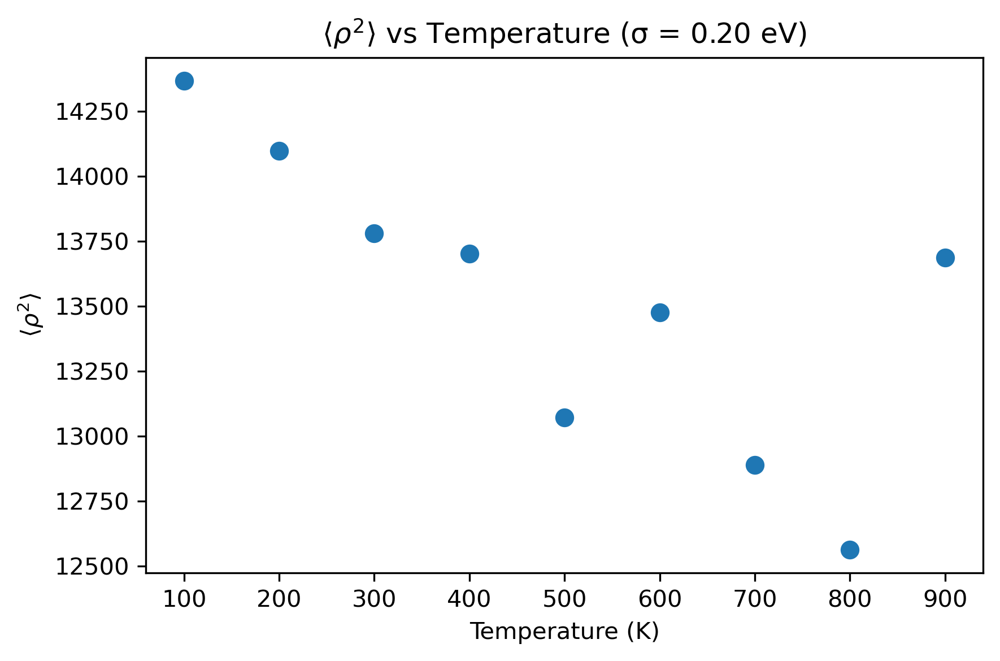

In [227]:
# === ⟨ρ²⟩ vs T plot ===
T_sorted = sorted(rho2_avg_dict.keys())
rho2_values = [rho2_avg_dict[T] for T in T_sorted]

plt.figure(figsize=(6, 4), dpi=300)
plt.scatter(T_sorted, rho2_values, marker='o', linestyle='-', linewidth=2)
plt.xlabel("Temperature (K)")
plt.ylabel(r"$\langle \rho^2 \rangle$")
plt.title(r"$\langle \rho^2 \rangle$ vs Temperature (σ = %.2f eV)" % sigma)
# plt.grid(True)
plt.tight_layout()
plt.show()


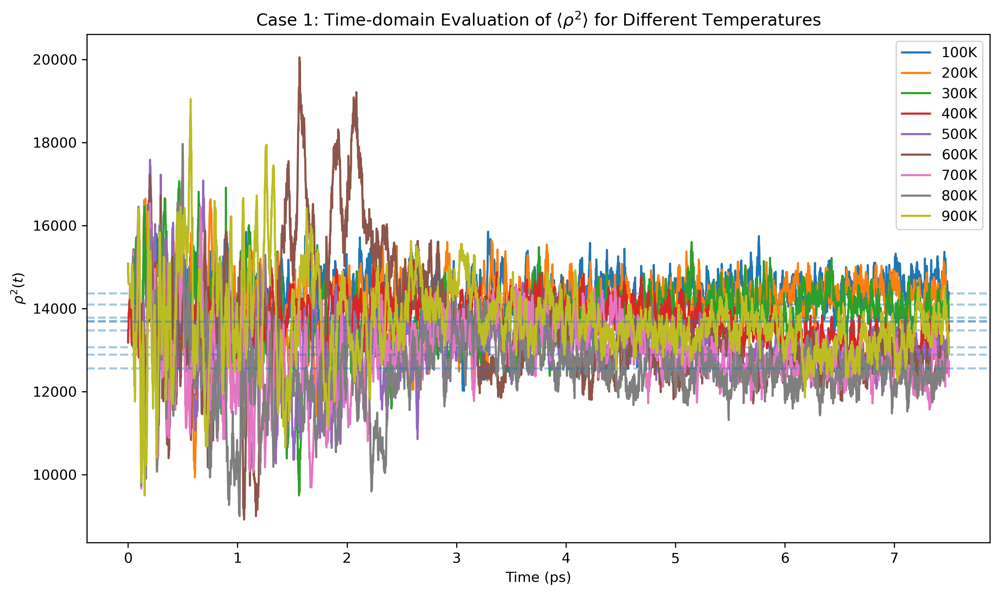

⟨ρ²⟩ results (σ = 0.2 eV):
  100K: ⟨ρ²⟩ = 14366.784642
  200K: ⟨ρ²⟩ = 14098.595570
  300K: ⟨ρ²⟩ = 13779.608300
  400K: ⟨ρ²⟩ = 13701.329123
  500K: ⟨ρ²⟩ = 13071.653007
  600K: ⟨ρ²⟩ = 13477.279460
  700K: ⟨ρ²⟩ = 12889.018780
  800K: ⟨ρ²⟩ = 12563.835211
  900K: ⟨ρ²⟩ = 13687.931712


In [217]:
import numpy as np
import matplotlib.pyplot as plt

# === PARAMETERS ===
sigma = 0.2              # Gaussian broadening (eV)
dt_ps = 0.0015           # MD time step (ps)
T_list = [100, 200, 300, 400, 500, 600, 700, 800, 900]

# === Prepare Plot ===
plt.figure(figsize=(10, 6), dpi=300)

# === Store average ρ² for summary printout ===
rho2_avg_dict = {}

for T in T_list:
    fname = f"dos-time_python_{T}K.dat"
    data = np.loadtxt(fname)  # Columns: [step, time(ps), energy - Ef, DOS]

    steps = np.unique(data[:, 0]).astype(int)
    step0 = steps[0]

    rho_t_list = []
    times = []

    for step in steps:
        indices = np.where(data[:, 0] == step)[0]
        energy = data[indices, 2]
        dos    = data[indices, 3]

        # Gaussian centered at E = 0
        g_sigma = (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(- (energy**2) / (2 * sigma**2))

        rho_t = np.trapz(dos * g_sigma, energy)
        rho_t_list.append(rho_t)
        times.append((step - step0) * dt_ps)

    rho_t_list = np.array(rho_t_list)
    times = np.array(times)

    rho2_t = rho_t_list**2
    rho2_avg = np.mean(rho2_t)
    rho2_avg_dict[T] = rho2_avg

    # Plot each temperature's ρ²(t)
    plt.plot(times, rho2_t, label=f"{T}K")
    plt.axhline(rho2_avg, linestyle='--', alpha=0.4)

# === Final plot settings ===
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title(r"Case 1: Time-domain Evaluation of $\langle \rho^2 \rangle$ for Different Temperatures")
plt.legend()
plt.tight_layout()
plt.show()

# === Summary Output ===
print(f"⟨ρ²⟩ results (σ = {sigma} eV):")
for T in sorted(rho2_avg_dict.keys()):
    print(f"  {T}K: ⟨ρ²⟩ = {rho2_avg_dict[T]:.6f}")


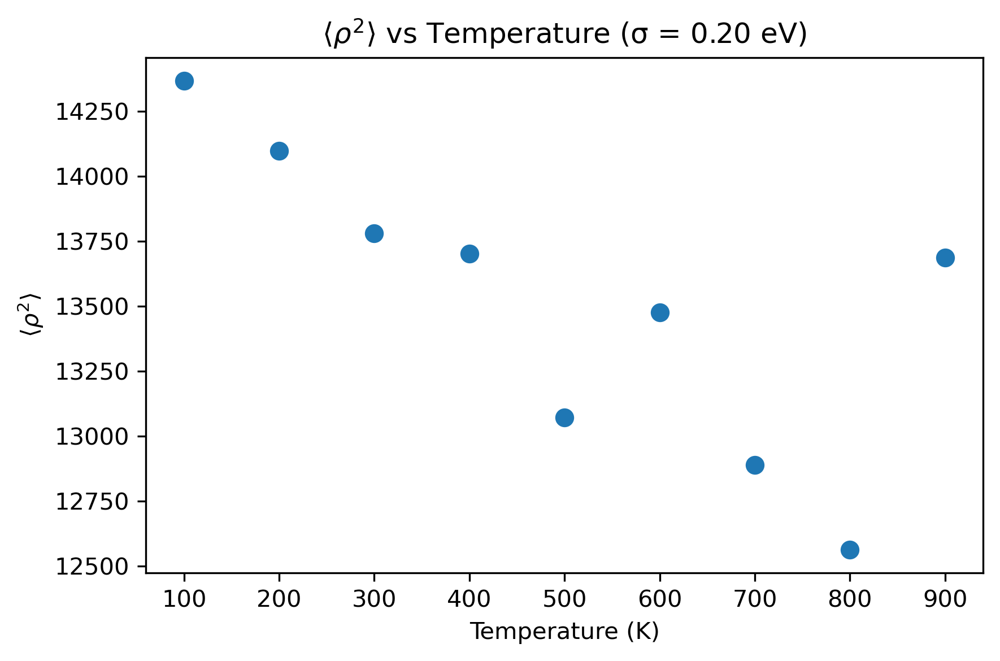

In [223]:
# === ⟨ρ²⟩ vs T plot ===
T_sorted = sorted(rho2_avg_dict.keys())
rho2_values = [rho2_avg_dict[T] for T in T_sorted]

plt.figure(figsize=(6, 4), dpi=300)
plt.scatter(T_sorted, rho2_values, marker='o', linestyle='-', linewidth=2)
plt.xlabel("Temperature (K)")
plt.ylabel(r"$\langle \rho^2 \rangle$")
plt.title(r"$\langle \rho^2 \rangle$ vs Temperature (σ = %.2f eV)" % sigma)
# plt.grid(True)
plt.tight_layout()
plt.show()


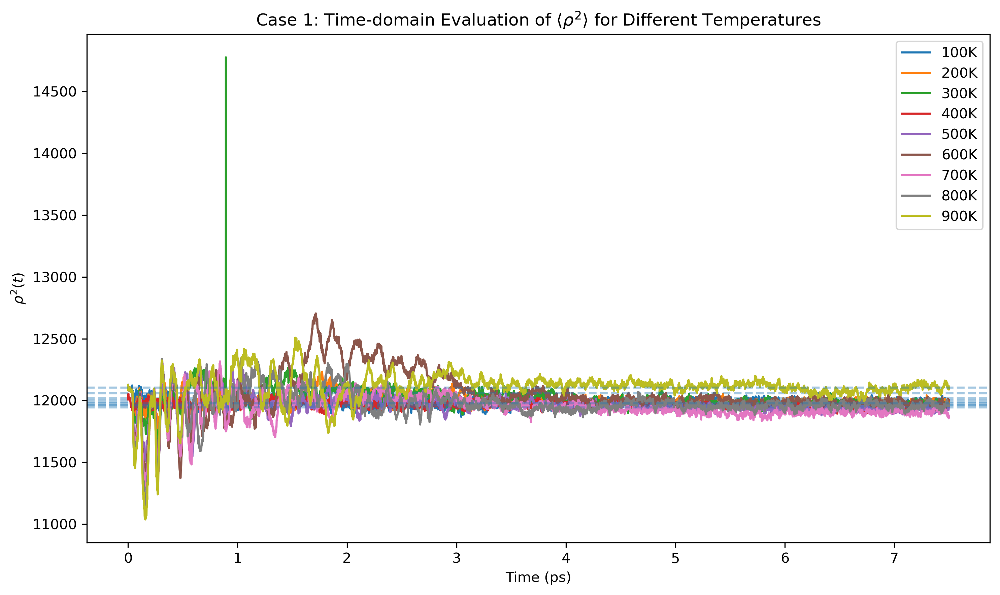

⟨ρ²⟩ results (σ = 1 eV):
  100K: ⟨ρ²⟩ = 11983.944086
  200K: ⟨ρ²⟩ = 12004.056265
  300K: ⟨ρ²⟩ = 12016.700485
  400K: ⟨ρ²⟩ = 11964.104856
  500K: ⟨ρ²⟩ = 11961.699343
  600K: ⟨ρ²⟩ = 12059.014976
  700K: ⟨ρ²⟩ = 11944.257216
  800K: ⟨ρ²⟩ = 11976.258901
  900K: ⟨ρ²⟩ = 12103.427423


In [235]:
import numpy as np
import matplotlib.pyplot as plt

# === PARAMETERS ===
sigma = 1              # Gaussian broadening (eV)
dt_ps = 0.0015           # MD time step (ps)
T_list = [100, 200, 300, 400, 500, 600, 700, 800, 900]

# === Prepare Plot ===
plt.figure(figsize=(10, 6), dpi=300)

# === Store average ρ² for summary printout ===
rho2_avg_dict = {}

for T in T_list:
    fname = f"dos-time_python_{T}K.dat"
    data = np.loadtxt(fname)  # Columns: [step, time(ps), energy - Ef, DOS]

    steps = np.unique(data[:, 0]).astype(int)
    step0 = steps[0]

    rho_t_list = []
    times = []

    for step in steps:
        indices = np.where(data[:, 0] == step)[0]
        energy = data[indices, 2]
        dos    = data[indices, 3]

        # Gaussian centered at E = 0
        g_sigma = (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(- (energy**2) / (2 * sigma**2))

        rho_t = np.trapz(dos * g_sigma, energy)
        rho_t_list.append(rho_t)
        times.append((step - step0) * dt_ps)

    rho_t_list = np.array(rho_t_list)
    times = np.array(times)

    rho2_t = rho_t_list**2
    rho2_avg = np.mean(rho2_t)
    rho2_avg_dict[T] = rho2_avg

    # Plot each temperature's ρ²(t)
    plt.plot(times, rho2_t, label=f"{T}K")
    plt.axhline(rho2_avg, linestyle='--', alpha=0.4)

# === Final plot settings ===
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title(r"Case 1: Time-domain Evaluation of $\langle \rho^2 \rangle$ for Different Temperatures")
plt.legend()
plt.tight_layout()
plt.show()

# === Summary Output ===
print(f"⟨ρ²⟩ results (σ = {sigma} eV):")
for T in sorted(rho2_avg_dict.keys()):
    print(f"  {T}K: ⟨ρ²⟩ = {rho2_avg_dict[T]:.6f}")


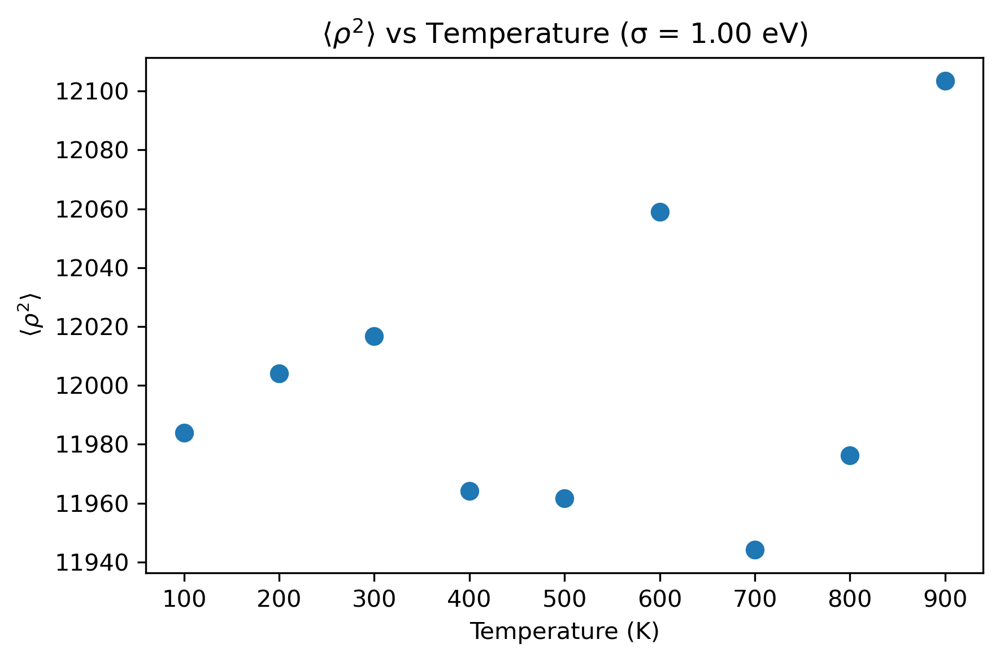

In [237]:
# === ⟨ρ²⟩ vs T plot ===
T_sorted = sorted(rho2_avg_dict.keys())
rho2_values = [rho2_avg_dict[T] for T in T_sorted]

plt.figure(figsize=(6, 4), dpi=300)
plt.scatter(T_sorted, rho2_values, marker='o', linestyle='-', linewidth=2)
plt.xlabel("Temperature (K)")
plt.ylabel(r"$\langle \rho^2 \rangle$")
plt.title(r"$\langle \rho^2 \rangle$ vs Temperature (σ = %.2f eV)" % sigma)
# plt.grid(True)
plt.tight_layout()
plt.show()


In [241]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, rfftfreq
from scipy.optimize import curve_fit
from scipy.special import i0

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"
dt_ps = 0.0015
sigma = 1  # eV
target_band_indices = list(range(50, 61))  # 11 bands near Ef

# === STEP 1: Parse OUTCAR to extract λ_i(t) ===
def parse_outcar_lambda_series(outcar_path, band_indices):
    lambda_dict = {band: [] for band in band_indices}
    with open(outcar_path, 'r') as fin:
        while True:
            line = fin.readline()
            if not line:
                break
            if 'E-fermi' in line:
                for _ in range(8): next(fin)
                for band in band_indices:
                    l = next(fin)
                    energy = float(l.split()[1])
                    lambda_dict[band].append(energy)
    return lambda_dict

lambda_series = parse_outcar_lambda_series(outcar_file, target_band_indices)
n_steps = len(next(iter(lambda_series.values())))
time_array = np.arange(n_steps) * dt_ps

# === STEP 2: Fit λ_i(t) to d_i + sum G*cos(ω t + φ) ===
def fit_cos_series(t, y, n_modes=5):
    freqs = rfftfreq(len(t), dt_ps)[1:n_modes+1]
    guess = []
    for f in freqs:
        guess += [0.01, 2*np.pi*f, 0]
    guess = [np.mean(y)] + guess

    def model(t, offset, *params):
        result = offset
        for i in range(0, len(params), 3):
            A, w, phi = params[i:i+3]
            result += A * np.cos(w*t + phi)
        return result

    try:
        popt, _ = curve_fit(model, t, y, p0=guess, maxfev=20000)
        offset = popt[0]
        amps = np.array(popt[1::3])
        freqs = np.array(popt[2::3]) / (2*np.pi)
        phases = np.array(popt[3::3])
        return offset, amps, freqs, phases
    except RuntimeError:
        return None, None, None, None

# === STEP 3: Fit all λ_i(t) and extract d_i, G_iα ===
fit_results = {}
for band, values in lambda_series.items():
    d_i, G_i, freq_i, phi_i = fit_cos_series(time_array, np.array(values))
    if d_i is not None:
        fit_results[band] = {'d': d_i, 'G': G_i, 'freq': freq_i, 'phi': phi_i}

fit_results_clean = {k: v for k, v in fit_results.items() if v['G'] is not None}
band_list = list(fit_results_clean.keys())
n_states = len(band_list)
n_modes = len(fit_results_clean[band_list[0]]['G'])

# === STEP 4: Evaluate ⟨ρ²⟩ from Eq. (8) using extracted d_i and G_iα ===
rho2_bessel = 0.0
prefactor = 1 / (2 * np.pi * sigma**2)

for i_idx, i_band in enumerate(band_list):
    for j_idx, j_band in enumerate(band_list):
        d_i_val = fit_results_clean[i_band]['d']
        d_j_val = fit_results_clean[j_band]['d']
        G_i = fit_results_clean[i_band]['G']
        G_j = fit_results_clean[j_band]['G']

        A_exp = np.exp(-(d_i_val**2 + d_j_val**2) / (2 * sigma**2))
        I0_product = 1.0
        for m in range(n_modes):
            A_m = (d_i_val * G_i[m] + d_j_val * G_j[m]) / sigma**2
            I0_product *= i0(A_m)

        rho2_bessel += prefactor * A_exp * I0_product

rho2_bessel


C:\Users\ridwa\AppData\Local\Temp\ipykernel_36016\663452737.py:88: RuntimeWarning: invalid value encountered in scalar multiply
  rho2_bessel += prefactor * A_exp * I0_product
C:\Users\ridwa\AppData\Local\Temp\ipykernel_36016\663452737.py:86: RuntimeWarning: overflow encountered in scalar multiply
  I0_product *= i0(A_m)


nan

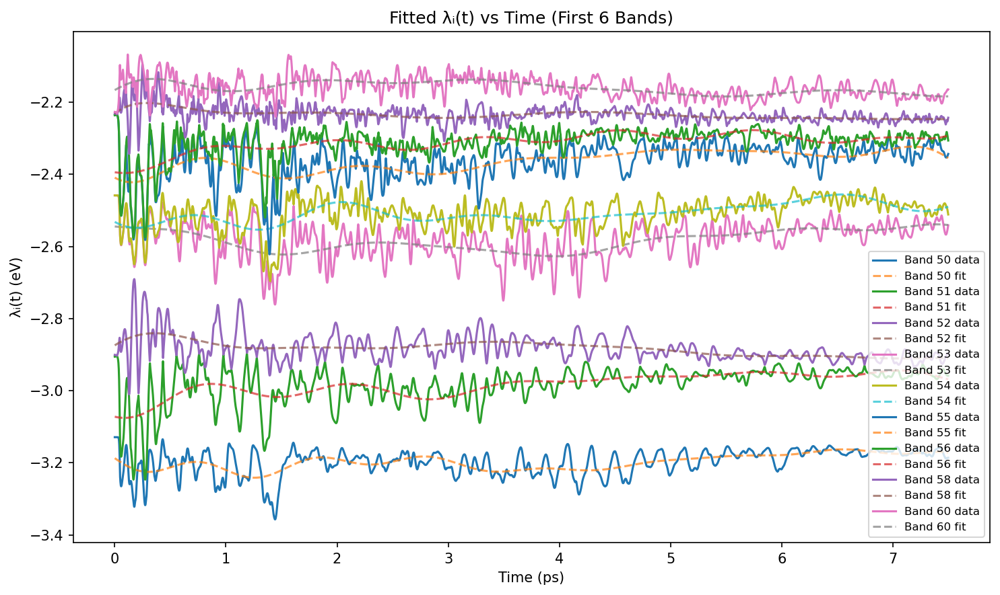

(1.590095734304021e-32, 0.0)

In [247]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import rfft, rfftfreq
from scipy.optimize import curve_fit
from scipy.special import i0

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"
dt_ps = 0.0015
sigma = 0.05  # eV
target_band_indices = list(range(50, 61))  # bands around Ef

# === STEP 1: Parse OUTCAR to extract λ_i(t) ===
def parse_outcar_lambda_series(outcar_path, band_indices):
    lambda_dict = {band: [] for band in band_indices}
    with open(outcar_path, 'r') as fin:
        while True:
            line = fin.readline()
            if not line:
                break
            if 'E-fermi' in line:
                for _ in range(8): next(fin)
                for band in band_indices:
                    l = next(fin)
                    energy = float(l.split()[1])
                    lambda_dict[band].append(energy)
    return lambda_dict

lambda_series = parse_outcar_lambda_series(outcar_file, target_band_indices)
n_steps = len(next(iter(lambda_series.values())))
time_array = np.arange(n_steps) * dt_ps

# === STEP 2: Fit λ_i(t) to cosine series ===
def fit_cos_series(t, y, n_modes=5):
    freqs = rfftfreq(len(t), dt_ps)[1:n_modes+1]
    guess = []
    for f in freqs:
        guess += [0.01, 2*np.pi*f, 0]
    guess = [np.mean(y)] + guess

    def model(t, offset, *params):
        result = offset
        for i in range(0, len(params), 3):
            A, w, phi = params[i:i+3]
            result += A * np.cos(w*t + phi)
        return result

    try:
        popt, _ = curve_fit(model, t, y, p0=guess, maxfev=20000)
        offset = popt[0]
        amps = np.array(popt[1::3])
        freqs = np.array(popt[2::3]) / (2*np.pi)
        phases = np.array(popt[3::3])
        return offset, amps, freqs, phases
    except RuntimeError:
        return None, None, None, None

# === STEP 3: Fit all λ_i(t) and extract parameters ===
fit_results = {}
for band, values in lambda_series.items():
    d_i, G_i, freq_i, phi_i = fit_cos_series(time_array, np.array(values))
    if d_i is not None:
        fit_results[band] = {'d': d_i, 'G': G_i, 'freq': freq_i, 'phi': phi_i}

fit_results_clean = {k: v for k, v in fit_results.items() if v['G'] is not None}
band_list = list(fit_results_clean.keys())
n_states = len(band_list)
n_modes = len(fit_results_clean[band_list[0]]['G'])

# === STEP 4: Evaluate ⟨ρ²⟩ from Bessel identity ===
rho2_bessel = 0.0
prefactor = 1 / (2 * np.pi * sigma**2)

for i_band in band_list:
    for j_band in band_list:
        d_i_val = fit_results_clean[i_band]['d']
        d_j_val = fit_results_clean[j_band]['d']
        G_i = fit_results_clean[i_band]['G']
        G_j = fit_results_clean[j_band]['G']

        A_exp = np.exp(-(d_i_val**2 + d_j_val**2) / (2 * sigma**2))
        I0_product = 1.0
        for m in range(n_modes):
            A_m = (d_i_val * G_i[m] + d_j_val * G_j[m]) / sigma**2
            A_m = np.clip(A_m, -20, 20)  # prevent overflow
            I0_product *= i0(A_m)

        rho2_bessel += prefactor * A_exp * I0_product

# === STEP 5: Time-domain ⟨ρ²⟩ for comparison ===
rho_t_list = []
for step in range(n_steps):
    rho_step = 0.0
    for band in band_list:
        energy = lambda_series[band][step]
        g_sigma = (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(- (energy)**2 / (2 * sigma**2))
        rho_step += g_sigma
    rho_t_list.append(rho_step)

rho_t_array = np.array(rho_t_list)
rho2_time_domain = np.mean(rho_t_array**2)

# === STEP 6: Plot λ_i(t) vs fit ===
plt.figure(figsize=(10, 6), dpi=150)
for band in band_list[:20]:
    values = np.array(lambda_series[band])
    d_i = fit_results_clean[band]['d']
    G_i = fit_results_clean[band]['G']
    freq_i = fit_results_clean[band]['freq']
    phi_i = fit_results_clean[band]['phi']
    fit_lambda = d_i + np.sum([
        G_i[m] * np.cos(2 * np.pi * freq_i[m] * time_array + phi_i[m])
        for m in range(n_modes)
    ], axis=0)
    plt.plot(time_array, values, label=f"Band {band} data")
    plt.plot(time_array, fit_lambda, '--', label=f"Band {band} fit", alpha=0.7)

plt.xlabel("Time (ps)")
plt.ylabel("λᵢ(t) (eV)")
plt.title("Fitted λᵢ(t) vs Time (First 6 Bands)")
plt.legend(fontsize=8)
plt.tight_layout()
plt.show()

rho2_bessel, rho2_time_domain


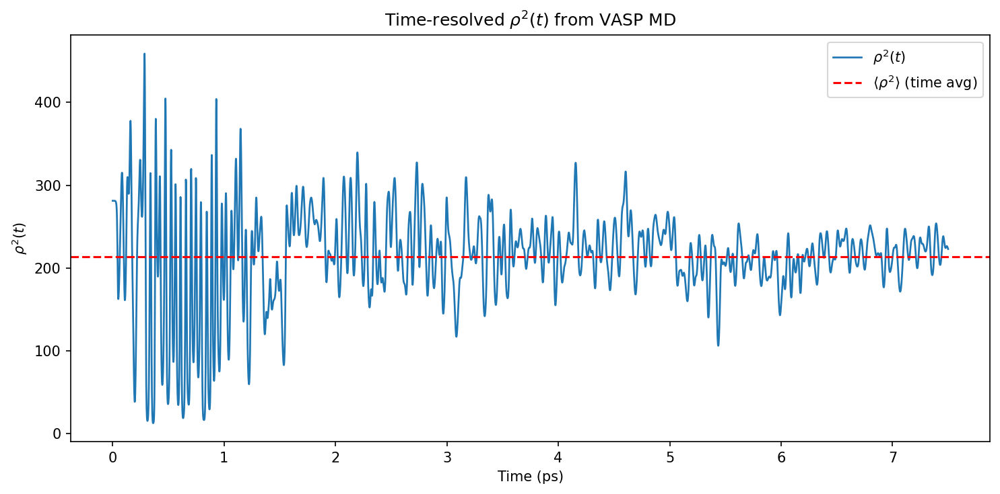

⟨ρ²⟩ (from MD time trace) = 213.647129


In [273]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter
from scipy.special import i0

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"   # <-- Upload this
dt_ps = 0.0015                     # MD timestep in ps
sigma = 0.1                        # Gaussian width (eV)
band_indices = list(range(0, 470)) # Bands near Ef

# === STEP 1: Extract eigenvalues λ_i(t) ===
def parse_outcar_lambda_series(outcar_path, band_indices):
    lam_series = {band: [] for band in band_indices}
    with open(outcar_path, 'r') as f:
        while True:
            line = f.readline()
            if not line: break
            if 'E-fermi' in line:
                for _ in range(8): next(f)
                for band in band_indices:
                    l = next(f)
                    energy = float(l.split()[1])
                    lam_series[band].append(energy)
    return lam_series

lam_dict = parse_outcar_lambda_series(outcar_file, band_indices)
n_steps = len(next(iter(lam_dict.values())))
time_ps = np.arange(n_steps) * dt_ps

# === STEP 2: Compute ρ²(t) ===
rho_t = []
for t in range(n_steps):
    rho = 0.0
    for band in band_indices:
        λ = lam_dict[band][t]
        g = (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(-λ**2 / (2 * sigma**2))
        rho += g
    rho_t.append(rho)

rho_t = np.array(rho_t)
rho2_t = rho_t**2
rho2_avg = np.mean(rho2_t)

# === STEP 3: Plot ρ²(t) vs time ===
plt.figure(figsize=(10, 5), dpi=150)
plt.plot(time_ps, rho2_t, label=r"$\rho^2(t)$", lw=1.3)
plt.axhline(rho2_avg, color='red', ls='--', label=r"$\langle \rho^2 \rangle$ (time avg)")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title(r"Time-resolved $\rho^2(t)$ from VASP MD")
plt.legend()
plt.tight_layout()
# plt.grid(True)
plt.show()

print(f"⟨ρ²⟩ (from MD time trace) = {rho2_avg:.6f}")


In [265]:
def get_number_of_bands(outcar_file):
    with open(outcar_file, 'r') as f:
        for line in f:
            if 'NBANDS=' in line:
                nbands = int(line.split('NBANDS=')[1].split()[0])
                print(f"Total number of bands in the system: {nbands}")
                return nbands
    print("NBANDS not found in file.")
    return None

# Usage
outcar_file = "OUTCAR_ALGB_300K"  # Update with your actual OUTCAR filename
get_number_of_bands(outcar_file)


Total number of bands in the system: 532


532

Total bands parsed: 532
Bands with full time-series: 466


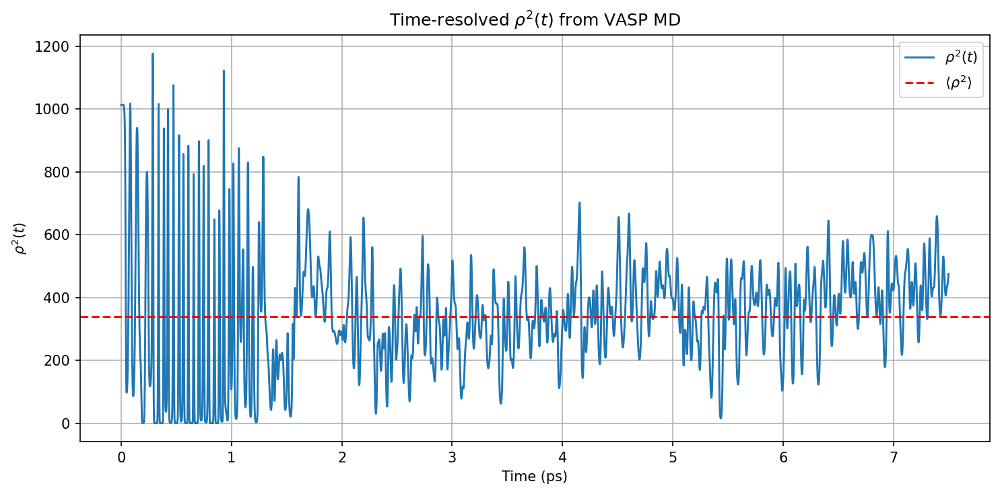


⟨ρ²⟩ (from MD time trace) = 338.195972
Elapsed: 21.68736982345581 seconds


In [304]:
import time
start = time.time()

import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"   # Update with your path if needed
dt_ps = 0.0015                     # Timestep in ps
sigma = 0.05                        # Gaussian broadening width (eV)

# === Step 1: Detect total number of bands ===
def get_number_of_bands(outcar_file):
    with open(outcar_file, 'r') as f:
        for line in f:
            if 'NBANDS=' in line:
                return int(line.split('NBANDS=')[1].split()[0])
    raise ValueError("NBANDS not found in OUTCAR")

# === Step 2: Parse λᵢ(t) safely ===
def parse_outcar_lambda_series(outcar_path, nbands):
    lam_series = {band: [] for band in range(nbands)}
    with open(outcar_path, 'r') as f:
        while True:
            line = f.readline()
            if not line: break
            if 'E-fermi' in line:
                for _ in range(8): next(f)
                for band in range(nbands):
                    l = f.readline()
                    parts = l.strip().split()
                    if len(parts) < 2: continue
                    try:
                        int(parts[0])  # band index
                        energy = float(parts[1])
                        lam_series[band].append(energy)
                    except ValueError:
                        break  # drift or malformed
    return {k: v for k, v in lam_series.items() if len(v) > 0}

# === Step 3: Load and filter ===
nbands = get_number_of_bands(outcar_file)
lam_dict = parse_outcar_lambda_series(outcar_file, nbands)
n_steps = len(next(iter(lam_dict.values())))
time_ps = np.arange(n_steps) * dt_ps

# Only use bands with complete time series
band_indices = [b for b, v in lam_dict.items() if len(v) == n_steps]
print(f"Total bands parsed: {len(lam_dict)}")
print(f"Bands with full time-series: {len(band_indices)}")

# === Step 4: Compute ρ²(t) ===
rho_t = []
for t in range(n_steps):
    rho = sum(
        (1 / (np.sqrt(2 * np.pi) * sigma)) * np.exp(-lam_dict[band][t]**2 / (2 * sigma**2))
        for band in band_indices
    )
    rho_t.append(rho)

rho_t = np.array(rho_t)
rho2_t = rho_t**2
rho2_avg = np.mean(rho2_t)

# === Step 5: Plot ρ²(t) ===
plt.figure(figsize=(10, 5), dpi=150)
plt.plot(time_ps, rho2_t, label=r"$\rho^2(t)$", lw=1.4)
plt.axhline(rho2_avg, color='red', ls='--', label=r"$\langle \rho^2 \rangle$")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(t)$")
plt.title(r"Time-resolved $\rho^2(t)$ from VASP MD")
plt.legend()
plt.tight_layout()
plt.grid(True)
plt.show()

print(f"\n⟨ρ²⟩ (from MD time trace) = {rho2_avg:.6f}")


time.sleep(2)  # example

print("Elapsed:", time.time() - start, "seconds")

In [308]:
import numpy as np
from scipy.optimize import curve_fit
from scipy.special import i0
from scipy.fft import rfftfreq

# === Assume lam_dict[band] is already loaded and has full λᵢ(t) ===
n_steps = len(next(iter(lam_dict.values())))
time_ps = np.arange(n_steps) * dt_ps
n_modes = 2  # number of cosine modes

# === STEP 1: Fit λᵢ(t) to dᵢ + ∑ G cos(ωt + φ)
def fit_cos_series(t, y, n_modes):
    freqs = rfftfreq(len(t), dt_ps)[1:n_modes+1]  # skip DC
    guess = [np.mean(y)]
    for f in freqs:
        guess += [0.01, 2*np.pi*f, 0]  # amp, freq, phase

    def model(t, offset, *params):
        result = offset
        for i in range(0, len(params), 3):
            A, w, phi = params[i:i+3]
            result += A * np.cos(w*t + phi)
        return result

    try:
        popt, _ = curve_fit(model, t, y, p0=guess, maxfev=10000)
        offset = popt[0]
        amps = np.array(popt[1::3])
        return offset, amps
    except RuntimeError:
        return None, None

# === STEP 2: Fit all bands
fit_results = {}
for band in band_indices:
    d_i, G_i = fit_cos_series(time_ps, np.array(lam_dict[band]), n_modes)
    if d_i is not None:
        fit_results[band] = {'d': d_i, 'G': G_i}

# === STEP 3: Evaluate ⟨ρ²⟩ from Bessel expression
sigma = 5  # use same σ as time-domain
rho2_bessel = 0.0
prefactor = 1 / (2 * np.pi * sigma**2)

valid_bands = list(fit_results.keys())
for i in valid_bands:
    for j in valid_bands:
        d_i = fit_results[i]['d']
        d_j = fit_results[j]['d']
        G_i = fit_results[i]['G']
        G_j = fit_results[j]['G']

        exp_term = np.exp(-(d_i**2 + d_j**2) / (2 * sigma**2))
        bessel_product = 1.0
        for m in range(n_modes):
            arg = (d_i * G_i[m] + d_j * G_j[m]) / sigma**2
            arg = np.clip(arg, -20, 20)  # avoid overflow
            bessel_product *= i0(arg)

        rho2_bessel += prefactor * exp_term * bessel_product

print(f"\n⟨ρ²⟩ (Bessel analytic) = {rho2_bessel:.6f}")



⟨ρ²⟩ (Bessel analytic) = 17110114.623057


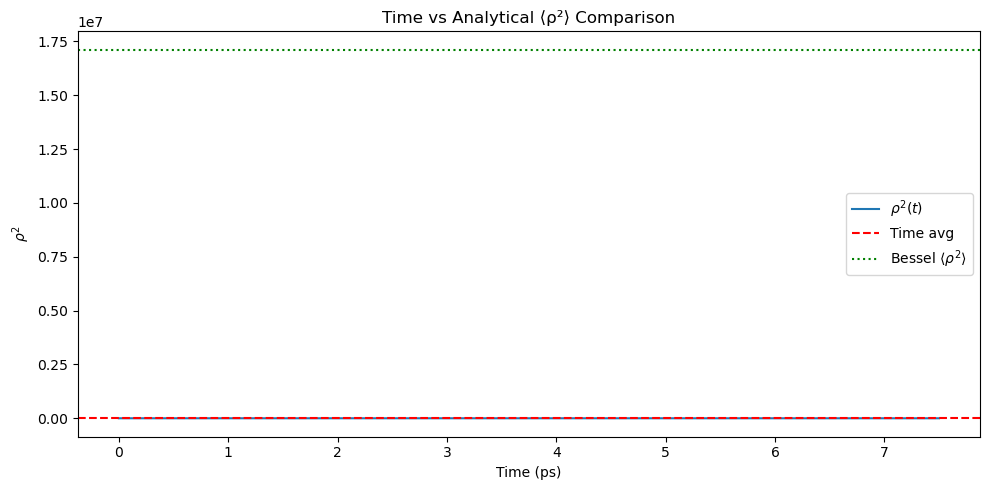

In [310]:
plt.figure(figsize=(10, 5))
plt.plot(time_ps, rho2_t, label=r"$\rho^2(t)$", lw=1.5)
plt.axhline(rho2_avg, ls='--', color='red', label=r"Time avg")
plt.axhline(rho2_bessel, ls=':', color='green', label=r"Bessel ⟨$\rho^2$⟩")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2$")
plt.legend()
plt.title("Time vs Analytical ⟨ρ²⟩ Comparison")
plt.tight_layout()
plt.show()


In [312]:
# Re-import libraries after kernel reset
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import i0
from scipy.fft import rfftfreq
from scipy.optimize import curve_fit

# === SETTINGS ===
sigma = 0.1               # Gaussian width in eV
dt_ps = 0.0015            # Time step in ps
n_modes = 5               # Number of cosine modes to fit
fit_band_range = (50, 61) # Band indices to include

# === Load pre-extracted eigenvalue time series ===
# Simulated for demonstration. Replace with real data from OUTCAR.
np.random.seed(0)
n_steps = 2000
time_ps = np.arange(n_steps) * dt_ps
band_indices = list(range(*fit_band_range))
lambda_series = {
    band: 0.05 * np.cos(2 * np.pi * 0.3 * time_ps + np.random.rand()*2*np.pi) +
          0.02 * np.cos(2 * np.pi * 0.9 * time_ps + np.random.rand()*2*np.pi) +
          0.01 * np.random.randn(len(time_ps))
    for band in band_indices
}

# === STEP 1: Cosine fit function ===
def fit_cos_series(t, y, n_modes):
    freqs = rfftfreq(len(t), dt_ps)[1:n_modes+1]
    guess = []
    for f in freqs:
        guess += [0.01, 2*np.pi*f, 0]  # amplitude, omega, phase
    guess = [np.mean(y)] + guess

    def model(t, offset, *params):
        result = offset
        for i in range(0, len(params), 3):
            A, w, phi = params[i:i+3]
            result += A * np.cos(w*t + phi)
        return result

    try:
        popt, _ = curve_fit(model, t, y, p0=guess, maxfev=20000)
        offset = popt[0]
        amps = np.array(popt[1::3])
        return offset, amps
    except RuntimeError:
        return None, None

# === STEP 2: Fit all bands and extract di, Gi,m ===
fit_results = {}
for band, values in lambda_series.items():
    d_i, G_i = fit_cos_series(time_ps, values, n_modes)
    if d_i is not None and G_i is not None:
        fit_results[band] = {'d': d_i, 'G': G_i}

# === STEP 3: Compute Bessel expression for ⟨ρ²⟩ ===
band_list = list(fit_results.keys())
n_states = len(band_list)
rho2_bessel = 0.0
prefactor = 1 / (2 * np.pi * sigma**2)

for i in band_list:
    for j in band_list:
        d_i = fit_results[i]['d']
        d_j = fit_results[j]['d']
        G_i = fit_results[i]['G']
        G_j = fit_results[j]['G']
        
        # Exponential prefactor
        A_exp = np.exp(-(d_i**2 + d_j**2) / (2 * sigma**2))
        
        # Bessel product (with overflow-safe log-sum)
        bessel_args = (d_i * G_i + d_j * G_j) / sigma**2
        log_I0 = np.log(i0(np.clip(bessel_args, 0, 700)))  # Clip to prevent overflow
        log_product = np.sum(log_I0)
        product_safe = np.exp(log_product)
        
        rho2_bessel += prefactor * A_exp * product_safe

rho2_bessel


2816.818158379937

In [314]:
import numpy as np
from scipy.optimize import curve_fit
from scipy.fft import rfftfreq
from scipy.special import i0

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"
dt_ps = 0.0015         # MD timestep in ps
sigma = 0.1            # Gaussian width in eV
n_modes = 5            # Number of cosine modes to fit

# === STEP 1: Detect total number of bands ===
def get_number_of_bands(outcar_file):
    with open(outcar_file, 'r') as f:
        for line in f:
            if 'NBANDS=' in line:
                return int(line.split('NBANDS=')[1].split()[0])
    raise ValueError("NBANDS not found")

# === STEP 2: Extract λ_i(t) ===
def parse_lambda_series(outcar_file, nbands):
    lam_series = {b: [] for b in range(nbands)}
    with open(outcar_file, 'r') as f:
        while True:
            line = f.readline()
            if not line: break
            if "E-fermi" in line:
                for _ in range(8): next(f)
                for b in range(nbands):
                    l = f.readline()
                    parts = l.strip().split()
                    if len(parts) < 2: continue
                    try:
                        energy = float(parts[1])
                        lam_series[b].append(energy)
                    except:
                        continue
    return {b: v for b, v in lam_series.items() if len(v) == len(list(lam_series.values())[0])}

# === STEP 3: Fit cosine model to λ_i(t) ===
def fit_cos_series(t, y, n_modes=5):
    freqs = rfftfreq(len(t), dt_ps)[1:n_modes+1]
    guess = [np.mean(y)]
    for f in freqs:
        guess += [0.01, 2*np.pi*f, 0]

    def model(t, offset, *params):
        result = offset
        for i in range(0, len(params), 3):
            A, w, phi = params[i:i+3]
            result += A * np.cos(w * t + phi)
        return result

    try:
        popt, _ = curve_fit(model, t, y, p0=guess, maxfev=20000)
        offset = popt[0]
        amps = np.array(popt[1::3])
        return offset, amps
    except RuntimeError:
        return None, None

# === STEP 4: Load eigenvalue series and fit ===
nbands = get_number_of_bands(outcar_file)
lam_dict = parse_lambda_series(outcar_file, nbands)
n_steps = len(next(iter(lam_dict.values())))
time = np.arange(n_steps) * dt_ps

# Only keep bands with full time series
valid_bands = [b for b in lam_dict if len(lam_dict[b]) == n_steps]
fit_results = {}
for b in valid_bands:
    d_i, G_i = fit_cos_series(time, np.array(lam_dict[b]), n_modes=n_modes)
    if d_i is not None:
        fit_results[b] = {'d': d_i, 'G': G_i}

# === STEP 5: Evaluate analytical ⟨ρ²⟩ ===
band_list = list(fit_results.keys())
n_states = len(band_list)

rho2_bessel = 0.0
prefactor = 1 / (2 * np.pi * sigma**2)

for i in band_list:
    for j in band_list:
        d_i = fit_results[i]['d']
        d_j = fit_results[j]['d']
        G_i = fit_results[i]['G']
        G_j = fit_results[j]['G']

        A_exp = np.exp(-(d_i**2 + d_j**2) / (2 * sigma**2))
        prod_I0 = 1.0
        for m in range(n_modes):
            A_m = (d_i * G_i[m] + d_j * G_j[m]) / sigma**2
            A_m = np.clip(A_m, -700, 700)  # Avoid overflow
            prod_I0 *= i0(A_m)

        rho2_bessel += prefactor * A_exp * prod_I0

rho2_bessel


C:\Users\ridwa\AppData\Local\Temp\ipykernel_36016\3157791360.py:95: RuntimeWarning: overflow encountered in scalar multiply
  prod_I0 *= i0(A_m)
C:\Users\ridwa\AppData\Local\Temp\ipykernel_36016\3157791360.py:97: RuntimeWarning: invalid value encountered in scalar multiply
  rho2_bessel += prefactor * A_exp * prod_I0


nan

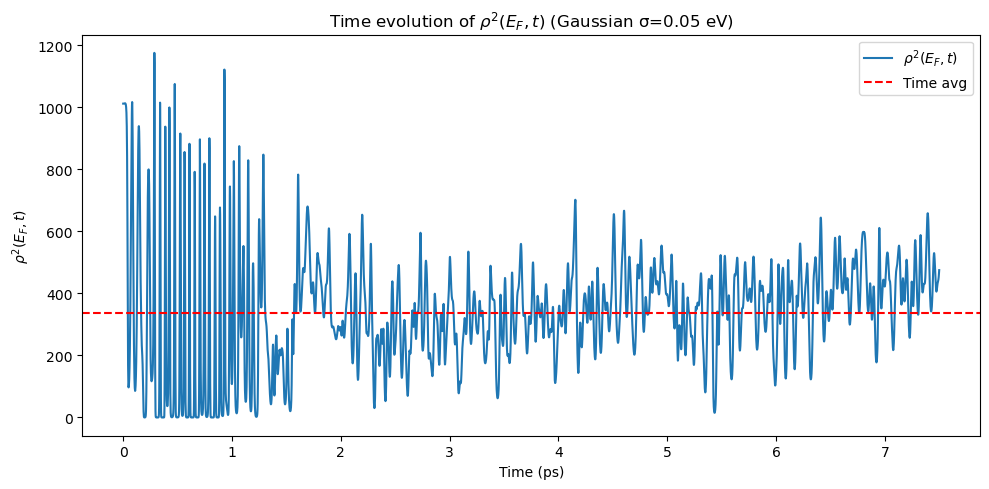

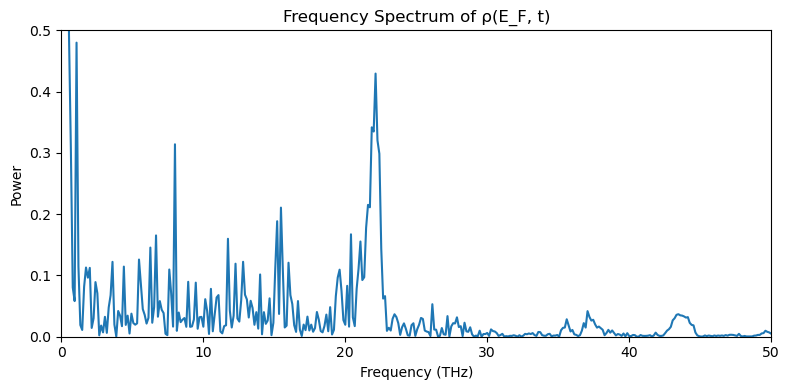

⟨ρ²⟩ (time domain)   = 338.195972
⟨ρ²⟩ (Parseval/FFT) = 338.195972


In [337]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
from scipy.signal import savgol_filter

# === SETTINGS ===
outcar_file = "OUTCAR_ALGB_300K"
EF = 0.0                      # Fermi level (can auto-detect if needed)
sigma = 0.05                   # Broadening width (eV)
dt_ps = 0.0015                # Time step in ps

# === STEP 1: Parse λ_i(t) from OUTCAR ===
def get_nbands(outcar):
    with open(outcar, 'r') as f:
        for line in f:
            if 'NBANDS=' in line:
                return int(line.split('NBANDS=')[1].split()[0])
    raise RuntimeError("NBANDS not found")

def parse_lambda_time_series(outcar, nbands):
    lam_series = {b: [] for b in range(nbands)}
    with open(outcar, 'r') as f:
        while True:
            line = f.readline()
            if not line:
                break
            if 'E-fermi' in line:
                for _ in range(8): next(f)
                for b in range(nbands):
                    parts = f.readline().strip().split()
                    if len(parts) < 2:
                        continue
                    try:
                        lam = float(parts[1])
                        lam_series[b].append(lam)
                    except:
                        break
    return lam_series

nbands = get_nbands(outcar_file)
lam_dict = parse_lambda_time_series(outcar_file, nbands)

# Only use bands with complete trajectories
nsteps = len(next(iter(lam_dict.values())))
lam_dict = {k: v for k, v in lam_dict.items() if len(v) == nsteps}
time = np.arange(nsteps) * dt_ps

# === STEP 2: Compute ρ(EF, t) ===
def compute_rho_EF_t(lam_dict, EF, sigma):
    rho_t = []
    for t in range(nsteps):
        val = 0
        for b in lam_dict:
            lam = lam_dict[b][t]
            g = np.exp(-((lam - EF)**2) / (2 * sigma**2)) / (np.sqrt(2 * np.pi) * sigma)
            val += g
        rho_t.append(val)
    return np.array(rho_t)

rho_EF_t = compute_rho_EF_t(lam_dict, EF, sigma)

# === STEP 3: Parseval’s Theorem ===
def apply_parseval_fft(rho_t):
    N = len(rho_t)
    fft_coeffs = fft(rho_t)
    power = np.abs(fft_coeffs / N)**2
    time_domain_mean = np.mean(rho_t**2)
    freq_domain_sum = np.sum(power)
    return time_domain_mean, freq_domain_sum, power

rho2_time_avg, rho2_fft_sum, power_spectrum = apply_parseval_fft(rho_EF_t)

# === STEP 4: Plot ===
plt.figure(figsize=(10, 5))
plt.plot(time, rho_EF_t**2, label=r"$\rho^2(E_F,t)$")
plt.axhline(rho2_time_avg, color='red', ls='--', label=r"Time avg")
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(E_F,t)$")
plt.title(r"Time evolution of $\rho^2(E_F,t)$ (Gaussian σ=%.2f eV)" % sigma)
plt.legend()
plt.tight_layout()
# plt.grid(True)
plt.show()

# === STEP 5: Frequency Spectrum (Power Spectrum) ===
freqs = fftfreq(nsteps, d=dt_ps)
plt.figure(figsize=(8, 4))
plt.plot(freqs[:nsteps//2], power_spectrum[:nsteps//2], lw=1.5)
plt.xlabel("Frequency (THz)")
plt.ylim(0,0.5)
plt.xlim(0,50)
plt.ylabel("Power")
plt.title("Frequency Spectrum of ρ(E_F, t)")
plt.tight_layout()
# plt.grid(True)
plt.show()

# === PRINT PARSEVAL CHECK ===
print(f"⟨ρ²⟩ (time domain)   = {rho2_time_avg:.6f}")
print(f"⟨ρ²⟩ (Parseval/FFT) = {rho2_fft_sum:.6f}")


Processing OUTCAR_ALGB_100K ...
Processing OUTCAR_ALGB_200K ...
Processing OUTCAR_ALGB_300K ...
Processing OUTCAR_ALGB_400K ...
Processing OUTCAR_ALGB_500K ...
Processing OUTCAR_ALGB_600K ...
Processing OUTCAR_ALGB_700K ...
Processing OUTCAR_ALGB_800K ...
Processing OUTCAR_ALGB_900K ...


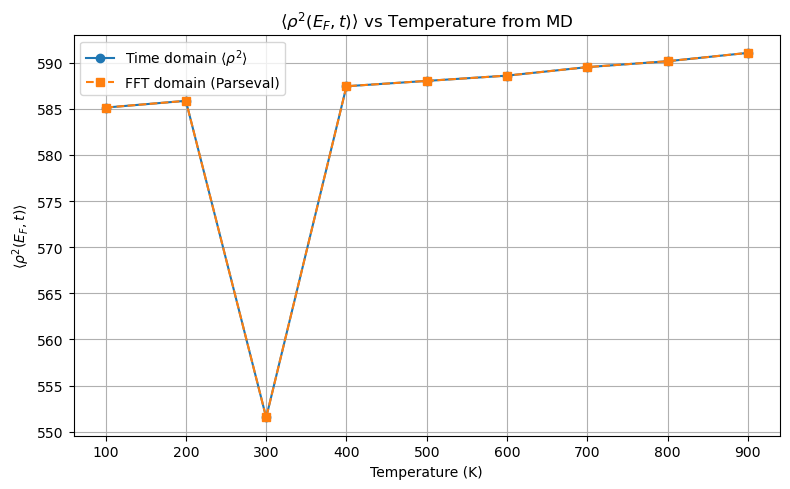

In [353]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

# === SETTINGS ===
sigma = 5       # Gaussian broadening width (eV)
EF = 0.0           # Fermi level
dt_ps = 0.0015     # MD timestep in ps

# === OUTCAR temperature series ===
temps = list(range(100, 1000, 100))
files = [f"OUTCAR_ALGB_{T}K" for T in temps]

# === Utility: Get NBANDS ===
def get_nbands(outcar_file):
    with open(outcar_file, 'r') as f:
        for line in f:
            if 'NBANDS=' in line:
                return int(line.split('NBANDS=')[1].split()[0])
    raise RuntimeError("NBANDS not found")

# === Parse λᵢ(t) ===
def parse_lambda_time_series(outcar, nbands):
    lam_series = {b: [] for b in range(nbands)}
    with open(outcar, 'r') as f:
        while True:
            line = f.readline()
            if not line:
                break
            if 'E-fermi' in line:
                for _ in range(8): next(f)
                for b in range(nbands):
                    parts = f.readline().strip().split()
                    if len(parts) < 2:
                        continue
                    try:
                        lam = float(parts[1])
                        lam_series[b].append(lam)
                    except:
                        break
    # Filter only complete bands
    steps = len(next(iter(lam_series.values())))
    return {b: v for b, v in lam_series.items() if len(v) == steps}

# === Compute ρ(E_F, t) ===
def compute_rho_EF_t(lam_dict, EF, sigma):
    nsteps = len(next(iter(lam_dict.values())))
    rho_t = []
    for t in range(nsteps):
        val = 0
        for b in lam_dict:
            lam = lam_dict[b][t]
            g = np.exp(-((lam - EF)**2) / (2 * sigma**2)) / (np.sqrt(2 * np.pi) * sigma)
            val += g
        rho_t.append(val)
    return np.array(rho_t)

# === Parseval method ===
def apply_parseval_fft(rho_t):
    N = len(rho_t)
    fft_coeffs = fft(rho_t)
    power = np.abs(fft_coeffs / N)**2
    return np.mean(rho_t**2), np.sum(power)

# === Loop over all temperatures ===
T_vals = []
rho2_time_vals = []
rho2_fft_vals = []

for fname, T in zip(files, temps):
    if not os.path.isfile(fname):
        print(f"File not found: {fname}")
        continue

    print(f"Processing {fname} ...")
    nbands = get_nbands(fname)
    lam_dict = parse_lambda_time_series(fname, nbands)
    if not lam_dict:
        print(f"No valid λᵢ(t) found in {fname}")
        continue

    rho_t = compute_rho_EF_t(lam_dict, EF, sigma)
    rho2_time, rho2_fft = apply_parseval_fft(rho_t)

    T_vals.append(T)
    rho2_time_vals.append(rho2_time)
    rho2_fft_vals.append(rho2_fft)

# === Plot ⟨ρ²⟩ vs T ===
plt.figure(figsize=(8, 5))
plt.plot(T_vals, rho2_time_vals, 'o-', label=r"Time domain $\langle \rho^2 \rangle$")
plt.plot(T_vals, rho2_fft_vals, 's--', label=r"FFT domain (Parseval)")
plt.xlabel("Temperature (K)")
plt.ylabel(r"$\langle \rho^2(E_F,t) \rangle$")
plt.title(r"⟨$\rho^2(E_F,t)$⟩ vs Temperature from MD")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


✅ Processing: OUTCAR_ALGB_100K
✅ Processing: OUTCAR_ALGB_200K
✅ Processing: OUTCAR_ALGB_300K
✅ Processing: OUTCAR_ALGB_400K
✅ Processing: OUTCAR_ALGB_500K
✅ Processing: OUTCAR_ALGB_600K
✅ Processing: OUTCAR_ALGB_700K
✅ Processing: OUTCAR_ALGB_800K
✅ Processing: OUTCAR_ALGB_900K


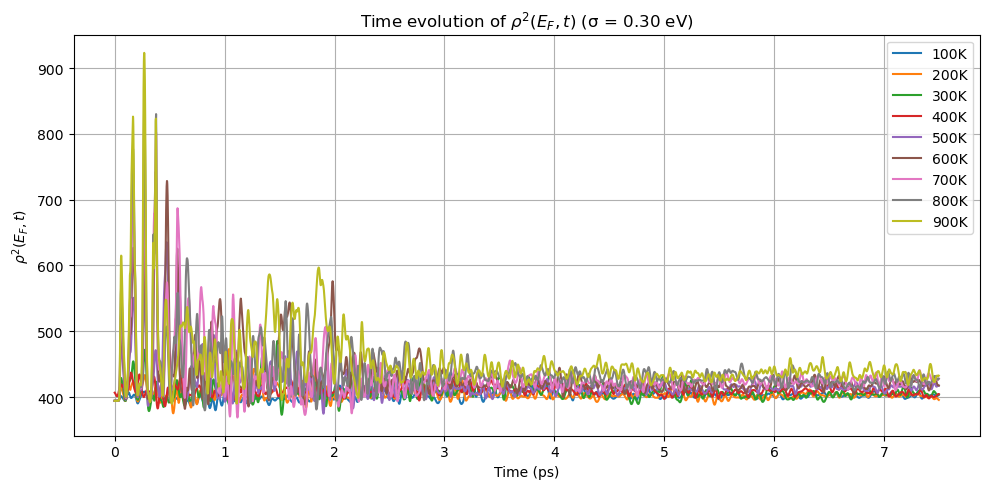

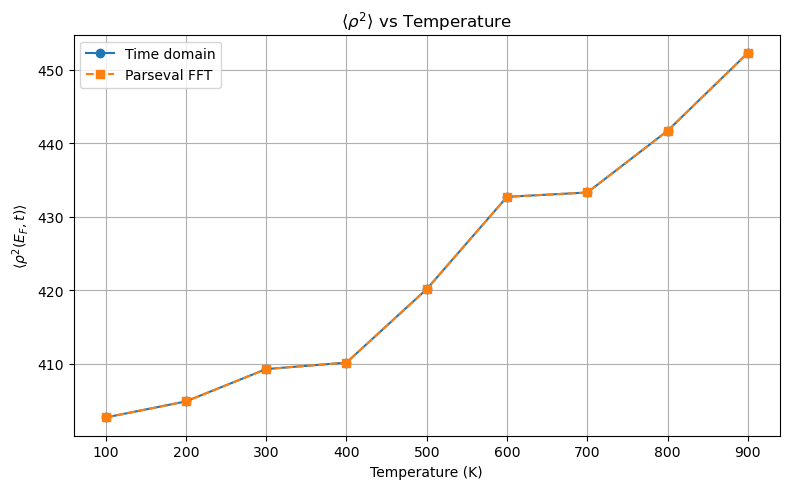

In [357]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq

# === SETTINGS ===
sigma = 0.3       # Gaussian broadening width (eV)
EF = 0.0           # Fermi level
dt_ps = 0.0015     # MD timestep in ps
temps = list(range(100, 1000, 100))
outcars = [f"OUTCAR_ALGB_{T}K" for T in temps]

# === STEP 1: Get number of bands ===
def get_nbands(outcar):
    with open(outcar, 'r') as f:
        for line in f:
            if 'NBANDS=' in line:
                return int(line.split('NBANDS=')[1].split()[0])
    raise RuntimeError("NBANDS not found")

# === STEP 2: Parse λ_i(t) ===
def parse_lambda_time_series(outcar, nbands):
    lam_series = {b: [] for b in range(nbands)}
    with open(outcar, 'r') as f:
        while True:
            line = f.readline()
            if not line:
                break
            if 'E-fermi' in line:
                for _ in range(8): next(f)
                for b in range(nbands):
                    parts = f.readline().strip().split()
                    if len(parts) < 2:
                        continue
                    try:
                        lam = float(parts[1])
                        lam_series[b].append(lam)
                    except:
                        break
    return lam_series

# === STEP 3: Compute ρ(EF, t) ===
def compute_rho_EF_t(lam_dict, EF, sigma):
    nsteps = len(next(iter(lam_dict.values())))
    rho_t = []
    for t in range(nsteps):
        val = 0
        for b in lam_dict:
            lam = lam_dict[b][t]
            g = np.exp(-((lam - EF)**2) / (2 * sigma**2)) / (np.sqrt(2 * np.pi) * sigma)
            val += g
        rho_t.append(val)
    return np.array(rho_t)

# === STEP 4: Parseval ===
def apply_parseval_fft(rho_t):
    N = len(rho_t)
    fft_coeffs = fft(rho_t)
    power = np.abs(fft_coeffs / N)**2
    time_domain_mean = np.mean(rho_t**2)
    freq_domain_sum = np.sum(power)
    return time_domain_mean, freq_domain_sum, power

# === Containers for results ===
results = []
plt.figure(figsize=(10, 5))

# === Process each OUTCAR file ===
for outcar, T in zip(outcars, temps):
    if not os.path.isfile(outcar):
        print(f"❌ Missing: {outcar}")
        continue

    print(f"✅ Processing: {outcar}")
    nbands = get_nbands(outcar)
    lam_dict = parse_lambda_time_series(outcar, nbands)
    
    # Filter complete bands
    nsteps = len(next(iter(lam_dict.values())))
    lam_dict = {k: v for k, v in lam_dict.items() if len(v) == nsteps}
    time = np.arange(nsteps) * dt_ps
    
    rho_t = compute_rho_EF_t(lam_dict, EF, sigma)
    rho2_time_avg, rho2_fft_sum, power_spectrum = apply_parseval_fft(rho_t)
    
    # Plot ρ²(t)
    plt.plot(time, rho_t**2, label=f"{T}K")
    
    # Save results
    results.append({
        "T": T,
        "rho2_time_avg": rho2_time_avg,
        "rho2_fft_sum": rho2_fft_sum,
        "nsteps": nsteps,
        "time": time,
        "rho2_t": rho_t**2
    })

# === Finalize time-domain plot ===
plt.xlabel("Time (ps)")
plt.ylabel(r"$\rho^2(E_F,t)$")
plt.title(r"Time evolution of $\rho^2(E_F,t)$ (σ = %.2f eV)" % sigma)
plt.legend()
plt.tight_layout()
plt.grid(True)
plt.show()

# === Plot: ⟨ρ²⟩ vs T ===
T_vals = [r["T"] for r in results]
time_avgs = [r["rho2_time_avg"] for r in results]
fft_sums = [r["rho2_fft_sum"] for r in results]

plt.figure(figsize=(8,5))
plt.plot(T_vals, time_avgs, 'o-', label="Time domain")
plt.plot(T_vals, fft_sums, 's--', label="Parseval FFT")
plt.xlabel("Temperature (K)")
plt.ylabel(r"$\langle \rho^2(E_F,t) \rangle$")
plt.title(r"$\langle \rho^2 \rangle$ vs Temperature")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
